# Init

## Import


In [1]:
import numpy as np
import matplotlib
import pandas as pd
import healpy as hp
import scipy
import matplotlib.patches as patches
import photutils
import seaborn as sns

from matplotlib import pyplot as plt
from scipy.io import FortranFile as ff
from scipy.ndimage import gaussian_filter
from scipy import interpolate
from astropy.utils.data import get_pkg_data_filename
from astropy.io import fits 
from scipy import stats
from ipywidgets import IntProgress
from IPython.display import display
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
from matplotlib.colors import LogNorm
from regions import PixCoord, CircleSkyRegion, CirclePixelRegion, RectangleSkyRegion, RectanglePixelRegion
from photutils import CircularAperture, CircularAnnulus
from matplotlib.gridspec import GridSpec
from mpl_toolkits.axes_grid1 import make_axes_locatable 
from matplotlib.lines import Line2D
from matplotlib import rcParams
    
cFS = '#80A4ED'
cnoFS ='#87A937'
colors = ['#E7B075' , '#57DC1F']  # R -> G -> B


rcParams["text.usetex"] = 'True'
rcParams['font.family'] = 'serif'
rcParams['font.serif'] = 'Times'
rcParams["xtick.direction"] = "in"
rcParams["ytick.direction"] = "in"
rcParams["xtick.minor.visible"] = "True"
rcParams["ytick.minor.visible"] = "True"
plt.rc('font', size=15) 
plt.rc('text.latex', preamble=r'\usepackage{amsmath,newtxmath}')

## Functions

In [2]:
def read_file(Dir,FileName,ndir):
    f = ff('%s/%s_spectrum'%(Dir,FileName))
    n = f.read_ints()[0]
    aperture,lmin,lmax = f.read_reals('d')
    spec = np.zeros((ndir,n))
    spec[0,:] = f.read_reals('d')
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        spec[j,:] = f.read_reals('d')
    f.close()

    return lmin,lmax,n,spec

# To get the spectra, in the appropriate units
def read_spectrum_si(path_to_data, halo):
    f = ff('%s/%s/SiII_SMC/spectra_SiII_1260/IC_photons_%i_nphots'%(path_to_data,str(halo).zfill(5),
                                                                          1000000))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/%s/SiII_SMC/spectra_SiII_1260/'%(path_to_data,str(halo).zfill(5)),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux


def read_spectrum_c(path_to_data,halo):
    f = ff('%s/%s/CII_SMC/spectra_CII_1334/IC_photons_%i_nphots'%(path_to_data,str(halo).zfill(5),
                                                                          1000000))
    a = f.read_ints()
    lum_per_packet = f.read_reals()
    f.close()
    lum_per_packet = lum_per_packet/a
    lmin,lmax,npix,phot_packets = \
        read_file('%s/%s/CII_SMC/spectra_CII_1334/'%(path_to_data,str(halo).zfill(5)),'output.out',ndirections)
    dl   = (lmax - lmin) / npix                  # [A] 
    l    = np.arange(lmin,lmax-1e-5,dl) + 0.5*dl # [A]
    flux = h_cgs*c_cgs/(l*1e-8)*lum_per_packet   # [erg / s / phot packet]
    flux = flux / dl                             # [erg / s / A / phot packet]
    flux = flux * phot_packets                   # [erg / s/ A]
    
    return l,flux


def read_cube(path,ndir):
    
    f = ff('%s/output.out_cube'%path,'r')
    nlbda,nxy = f.read_ints()
    lmin,lmax,imsize = f.read_reals('d')
    center = f.read_reals('d')
    cube = np.zeros((ndir,nxy,nxy,nlbda))
    cube1 = f.read_reals('d')
    cube[0] = cube1.reshape(nxy,nxy,nlbda)
    for j in range(1,ndir):
        f.read_ints()
        f.read_reals('d')
        f.read_reals('d')
        cube1 = f.read_reals('d')
        cube[j] = cube1.reshape((nxy,nxy,nlbda))
    f.close()
    
    f = ff('%s/IC_photons_16000000_nphots'%path,'r')
    nphot = f.read_ints()[0]
    total_lum = f.read_reals()
    f.close()
    
    l = np.linspace(lmin,lmax,nlbda)
    
    cube = cube*total_lum/nphot
    cube = cube*h_cgs*c_cgs / (l*1e-8)
    cube = cube/((lmax-lmin)/nlbda)   

    return nxy,imsize*cu_to_pc,l,cube

ndirections = 300
directions = np.zeros((ndirections,3))
for i in range(ndirections):
    directions[i,:] = hp.pix2vec(5,i)

In [14]:
def measureEW(lam, vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        EW = scipy.integrate.simps(1-fluxA[valid], x = lam[valid])
        EWstd = 0
    else:
        mes = np.zeros(1000)
        EW = scipy.integrate.simps(1-fluxA[valid], x = lam[valid])
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            modFlux[modFlux<0] = 0
            mes[i] =  scipy.integrate.simps(1-modFlux, x = lam[valid])
        EWstd = np.std(mes)
    return [EW, EWstd]


def measureMinVel(vel, fluxA, errA, xl, yl):
    valid = (vel>=xl) & (vel<=yl)     
    if(np.sum(errA) == 0):
        modFlux = gaussian_filter(fluxA[valid], sigma = 0.)
        V = vel[valid][np.argmin(modFlux)]
        Vstd = 0
    else:
        mes = np.zeros(1000)
        mes2 = np.zeros(1000)
        modFlux = gaussian_filter(fluxA[valid], sigma = 0.)
        V = vel[valid][np.argmin(modFlux)]
        for i in range(1000):
            modFlux = fluxA[valid] + errA[valid]*np.random.normal(0, 1, len(fluxA[valid]))
            mes[i] =  vel[valid][np.argmin(modFlux)]
        Vstd = np.std(mes)        
        Fstd = np.std(mes2)
    return [V, Vstd]

  


## Read parameters

In [4]:
h_cgs     = 6.6260755e-27  # [erg s]
c_cgs     = 2.99792458e10  # [cm/s]
c = 299792.458

cu_to_cm  = 0.218526280953331e26
cu_to_pc  = cu_to_cm/3.086e18

offsiIIfluo1265 = ((1265.002-1260.42)/1260.42*c)
offcIIfluo1335 = ((1335.708-1334.5322)/1334.532*c)
wcII1334  = 1334.532
wsiII1260 = 1260.42
wLya = 1215.67

nGal = 1
mask_all = []
path_to_folder = '../RHDSimulation/'
path_to_data_arr=[path_to_folder+'CII_SiII_nofine/',path_to_folder+ 'CII_SiII_fine/',
                  path_to_folder+'CII_SiII_ND/',path_to_folder+'CII_SiII_depletion/']

fescM = np.zeros(75)
fesc900M = np.zeros(75)
fesc = np.zeros((75,300))
fesc900 = np.zeros((75,300))

for i in range(75):
    f = pd.read_csv(path_to_folder+'dat_files/fesc/fesc_%d.txt'%int(i+90), 
                    delimiter = ' ', skiprows=1, header= None)
    fesc[i,:]    = f[0]
    fesc900[i,:] = f[1]
    fescM[i] = np.round(np.mean(fesc[i,:]),4)
    fesc900M[i] = np.round(np.mean(fesc900[i,:]),4)
    
SFR10 = np.zeros(75)
f = pd.read_csv(path_to_folder+'dat_files/SFR_10.dat', delimiter = ' ', header= None)
SFR10 = f[3][f[0]>=90].values

SFR100 = np.zeros(75)
f = pd.read_csv(path_to_folder+'dat_files/SFR_100.dat', delimiter = ' ', header= None)
SFR100 = f[3][f[0]>=90].values

Mgas = np.zeros(75)
f = pd.read_csv(path_to_folder+'dat_files/Mgas.dat', delimiter = ' ', header= None)
Mgas = f[3][f[0]>=90].values

Mhalo = np.zeros(75)
f = pd.read_csv(path_to_folder+'dat_files/Mhalo.dat', delimiter = ' ', header= None)
Mhalo = f[1][f[0]>=90].values

Mstar = np.zeros(75)
f = pd.read_csv(path_to_folder+'dat_files/Mstar.dat', delimiter = ' ', header= None)
Mstar = f[3][f[0]>=90].values

Zgas = np.zeros(75)
f = pd.read_csv(path_to_folder+'dat_files/Zgas.dat', delimiter = ' ', header= None)
Zgas = f[1][f[0]>=90].values

Zstar = np.zeros(75)
f = pd.read_csv(path_to_folder+'dat_files/Zstar.dat', delimiter = ' ', header= None)
Zstar = f[1][f[0]>=90].values


In [125]:
#Read Simu measurements
RHDmeas = []
for i in range(75):
    RHDmeas.append(pd.read_csv(f'csv/RHD_Mes_%d_300.csv'%(i+90)))

classy = pd.read_csv('../Classy/AnalysisClassy.csv')
ClassFluo =  pd.read_csv(f'{path_to_folder}/csv/Classy_Fluo_V2.csv')
ClassAbs =  pd.read_csv(f'{path_to_folder}/csv/Classy_Abs.csv')

VANDELSmeas=  pd.read_csv('csv/VANDELS_CII_SiII_meas.csv')


# VANDELS

## Read info

In [6]:
info = pd.read_csv('vandels_sample/vandels-sample.info',delim_whitespace=True, comment="#", 
                   names = ['spectrum', 'z', 'redshift_flag', 'snr_per_pix', 'lmass'] )
rkms_vandels = 3e5/580

In [13]:
print(rkms_vandels)

517.2413793103449


## Read data

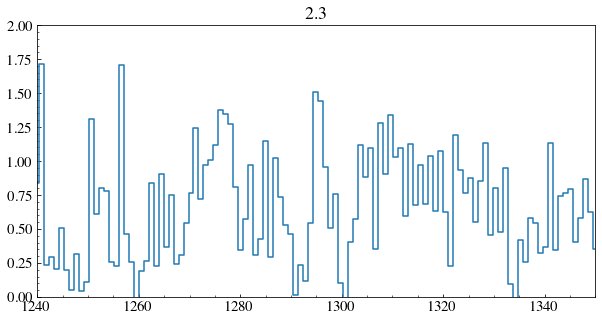

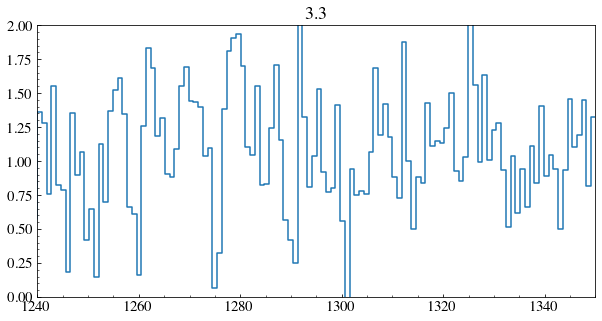

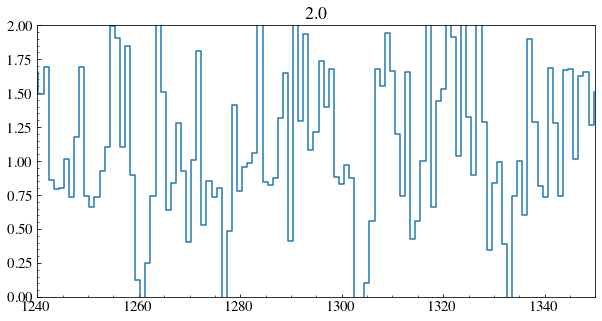

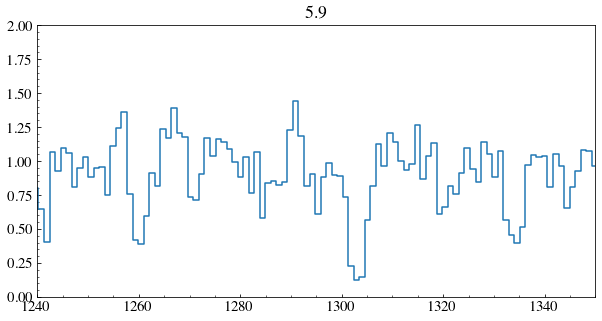

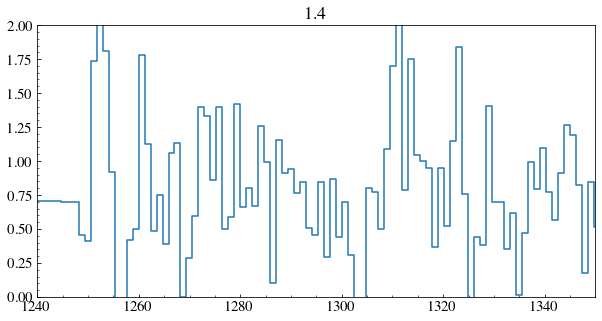

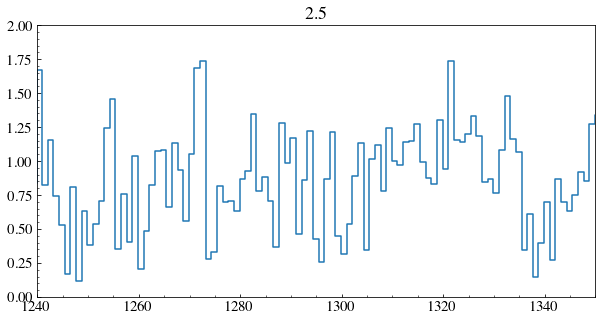

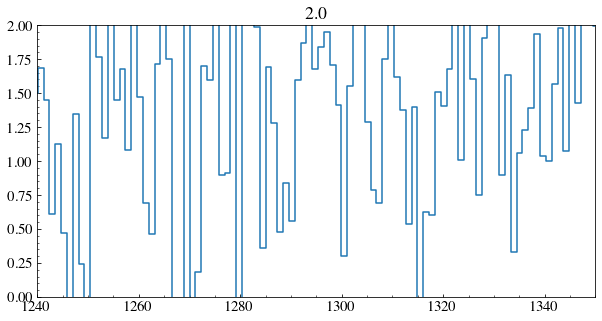

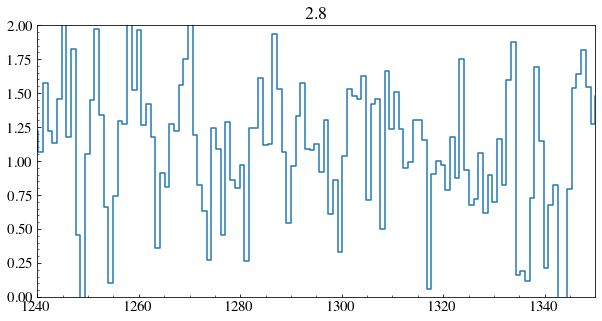

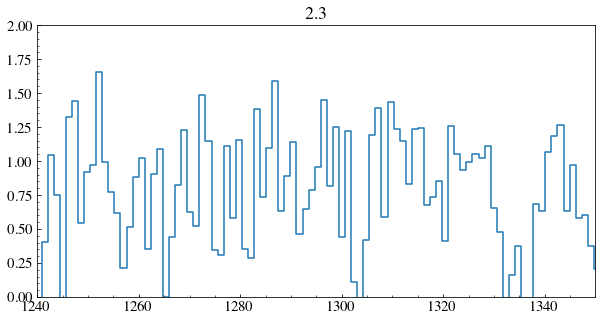

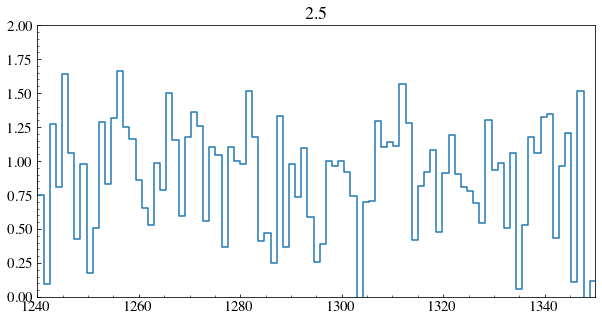

In [113]:
for i in range(10):
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
#     print(info['snr_per_pix'][i])
    wave_kcor = dat1['wl']/(1+redshift)
    flux_norm = dat1['flam']/np.median(dat1['flam'][(wave_kcor>1310) & (wave_kcor<1320)])
    plt.figure(figsize = (10,5))
    plt.plot(wave_kcor, flux_norm, drawstyle='steps-mid')
    plt.xlim(1240, 1350)
    plt.title(info['snr_per_pix'][i])
    plt.ylim(0,2)

### Selected SNR >5 data

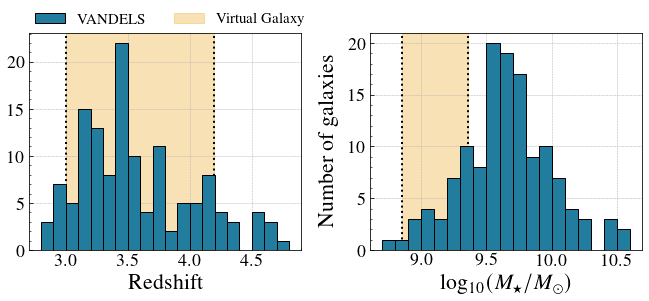

In [11]:
from matplotlib.legend_handler import HandlerPatch
import matplotlib.patches as mpatches
mask = (info['snr_per_pix']>=5) & (info['lmass']>7.5)
fig, (ax2, ax1) = plt.subplots(1,2, figsize = (11,4))

ax2.axvline(3, ls = ':', c= 'k', lw =2)
ax2.axvline(4.2, ls = ':',c='k', lw = 2)
ax2.hist(info['z'][mask],bins=np.arange(np.min(info['z'][mask]),np.max(info['z'][mask])+0.1,0.1),align='mid',  
         alpha = 1, label = 'VANDELS',
             edgecolor = 'k',color = '#227C9D', zorder =5)
cur_ylim = ax2.get_ylim()
ax2.fill_betweenx([0,cur_ylim[1]], x1 = 3, x2 =  4.2, color='#E99F0C', alpha = 0.3, label = 'Virtual Galaxy')
ax2.grid(linestyle = '--', linewidth = 0.5)
ax2.set_xlabel(r'Redshift', fontsize = 22)
ax2.tick_params(axis='both', which='major', labelsize=18)
ax2.set_ylim(0,cur_ylim[1])
ax1.set_ylabel(r'Number of galaxies', fontsize = 22, labelpad = 10)
ax2.legend(frameon = False, loc = (0,1), fontsize = 15, ncol = 2)
ahist = ax1.hist(info['lmass'][mask],
                 bins=np.arange(np.min(info['lmass'][mask]),np.max(info['lmass'][mask]),0.1),
                                align='mid',  alpha = 1,
             edgecolor = 'k',color = '#227C9D', zorder =5, lw = 1)
# print(np.min(np.log10(Mstar)),np.max(np.log10(Mstar)))
cur_ylim = ax1.get_ylim()
ax1.axvline(np.min(np.log10(Mstar)), ls = ':', c= 'k', lw =2)
ax1.axvline(np.max(np.log10(Mstar)), ls = ':',c='k', lw = 2)

ax1.fill_betweenx([0,cur_ylim[1]], x1 = np.min(np.log10(Mstar)), x2 = np.max(np.log10(Mstar)),
                  color='#E99F0C', alpha = 0.3)
ax1.set_xlabel(r'log$_{10}(M_\star/M_\odot)$', fontsize = 22)
ax1.set_ylabel(r'Number of galaxies', fontsize = 22, labelpad = 10)
ax1.set_ylim(0,cur_ylim[1])
# ax1.set_xlim(5.8,10.4)
ax1.tick_params(axis='both', which='major', labelsize=18)
# ax1.set_xticks([6,7,8,9,10])
ax1.grid(linestyle = '--', linewidth = 0.5)
plt.subplots_adjust(wspace=0.25)

fig.savefig('Plots/CompareGlobal.pdf', bbox_inches = 'tight')

In [25]:
print(len(info[info['snr_per_pix']>5]))
print(len(info[info['snr_per_pix']>0]))
print(offsiIIfluo1265)

131
965
1089.8343746972944


## Measuring properties

133


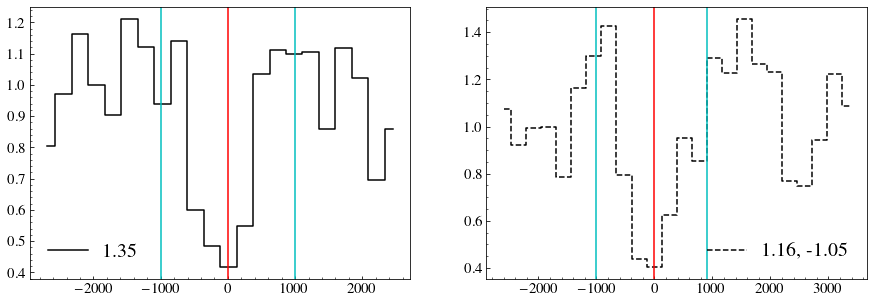

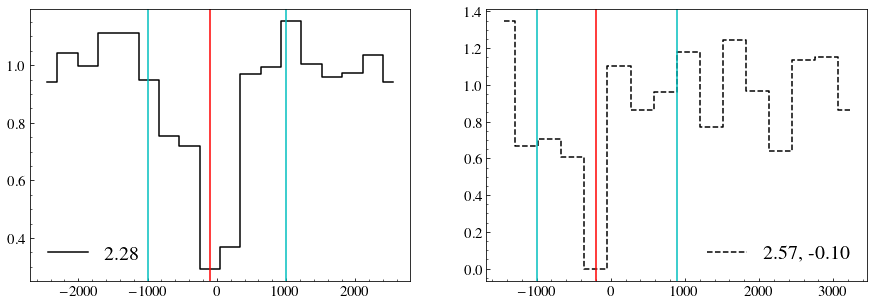

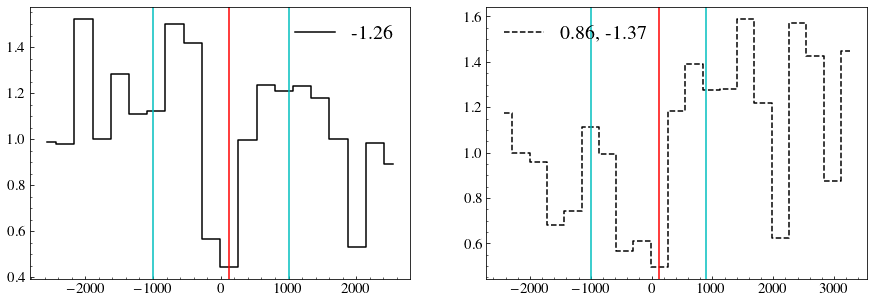

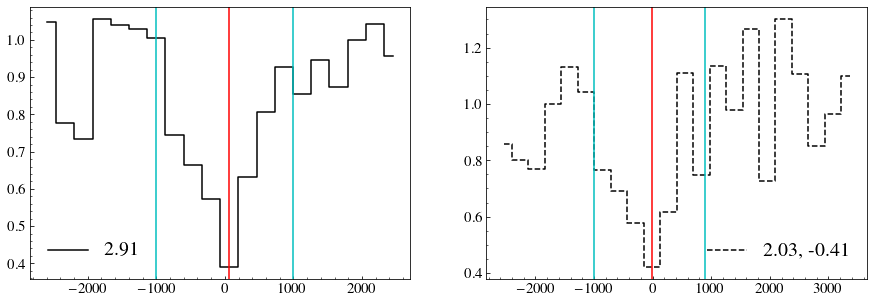

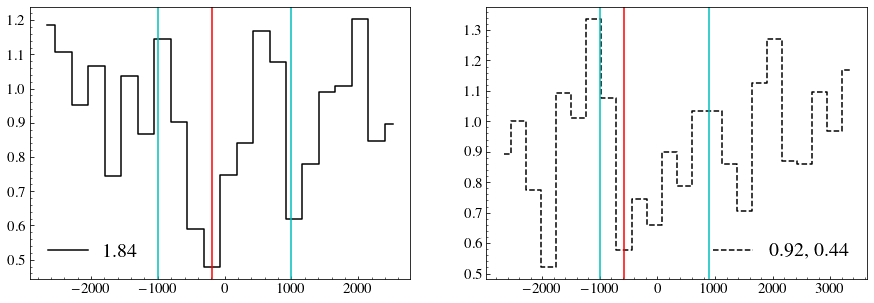

...

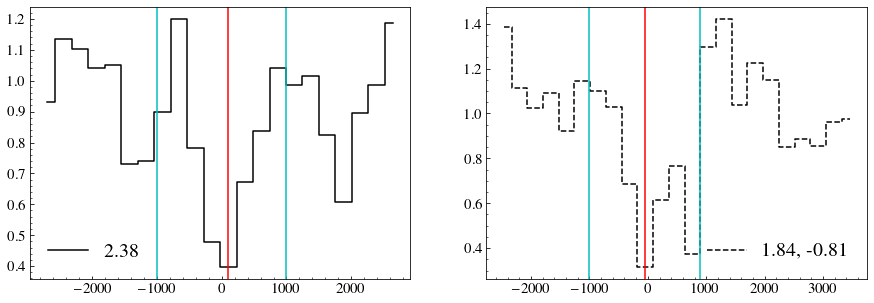

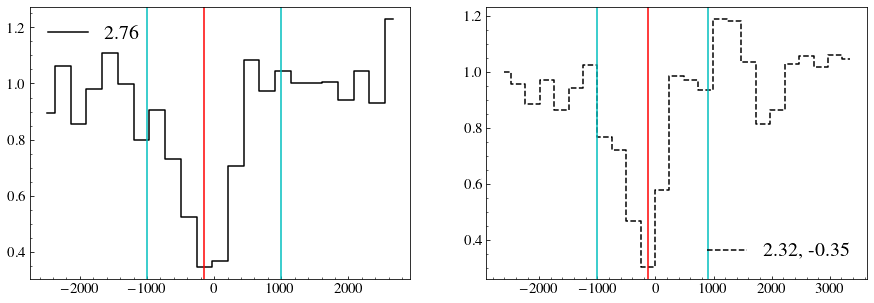

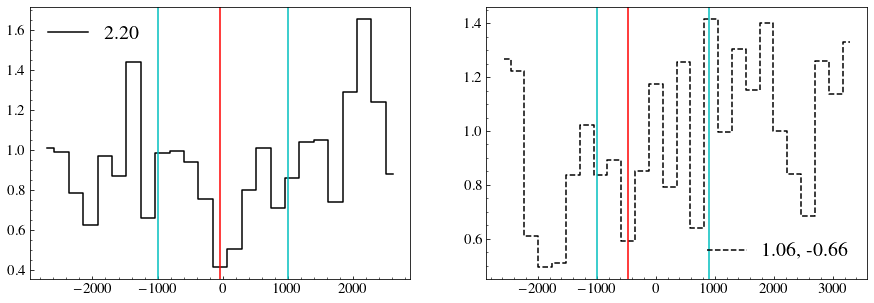

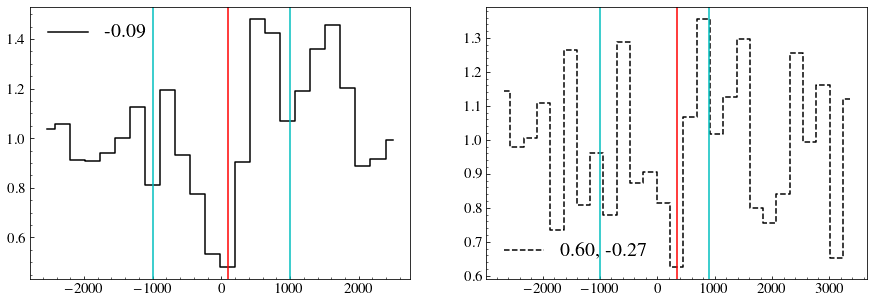

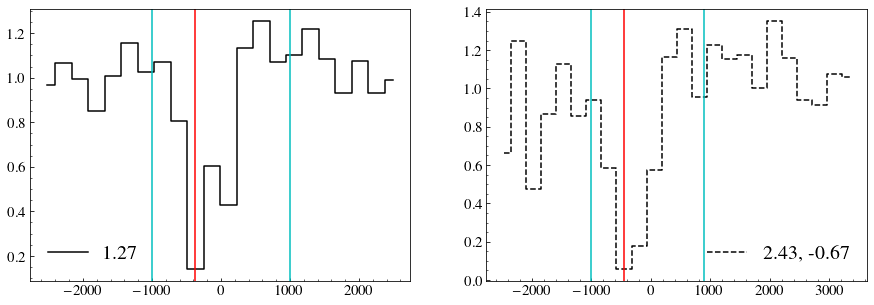

/tmp/ipykernel_6984/3203491465.py:51: RuntimeWarning: invalid value encountered in true_divide
  fsiII /= fmedSiII


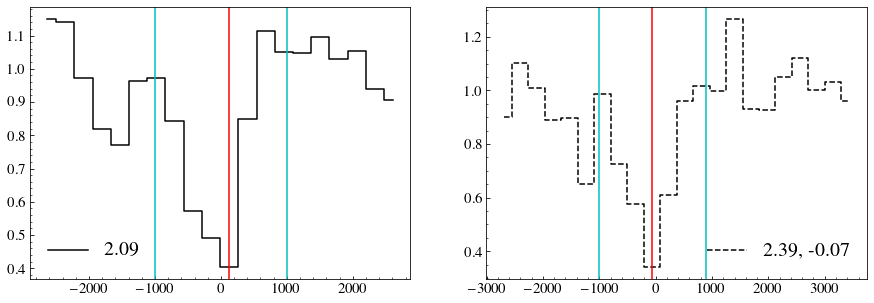

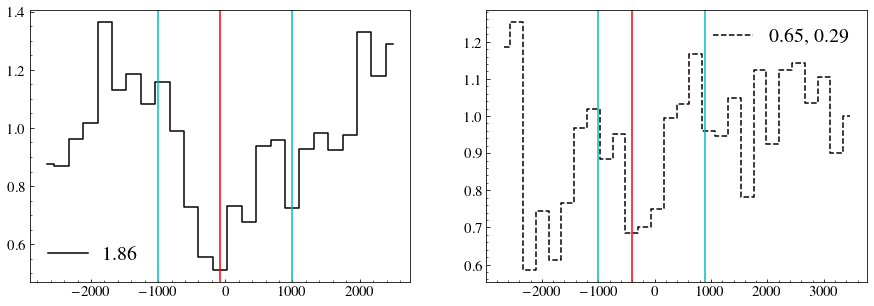

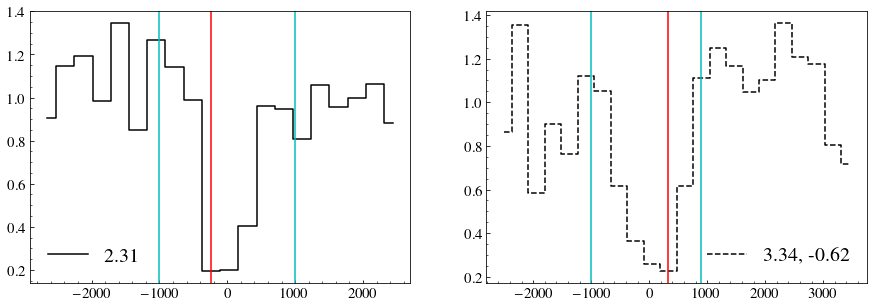

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/fromnumeric.py:3419: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:188: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


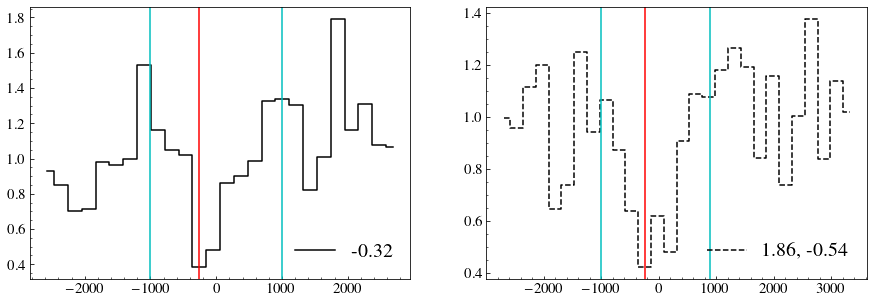

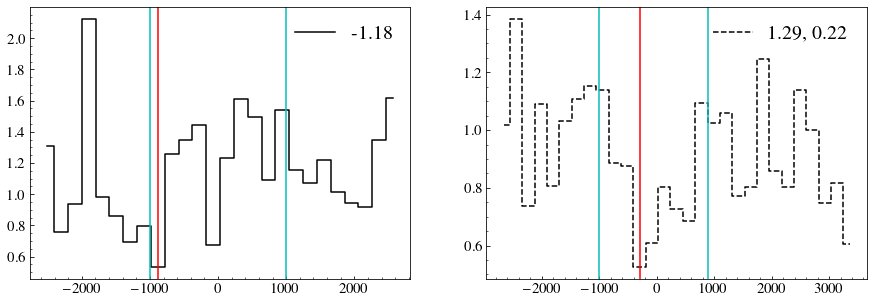

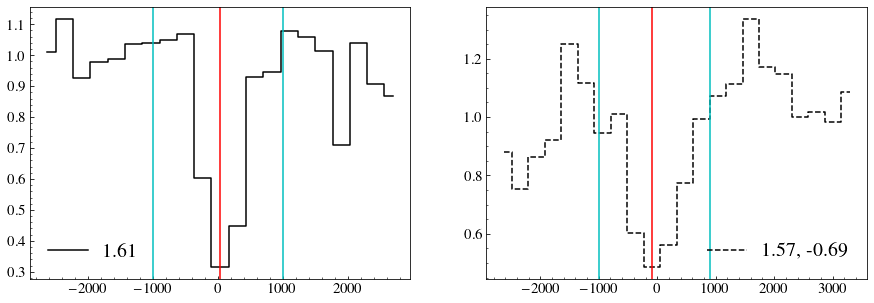

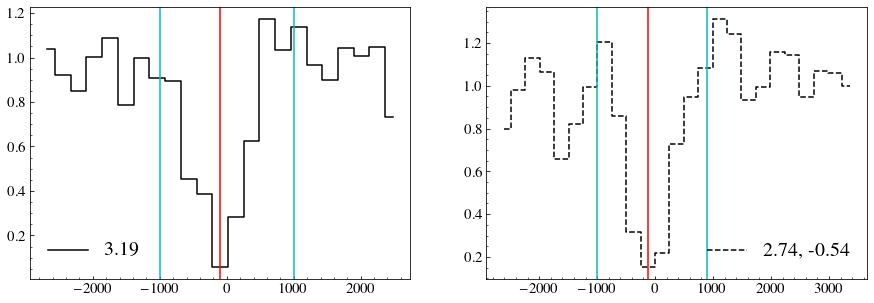

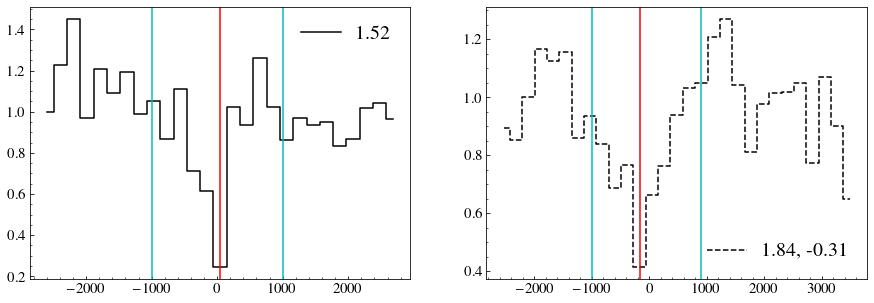

...

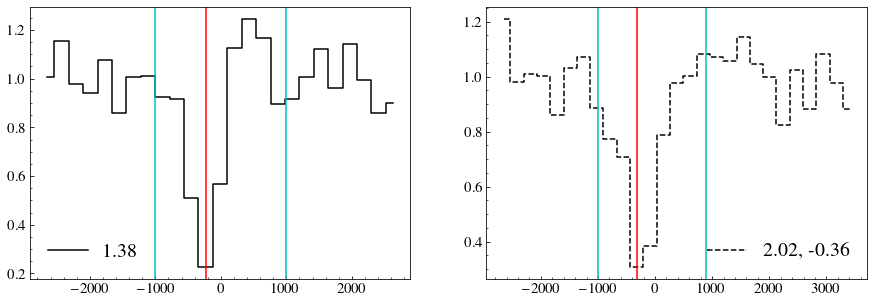

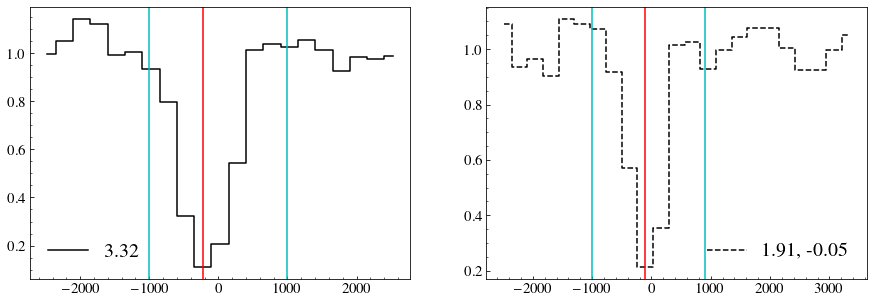

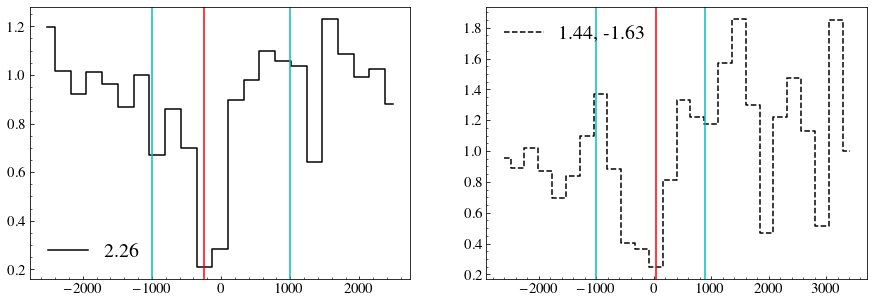

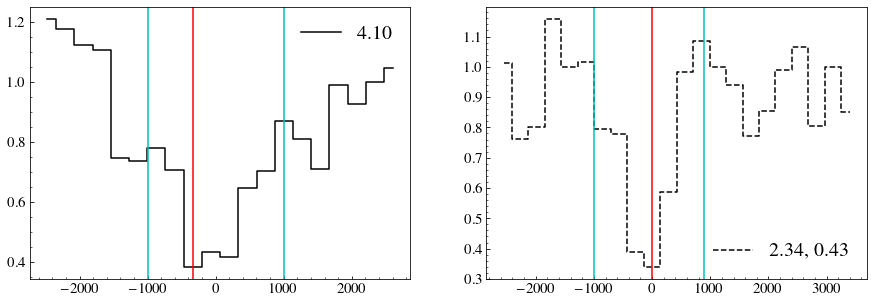

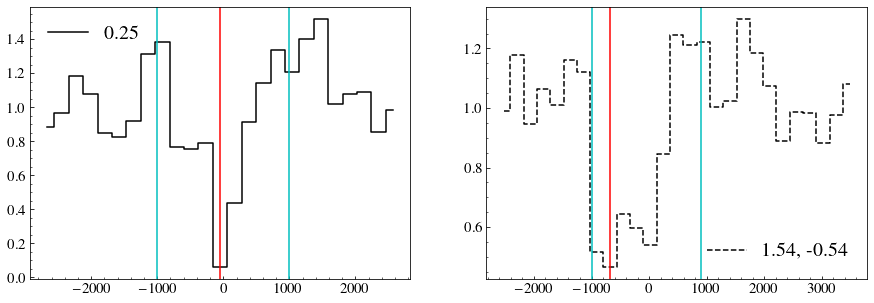

In [122]:


nGal =len(info[(info['snr_per_pix']>=5) & (info['lmass']>7.5)])
print(nGal)

EWSiabs = np.zeros((nGal,2)) 
EWSiabs[EWSiabs == 0] = np.nan
EWSiemi = np.zeros((nGal,2)) 
EWSiemi[EWSiemi == 0] = np.nan
# print(EWSiabs)

EWCall = np.zeros((nGal,2))
EWCall[EWCall == 0] = np.nan

VSi = np.zeros((nGal,2))
VSi[VSi == 0] = np.nan

VC = np.zeros((nGal,2))
VC[VC == 0] = np.nan

true_i = 0
for i in range(len(info)):    
    if(info['snr_per_pix'][i]<5 or info['lmass'][i]<7.5):
        continue
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])

    redshift = info["z"][i]
    wave     = dat1['wl'].values/(1+redshift)
    err      =  dat1['flam_err'].values/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux     = dat1['flam'].values/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=0
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

    cutCIIall = (vcIId>-2700) & (vcIId<2700) 
    cutSiIIall = (vsiIId>-2700) & (vsiIId<3500)  
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]  
    
    rmedCII = ((vcII<-1200) | (vcII>1200))
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-1000) |  (vsiII > 2000) )
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII  
    

    if(~np.isnan(np.median(fcII[((vcII<500) & (vcII>-500))])) and np.median(fcII[((vcII<500) & (vcII>-500))]) > 0.01):
#         print(np.median(fcII[((vcII<500) & (vcII>-500))]))
        try:
            EWCall[true_i][0], EWCall[true_i][1] = measureEW(wave[cutCIIall], vcII, fcII.copy(),
                                                (ecII.copy()/fmedCII), -1500, 1500)

            VC[true_i][0], VC[true_i][1] = measureMinVel(vcII, fcII.copy(), 
                                                                   (ecII.copy()/fmedCII), -1500, 1500)

        except:
            print('nocare', true_i,  info["spectrum"][i])
            
    if(~np.isnan(np.median(fsiII[((vsiII<500) &  (vsiII > -500) )])) and \
       (np.median(fsiII[((vsiII<500) & (vsiII>-500))]) > 0.01)):
#         print(np.median(fsiII[((vsiII<500) &  (vsiII > -500) )]))

        try:
            EWSiabs[true_i][0], EWSiabs[true_i][1] = measureEW(wave[cutSiIIall], vsiII, fsiII.copy(),
                                                  (esiII.copy()/fmedSiII),    -1500, 1000)
            EWSiemi[true_i][0], EWSiemi[true_i][1] = measureEW(wave[cutSiIIall], vsiII, fsiII.copy(),
                                                  (esiII.copy()/fmedSiII),    800, 2000)
            VSi[true_i][0], VSi[true_i][1], = measureMinVel(vsiII, fsiII.copy(),
                                                                      (esiII.copy()/fmedSiII), -1500, 1000)
    #         axs[1].axvline(VSi[i][0], c= 'r')
    #         axs[1].axhline(FSi[i][0], c= 'r')
    #         print(EWSi[i][0],EWSi[i][1])

    #         print(VSi[i][0],VSi[i][1])
    #         print(FSi[i][0],FSi[i][1])
        except:
            print('nocare', true_i, info["spectrum"][i] )

    if(true_i % 2 == 0):
        fig, (ax1, ax2) = plt.subplots(1,2,figsize=(15,5))

        ax1.plot(vcII, fcII,  c='k', drawstyle = 'steps-mid',
                 label = f'{EWCall[true_i][0]:.2f}')
        ax1.axvline(VC[true_i][0], c= 'r')
        ax1.axvline(-1000, c= 'c')
        ax1.axvline(1000, c= 'c')
        ax1.legend(ncol = 2, fontsize = 20, frameon = False)

        ax2.plot(vsiII, fsiII,   c = 'k', linestyle = '--', label = f'{EWSiabs[true_i][0]:.2f}, {EWSiemi[true_i][0]: .2f}', drawstyle = 'steps-mid' )
        ax2.axvline(VSi[true_i][0], c= 'r')
        ax2.axvline(-1000, c= 'c')
        ax2.axvline(900, c= 'c')
#         ax2.set_xlim(-1500,1500)
        ax2.legend(ncol = 2, fontsize = 20, frameon = False)
        plt.show()
    true_i+=1


In [124]:
df = pd.DataFrame(np.vstack((info["spectrum"][(info['snr_per_pix']>=5) & (info['lmass']>7.5)],
                             EWCall[:,0],EWCall[:,1], EWSiabs[:,0],EWSiabs[:,1], EWSiemi[:,0],EWSiemi[:,1], 
                   VC[:,0],VC[:,1], VSi[:,0],VSi[:,1])).T) # A is a numpy 2d array
C=['Galaxy','EWCII','ErrEWCII', 'EWSiIIabs', 'ErrEWSiIIabs',  'EWSiIIemi', 'ErrEWSiIIemi', 
   'VminCII', 'ErrVminCII', 'VminSiII', 'ErrVminSiII',]
df.to_csv("csv/VANDELS_CII_SiII_meas.csv", sep=',', header= C, index=False) # C is a list of string corresponding to the title of each column of A

### RHD simu properties

IntProgress(value=0, max=75)

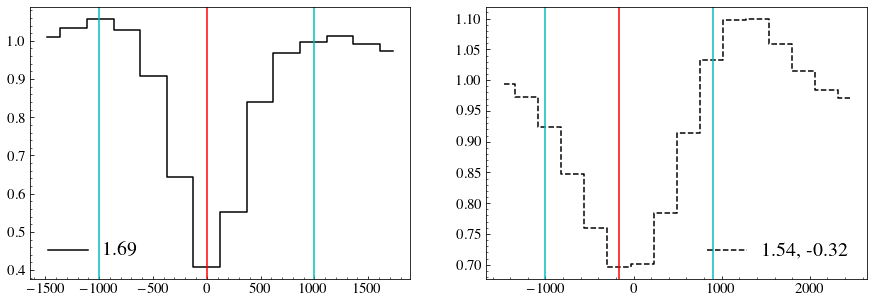

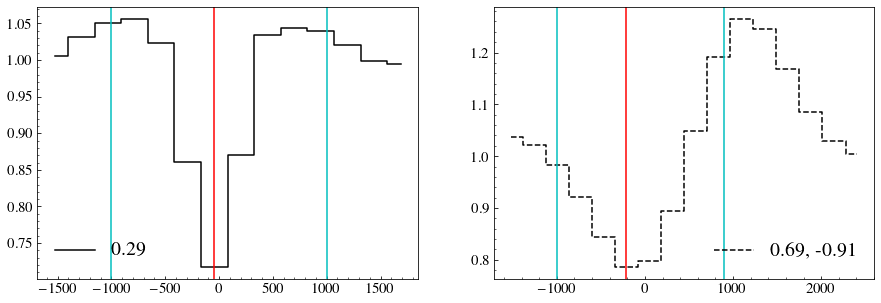

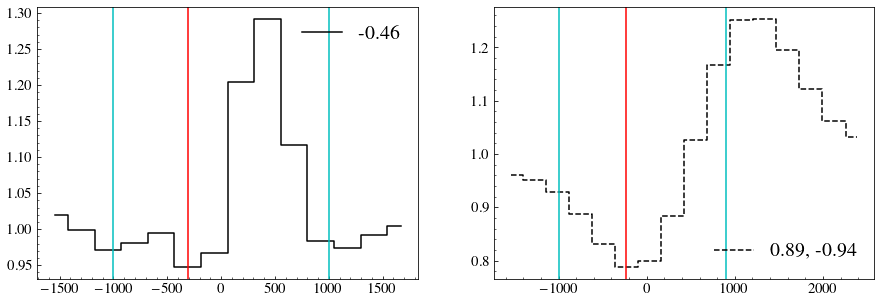

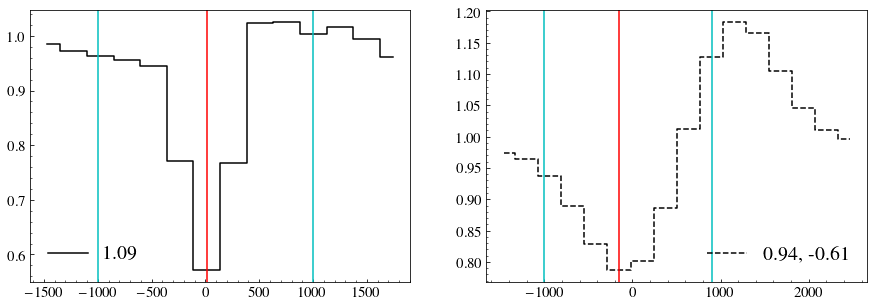

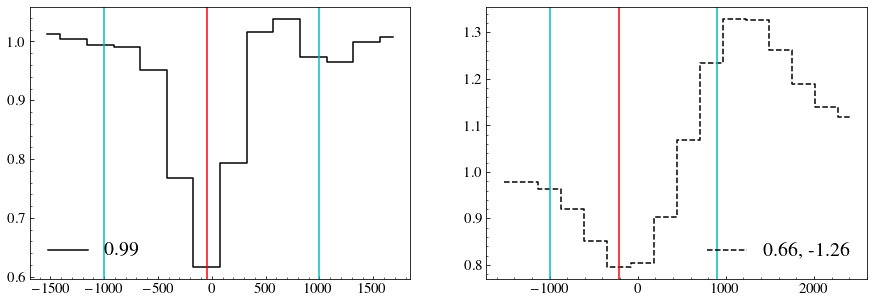

...

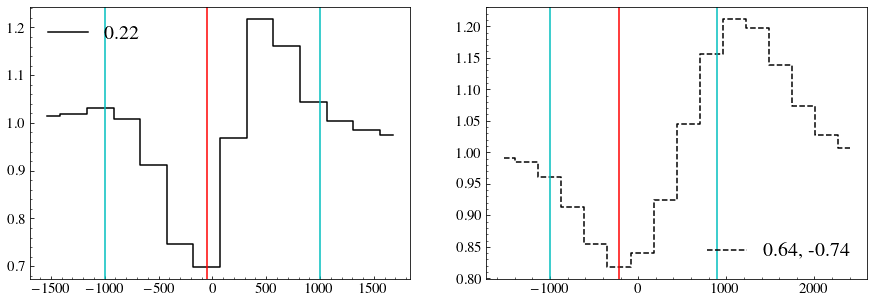

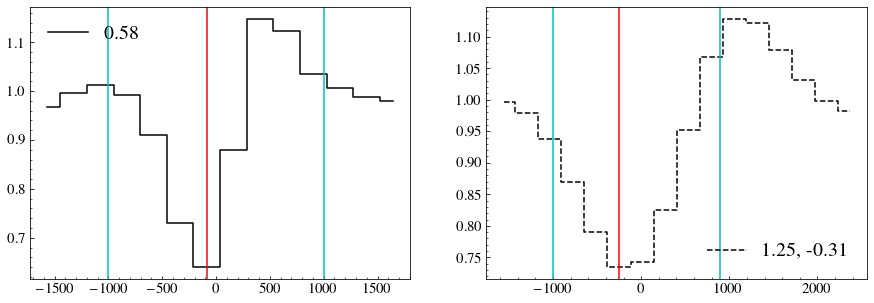

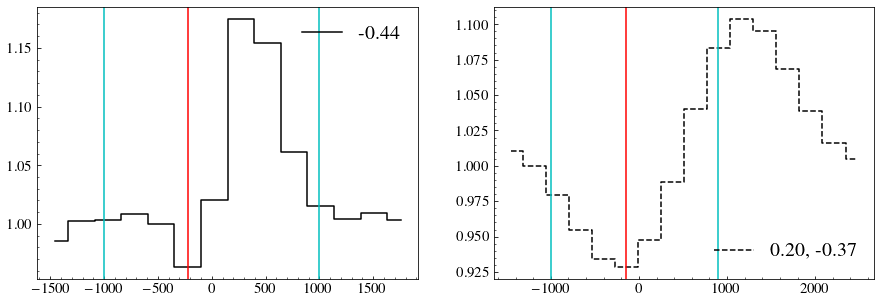

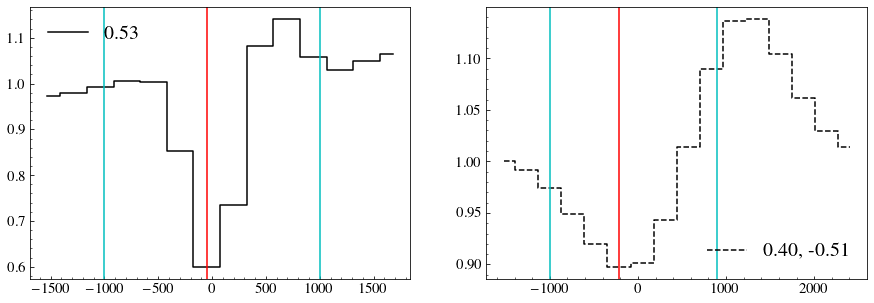

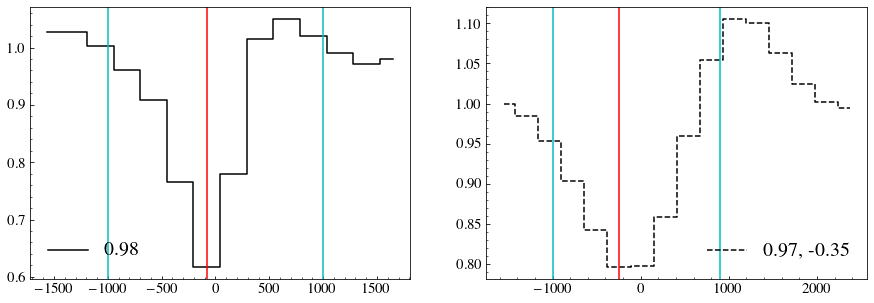

In [74]:
path_to_data = path_to_folder+'/CII_SiII_depletion/'   # To change if you move the data

nout = 75
ndir = 300 

EWCII_sim = np.zeros((nout,ndir))
VCII_sim = np.zeros((nout,ndir))

EWSiIIabs_sim = np.zeros((nout,ndir))
EWSiIIemi_sim = np.zeros((nout,ndir))
VSiII_sim = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

v_cm = np.genfromtxt(path_to_folder+'./dat_files/vcm_90_164.dat',unpack=True)

for output in range(90,165,1):
    f.value += 1# output = 142
    l_c, flux_c = read_spectrum_c(path_to_data,output )
    l_si, flux_si = read_spectrum_si(path_to_data,output )
    
    vGal = v_cm[:,output-90]

    for idir in range(300):
        l_sys_c = l_c + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_c)
        l_sys_c =l_sys_c[1:]
        l_big_c = np.arange(np.min(l_sys_c), np.max(l_sys_c), 2.2/2 )
        
        vcII   = (l_big_c/1334.532 -1)*c
        sigma_pixel = rkms_vandels /2.355/ ((vcII[1]-vcII[0]))
        rmedCII = ((vcII<-1000) | (vcII>1000))
        fluxdir = flux_c[idir,1:]
        fluxdir = np.interp(l_big_c, l_sys_c, fluxdir)
        fluxdir /= np.nanmedian(fluxdir[rmedCII])

        model = gaussian_filter(fluxdir, sigma = sigma_pixel, mode = 'constant', cval = 1)
        modelCII = model.copy()
        EWCII_sim[output-90, idir], oo = measureEW(l_big_c, vcII, model.copy(), np.zeros(len(fluxdir)),
                                                     -1500, 1500)

        VCII_sim[output-90,idir], oo, = measureMinVel(vcII, model.copy(), 
                                                                             np.zeros(len(fluxdir)), -1500, 1500)

        
        
        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]
        l_big_si = np.arange(np.min(l_sys_si), np.max(l_sys_si), 2.2/2 )

        vsiII   = (l_big_si/1260.42 -1)*c
        sigma_pixel = rkms_vandels / ((vsiII[1]-vsiII[0]))
        rmedSiII = ((vsiII<-1000) |  (vsiII > 1800) )

        fluxdir = flux_si[idir,1:]
        fluxdir = np.interp(l_big_si, l_sys_si, fluxdir)

        fluxdir/= np.nanmedian(fluxdir[rmedSiII])
        model = gaussian_filter(fluxdir, sigma = sigma_pixel)
#         model = model/np.nanmedian(model[rmedSiII])
        

        EWSiIIabs_sim[output-90,idir], oo = measureEW(l_big_si, vsiII, model.copy(), np.zeros(len(model)), 
                                                     -1500, 1000)
        EWSiIIemi_sim[output-90,idir], oo = measureEW(l_big_si, vsiII, model.copy(),   np.zeros(len(model)),
                                                     800, 2000)

        VSiII_sim[output-90,idir], oo,  = measureMinVel(vsiII, model.copy(),np.zeros(len(model)),
                                                       -1500, 800)

        if(idir % 200 == 0):
            fig, (ax1, ax2) = plt.subplots(1,2,figsize=(15,5))

            ax1.plot(vcII, modelCII,  c='k', drawstyle = 'steps-mid',
                     label = f'{ EWCII_sim[output-90, idir]:.2f}')
            ax1.axvline(VCII_sim[output-90,idir], c= 'r')
            ax1.axvline(-1000, c= 'c')
            ax1.axvline(1000, c= 'c')
            ax1.legend(ncol = 2, fontsize = 20, frameon = False)

            ax2.plot(vsiII, model,   c = 'k', linestyle = '--', 
                     label = f'{EWSiIIabs_sim[output-90,idir]: .2f}, {EWSiIIemi_sim[output-90,idir]: .2f}'    , 
                     drawstyle = 'steps-mid' )
            ax2.axvline(VSiII_sim[output-90,idir], c= 'r')
            ax2.axvline(-1000, c= 'c')
            ax2.axvline(900, c= 'c')

            ax2.legend(ncol = 2, fontsize = 20, frameon = False)
            plt.show()

In [53]:
print(sigma_pixel)

51.71097247190807


#### Saving

In [76]:
for i in range(75):
    df = pd.DataFrame(np.vstack((np.linspace(0,299,300),  
                                 EWCII_sim[i,:], VCII_sim[i,:], 
                                 EWSiIIabs_sim[i,:], EWSiIIemi_sim[i,:], 
                                 VSiII_sim[i,:])).T) # A is a numpy 2d array
    C=['dir', 'EWCII', 'VminCII', 'EWSiIIabs', 'EWSiIIemi', 
       'VSiII']
    df.to_csv("csv/RHD_Mes_%d_300.csv"%(i+90), sep=',', header= C, index=False) 
    


### Meaure luminosity

In [506]:
path_to_data = path_to_folder+'/CII_SiII_depletion/'   # To change if you move the data

nout = 75
ndir = 300 

Lumi_sim = np.zeros((nout,ndir))

f = IntProgress(min=0, max=nout) # instantiate the bar
display(f) # display the bar

v_cm = np.genfromtxt(path_to_folder+'./dat_files/vcm_90_164.dat',unpack=True)

for output in range(90,165,1):
    f.value += 1# output = 142
    l_c, flux_c = read_spectrum_c(path_to_data,output )
    l_si, flux_si = read_spectrum_si(path_to_data,output )
    
    vGal = v_cm[:,output-90]

    for idir in range(300):

        l_sys_si = l_si + np.dot(directions[idir,:],vGal)/c_cgs*1e5*np.mean(l_si) 
        l_sys_si =l_sys_si[1:]
        l_big_si = np.arange(np.min(l_sys_si), np.max(l_sys_si), 2.2/2 )
        fluxdir = flux_si[idir,1:]

        vsiII   = (l_sys_si/1260.42 -1)*c
        Lumi_sim[output-90, idir] = np.median(fluxdir[vsiII<-1000])
#         model = model/np.nanmedian(model[rmedSiII])
        


IntProgress(value=0, max=75)

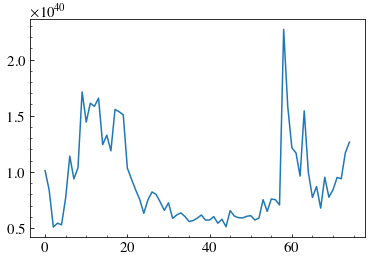

In [509]:
plt.plot(np.median(Lumi_sim, axis = 1))

### Showing global measurements

/tmp/ipykernel_6984/2976485379.py:113: UserWarning: No contour levels were found within the data range.
  CS=ax_main.contour(counts.transpose(),extent=[xbins.min(),xbins.max(),


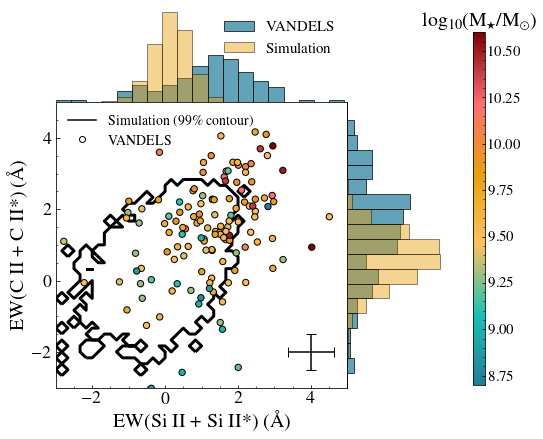

In [221]:
# cb_colors = ["#FFC15E", "#F7B05B", "#F7934C", "#CC5803", "#1F1300"]
cb_colors = ["#227C9D", "#17C3B2", "#FFC05C", "#E99F0C", "#FE6D73", "#800000"]

num_colors = len(cb_colors)
cmap = LinearSegmentedColormap.from_list('test',cb_colors)

mstarAll = np.zeros((75,300))
RHDCIIAll = np.zeros((75,300))
RHDSiIIAll = np.zeros((75,300))
RHDVCIIAll = np.zeros((75,300))
RHDVSiIIAll = np.zeros((75,300))

for i in range(75):
    mstarAll[i,:] += np.log10(Mstar[i])
    RHDCIIAll[i,:] = RHDmeas[i]['EWCII']
    RHDSiIIAll[i,:] = RHDmeas[i]['EWSiIIabs']+RHDmeas[i]['EWSiIIemi']

    RHDVCIIAll[i,:] = RHDmeas[i]['VminCII']
    RHDVSiIIAll[i,:] = RHDmeas[i]['VSiII']
    
    
vmin = np.min(info['lmass'][mask])
vmax = np.max(info['lmass'][mask])


fig = plt.figure(figsize=(8,7))
gs = GridSpec(8, 8)
ax_main = plt.subplot(gs[2:8, :6])
ax_xDist = plt.subplot(gs[0:2, :6],sharex=ax_main)
ax_yDist = plt.subplot(gs[2:8, 6:8],sharey=ax_main)

# ax_main.errorbar(VANDELSmeas['EWSiIIabs']+VANDELSmeas['EWSiIIemi'], VANDELSmeas['EWCII'], 
#                 xerr = np.sqrt(VANDELSmeas['ErrEWSiIIabs']**2+VANDELSmeas['ErrEWSiIIemi']**2),
#                  yerr = VANDELSmeas['ErrEWCII'],
#                 label = 'VANDELS', linestyle = 'None', marker = 's',c='k')

ax_main.scatter(VANDELSmeas['EWSiIIabs']+VANDELSmeas['EWSiIIemi'], VANDELSmeas['EWCII'],  c = info['lmass'][mask],
                marker = 'o', s = 40, zorder = 5, cmap = cmap,  vmin = vmin, vmax = vmax, edgecolor = 'k')
ax_main.errorbar(4, -2, 
                xerr = np.nanmedian(np.sqrt(VANDELSmeas['ErrEWSiIIabs']**2+VANDELSmeas['ErrEWSiIIemi']**2)),
                 yerr = np.nanmedian(VANDELSmeas['ErrEWCII']),
                label = 'VANDELS', linestyle = '--', marker = 'None',c='k', capsize=5)


# ax_main.errorbar(RHDSiIIAll.flatten(), RHDCIIAll.flatten(), 
#                 xerr = RHDSiIIErrAll.flatten(), yerr = RHDCIIAll.flatten(),
#                 label = 'VANDELS', linestyle = 'None', marker = 's',c='k', markeredgecolor = 'k')

# ax_main.scatter(RHDSiIIAll.flatten(), RHDCIIAll.flatten(),  c = info['lmass'][mask],
#                 marker = 's', s = 20, zorder = 5, cmap = cmap, edgecolor = 'k', vmin = vmin, vmax = vmax)


# ax_main.set(xlabel="x data", ylabel="y data")

# cm = ax_main.scatter( np.flip(RHDSiIIAll.flatten()[:]), np.flip(RHDCIIAll.flatten()[:]), zorder = 0, marker = '+', 
#                   c =  np.flip(mstarAll.flatten()[:]), cmap = cmap, s = 0.5, vmin = vmin, vmax = vmax, label = 'Simulation')

ax_xDist.hist(VANDELSmeas['EWSiIIabs']+VANDELSmeas['EWSiIIemi'],bins=np.linspace(-3,7,25),
              align='mid', density=True, alpha = 0.7, label = 'VANDELS',
             edgecolor = 'k',color = '#227C9D', )
ax_xDist.hist(np.flip(RHDSiIIAll.flatten()[:]),bins=np.linspace(-3,7,25),align='mid', density=True, alpha = 0.45, 
              label = 'Simulation', edgecolor = 'k', color = '#E99F0C',)
ax_xDist.axis(False)
ax_xDist.legend(frameon = False)

ax_yDist.hist(VANDELSmeas['EWCII'],bins=np.linspace(-3,7,25),orientation='horizontal',align='mid', 
              density=True, alpha = 0.7, 
              edgecolor = 'k',color = '#227C9D')

ax_yDist.hist(np.flip(RHDCIIAll.flatten()[:]),bins=np.linspace(-3,7,25),orientation='horizontal',align='mid', density=True,
              alpha =0.45,              edgecolor = 'k', color = '#E99F0C')

ax_yDist.axis(False)
ax_main.set_xlabel(r'EW(Si II + Si II*) ($\rm \AA$)', fontsize = 20)
ax_main.set_ylabel(r'EW(C II + C II*) ($\rm \AA$)', fontsize = 20)
ax_main.set_xlim(-3,5)
ax_main.set_ylim(-3,5)

line0 = Line2D([0], [0], label='Simulation', marker='None', linestyle='-', color='k')    
line1 = Line2D([], [], label='Simulation (99\% contour)', marker='+', linestyle='None', color='w',markeredgecolor = 'k')    
line3 = Line2D([], [], label='CLASSY ', marker='o', linestyle='None', color='w',markeredgecolor = 'k')
labels = [r'Simulation (99\% contour)', 'VANDELS']
ll = ax_main.legend([line0,line3,], labels,frameon = False, fontsize = 14, loc = 'upper left')
# ll.legendHandles[1]._sizes = [60,60,60,60]
ax_main.tick_params(axis='both', which='major', labelsize=18)
# ax_main.set_yticks([0,1,2,3,4])

plt.subplots_adjust(wspace=0, hspace=0)
plt.setp(ax_xDist.get_xticklabels(), visible=False)
plt.setp(ax_xDist.get_yticklabels(), visible=False)
plt.setp(ax_yDist.get_xticklabels(), visible=False)
plt.setp(ax_yDist.get_yticklabels(), visible=False)


def grid(x, y, z, resX=100, resY=100):
    "Convert 3 column data to matplotlib grid"
    xi = linspace(min(x), max(x), resX)
    yi = linspace(min(y), max(y), resY)
    Z = griddata(x, y, z, xi, yi)
    X, Y = meshgrid(xi, yi)
    return X, Y, Z

# X, Y, Z = grid(np.flip(RHDSiIIAll.flatten()[:]), np.flip(RHDCIIAll.flatten()[:]), z)
counts,xbins,ybins=np.histogram2d(np.flip(RHDSiIIAll.flatten()[:]), np.flip(RHDCIIAll.flatten()[:]),
                                  bins=[np.linspace(-3,5,50), np.linspace(-3,5,50)])
counts = (counts - counts.min())/(counts.max() - counts.min())
from scipy import ndimage

# resample your data grid by a factor of 4 using cubic spline interpolation
pw = 4
# counts = ndimage.zoom(counts, pw)

CS=ax_main.contour(counts.transpose(),extent=[xbins.min(),xbins.max(),
    ybins.min(),ybins.max()],colors='k',levels = [0,  1], linewidths=[3,3])
# ax_main.clabel(CS, fmt='%1.2f', colors='k', fontsize=8, inline=True, inline_spacing=0)



# ax_main = plt.subplot(gs[2:8, 20:26])
# ax_xDist = plt.subplot(gs[0:2, 20:26],sharex=ax_main)
# ax_yDist = plt.subplot(gs[2:8, 26:28],sharey=ax_main)


# # ax_main.errorbar(VANDELSmeas['VminSiII'], VANDELSmeas['VminCII'],
# #                 xerr = VANDELSmeas['ErrVminSiII'], yerr = VANDELSmeas['ErrVminCII'],
# #                  linestyle = 'None', marker = 'o',c='k', markeredgecolor = 'k')
# ax_main.scatter(VANDELSmeas['VminSiII'], VANDELSmeas['VminCII'],  c = info['lmass'][mask],
#                 marker = 's', s = 40, zorder = 5, cmap = cmap,  vmin = vmin, vmax = vmax, edgecolor = 'k')

# cm = ax_main.scatter( np.flip(RHDVSiIIAll.flatten()[:]), np.flip(RHDVCIIAll.flatten()[:]), zorder = 0, marker = '+', 
#                   c =  np.flip(mstarAll.flatten()[:]), cmap = cmap, s = 0.5, vmin = vmin, vmax = vmax)
    
# ax_main.plot(np.linspace(-600,200),np.linspace(-600,200), linestyle = '--', c = 'k')

# ax_main.set_xlabel(r'$v_{\rm min}$(Si II) ($\rm km\ s^{-1}$)', fontsize = 20)
# ax_main.set_ylabel(r'$v_{\rm min}$(C II) ($\rm km\ s^{-1}$)', fontsize = 20)


# ax_xDist.hist(VANDELSmeas['VminSiII'],bins=np.linspace(-600,150,20),align='mid', density=True, alpha = 0.3, label = 'CLASSY',
#              edgecolor = '#17C3B2',color = '#17C3B2')
# ax_xDist.hist(np.flip(RHDVSiIIAll.flatten()[:]),bins=np.linspace(-600,150,20),align='mid', density=True, 
#                 alpha =0.5,              edgecolor = 'k', color = '#ECEBE4')
# # ax_xDist.legend(frameon 
# # = False)
# ax_xDist.axis(False)


# ax_yDist.hist( VANDELSmeas['VminCII'],bins=np.linspace(-600,150,20),orientation='horizontal',align='mid', density=True, alpha = 0.3, 
#                edgecolor = '#17C3B2',color = '#17C3B2')
# ax_yDist.hist(np.flip(RHDVCIIAll.flatten()[:]),bins=np.linspace(-600,150,20),orientation='horizontal',align='mid', density=True, 
#                 alpha =0.5,              edgecolor = 'k', color = '#ECEBE4')

# ax_yDist.axis(False)

# ax_main.set_xlim(-600,350)
# ax_main.set_ylim(-600,350)
# # plt.subplots_adjust(wspace=0, hspace=0)
# plt.setp(ax_xDist.get_xticklabels(), visible=False)
# plt.setp(ax_xDist.get_yticklabels(), visible=False)
# plt.setp(ax_yDist.get_xticklabels(), visible=False)
# plt.setp(ax_yDist.get_yticklabels(), visible=False)


# # ax_yDist
fig.subplots_adjust(right=0.8)
cbar_ax = fig.add_axes([0.85, 0.13, 0.02, 0.7])
cbar = fig.colorbar(cm, cax=cbar_ax, orientation='vertical')
cbar.ax.set_title(r'log$_{10}$(M$_{\star}$/M$_\odot$)', fontsize = 20)

plt.savefig('Plots/EWProp.pdf', bbox_inches = 'tight', dpi = 300)

# # plt.show()

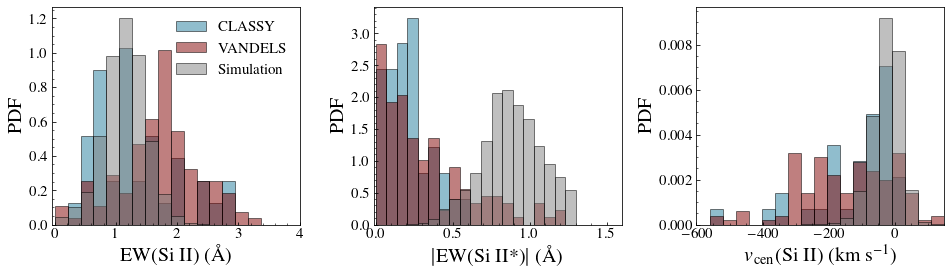

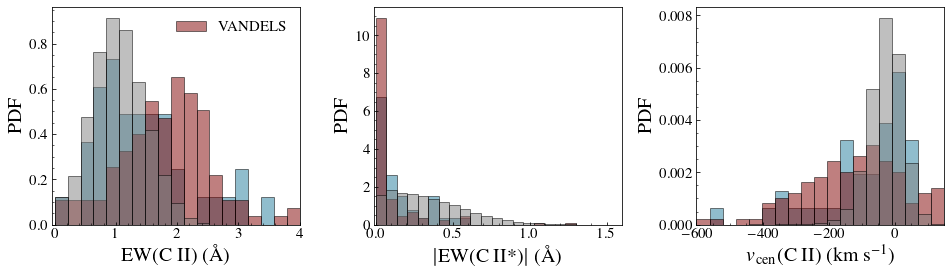

In [460]:
# cb_colors = ["#FFC15E", "#F7B05B", "#F7934C", "#CC5803", "#1F1300"]
cb_colors = ["#227C9D", "#17C3B2", "#FFC05C", "#E99F0C", "#FE6D73", "#800000"]
alpha = 0.5
num_colors = len(cb_colors)
cmap = LinearSegmentedColormap.from_list('test',cb_colors)

fig, axs = plt.subplots(1,3,figsize=(16,4))

axs[0].hist(-ClassAbs['EWSiII'],bins=np.linspace(0,4,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
             edgecolor = 'k',color = '#227C9D', )
axs[0].hist(-VANDELSAbs['EWSiII'],bins=np.linspace(0,4,20),align='mid', density=True, alpha = alpha, label = 'VANDELS',
             edgecolor = 'k',color = '#800000', )
axs[0].hist(-np.flip(EWabsSiIIdep.flatten()[:]),bins=np.linspace(0,4,20),align='mid', density=True, alpha = 0.5, 
              label = 'Simulation', edgecolor = 'k', color = 'gray',)
axs[0].set_xlabel(r'EW(Si II) ($\rm \AA$)', fontsize = 20)
axs[0].set_xlim(-0.05,4)
axs[0].set_ylabel(r'PDF', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)


axs[1].hist(ClassFluo['EWFluoSiII'],bins=np.linspace(0,1.3,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
             edgecolor = 'k',color = '#227C9D', )
axs[1].hist(VANDELSFluo['EWFluoSiII'],bins=np.linspace(0,1.3,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
             edgecolor = 'k',color = '#800000', )
axs[1].hist(np.flip(EWemiSiIIdep.flatten()[:]),bins=np.linspace(0,1.3,20),align='mid', density=True, alpha = 0.5, 
              label = 'Simulation', edgecolor = 'k', color = 'gray',)
axs[1].set_xlabel(r'$|$EW(Si II*)$|$ ($\rm \AA$)', fontsize = 20)
axs[1].set_xlim(-0.01,1.6)
axs[1].set_ylabel(r'PDF', fontsize = 20)


axs[2].hist(ClassAbs['VcenSiII'],bins=np.linspace(-600,150,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
             edgecolor = 'k',color = '#227C9D', )
axs[2].hist(VANDELSAbs['VcenSiII'],bins=np.linspace(-600,150,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
             edgecolor = 'k',color = '#800000', )
axs[2].hist(np.flip(VcenSiIIdep.flatten()[:]),bins=np.linspace(-600,150,20),align='mid', density=True, alpha = 0.5, 
              label = 'Simulation', edgecolor = 'k', color = 'gray',)
axs[2].set_xlabel(r'$v_{\rm cen}$(Si II) ($\rm km\ s^{-1}$)', fontsize = 20)

axs[2].set_ylabel(r'PDF', fontsize = 20)

axs[2].set_xlim(-600,150)
plt.subplots_adjust(wspace=0.3)

plt.savefig('Plots/SiIIProp.png', bbox_inches = 'tight', dpi = 300)


fig, axs = plt.subplots(1,3,figsize=(16,4))

axs[0].hist(-ClassAbs['EWCII'],bins=np.linspace(0,4,20),align='mid', density=True, alpha = alpha, 
              edgecolor = 'k',color = '#227C9D')
axs[0].hist(-VANDELSAbs['EWCII'],bins=np.linspace(0,4,20),align='mid', density=True, alpha = alpha, label = 'VANDELS',
             edgecolor = 'k',color = '#800000', )
axs[0].hist(-np.flip(EWabsCIIdep.flatten()[:]),bins=np.linspace(0,4,20),align='mid', density=True,
              alpha =0.5,              edgecolor = 'k', color = 'gray')
axs[0].set_xlabel(r'EW(C II) ($\rm \AA$)', fontsize = 20)
axs[0].set_xlim(-0.05,4)
axs[0].set_ylabel(r'PDF', fontsize = 20)
axs[0].legend(frameon = False, fontsize = 15)


axs[1].hist(ClassFluo['EWFluoCII'],bins=np.linspace(0,1.3,20),align='mid', density=True, alpha = alpha, 
              edgecolor = 'k',color = '#227C9D')
axs[1].hist(VANDELSFluo['EWFluoCII'],bins=np.linspace(0,1.3,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
             edgecolor = 'k',color = '#800000', )
axs[1].hist(np.flip(EWemiCIIdep.flatten()[:]),bins=np.linspace(0,1.3,20),align='mid', density=True,
              alpha =0.5,              edgecolor = 'k', color = 'gray')
axs[1].set_xlabel(r'$|$EW(C II*)$|$ ($\rm \AA$)', fontsize = 20)
axs[1].set_xlim(-0.01,1.6)
axs[1].set_ylabel(r'PDF', fontsize = 20)


axs[2].hist(ClassAbs['VcenCII'],bins=np.linspace(-600,150,20),align='mid', density=True, alpha = alpha, 
              edgecolor = 'k',color = '#227C9D')
axs[2].hist(VANDELSAbs['VcenCII'],bins=np.linspace(-600,150,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
             edgecolor = 'k',color = '#800000', )
axs[2].hist(np.flip(VcenCIIdep.flatten()[:]),bins=np.linspace(-600,150,20),align='mid', density=True,
              alpha =0.5,              edgecolor = 'k', color = 'gray')
axs[2].set_xlabel(r'$v_{\rm cen}$(C II) ($\rm km\ s^{-1}$)', fontsize = 20)

axs[2].set_ylabel(r'PDF', fontsize = 20)

axs[2].set_xlim(-600,150)
plt.subplots_adjust(wspace=0.3)

plt.savefig('Plots/CIIProp.png', bbox_inches = 'tight', dpi = 300)


# fig, axs = plt.subplots(1,2,figsize=(10,4))

# axs[0].hist(ClassAbs['VcenSiII'],bins=np.linspace(-600,150,20),align='mid', density=True, alpha = alpha, label = 'CLASSY',
#              edgecolor = 'k',color = '#227C9D', )
# axs[0].hist(np.flip(VcenSiIIdep.flatten()[:]),bins=np.linspace(-600,150,20),align='mid', density=True, alpha = 0.5, 
#               label = 'Simulation', edgecolor = 'k', color = '#E99F0C',)

# axs[1].hist(ClassAbs['VcenCII'],bins=np.linspace(-600,150,20),align='mid', density=True, alpha = alpha, 
#               edgecolor = 'k',color = '#227C9D')
# axs[1].hist(np.flip(VcenCIIdep.flatten()[:]),bins=np.linspace(-600,150,20),align='mid', density=True,
#               alpha =0.5,              edgecolor = 'k', color = '#E99F0C')
# axs[0].set_xlabel(r'$v_{\rm cen}$(Si II) ($\rm km\ s^{-1}$)', fontsize = 20)
# axs[1].set_xlabel(r'$v_{\rm cen}$(C II) ($\rm km\ s^{-1}$)', fontsize = 20)
# axs[0].set_ylabel(r'PDF', fontsize = 20)
# axs[1].set_ylabel(r'PDF', fontsize = 20)
# axs[0].set_yticks([])
# axs[1].set_yticks([])

# axs[0].set_xlim(-600,150)
# axs[1].set_xlim(-600,150)
# axs[0].legend(frameon = False, fontsize = 15)



# plt.show()

## Fit using systemic redshift

3
13
20
45
49
51
56
73
83
88
95
97
106
108
112
125
129
140
167
168
182
185
194
195
202
208
209
229
230
234
240
252
260
263
267
270
280
287
300
304
307
309
310
321
342
343
348
350
357
362
380
381
397
401
408
415
416
418
421
434
439
442
445
451
452
453
456
460
464
471
488
496
520
528
529
530
534


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


536
543
552
564
572
590


/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


633
643
652
660
666
671
675
678
685
686
689
698
701
704
706
729
736
737
738
740
763
779
788
791
799
806
812
817
824
828
835
848
852
866
868
871
876
881
890
892
893
896
897
908
918
922
941
945
948


IndexError: index 131 is out of bounds for axis 0 with size 131

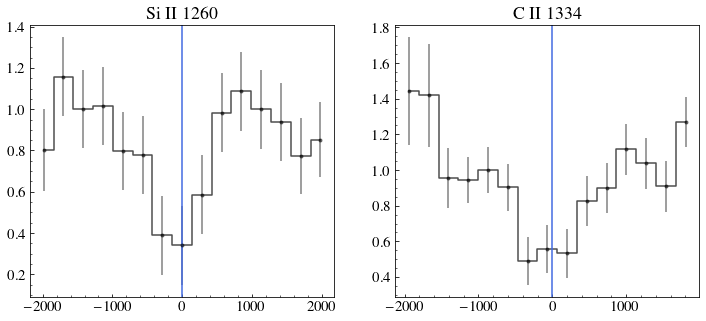

In [121]:
nGal =len(info[info['snr_per_pix']>5])
nmocks         = 10
Chi2all        = np.zeros((nGal, nmocks)) + 1e40
dirall         = np.zeros((nGal, nmocks)) - 1
outall         = np.zeros((nGal, nmocks)) - 1

v_cm = np.genfromtxt(path_to_folder+'/dat_files/vcm_90_164.dat',unpack=True)
path_to_data = path_to_data_arr[-1]

analyze_i = 0
for i in range(len(info)):    
    
    if(info['snr_per_pix'][i]<5):
        continue
    print(i)
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
    wave = dat1['wl']/(1+redshift)
    err  =  dat1['flam_err']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux = dat1['flam']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=0
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

    cutCIIall = (vcIId>-2000) & (vcIId<2000) 
    cutSiIIall = (vsiIId>-2000) & (vsiIId<2000)  
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]  
    
    rmedCII = ((vcII<-500) | (vcII > 500))
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) 
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,2,figsize=(12,5))
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.5)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    axs[1].set_title('C II 1334')
    axs[1].axvline(0, c= 'royalblue')
   
    
    axs[0].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.5)
    axs[0].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    axs[0].set_title('Si II 1260')
    axs[0].axvline(0, c= 'royalblue')



    bestfluxsiall = np.zeros((nmocks, len(vsiII)))
    bestfluxciiall = np.zeros((nmocks, len(vcII)))

    for output in range(90,165,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  =  rkms_vandels/5 /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII =  rkms_vandels/5 /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            modelNewcII = np.interp(vcII,vcII_s, modelcII)
#             modelNewcII = f(vcII)

            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            modelNewsiII= np.interp(vsiII,vsiII_s, modelsiII)
#             modelNewsiII= f(vsiII)

            
            rmedCII = ((vcII<-500) | (vcII > 700)) 
            fmedCII = np.nanmedian(modelNewcII[rmedCII])
            modelNewcII /= fmedCII            

            rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
            fmedSiII = np.nanmedian(modelNewsiII[rmedSiII])
            modelNewsiII /= fmedSiII
            
            maskCII = (vcII >-1000) & (vcII < 1000)
            maskSiII =  (vsiII > - 1000)  & (vsiII < 1600)

            if(len(ecII[maskCII]) > 0):
                lnlikecII  =  np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) #/len(ecII[maskCII])
                ncII = len(fcII[maskCII])
            else:
                lnlikecII = 0
                ncII = 0
            if(len(esiII[maskSiII]) > 0):
                lnlikesiII =  np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)#/len(esiII[maskSiII])
                nsiII = len(fsiII[maskSiII])               
            else:
                lnlikesiII = 0
                nsiII = 0

            if(np.isnan(lnlikesiII)):
                lnlikesiII = 0
                nsiII = 0
            if(np.isnan(lnlikecII)):
                lnlikecII = 0
                ncII = 0
            lnlikeall  = (lnlikecII + lnlikesiII)/(ncII + nsiII)

            for j in range(nmocks):                            
                if(lnlikeall < Chi2all[analyze_i][j]):
                    b = dirall[analyze_i].copy()
                    b = np.insert(b, j, idir)
                    b = b[:-1]
                    dirall[analyze_i] = b
                    
                    b = Chi2all[analyze_i].copy()
                    b = np.insert(b, j, lnlikeall)
                    b = b[:-1]
                    Chi2all[analyze_i] = b
                    
                    b = outall[analyze_i].copy()
                    b = np.insert(b,j, output)
                    b = b[:-1]
                    outall[analyze_i] = b

                    bestfluxsiall = np.insert(bestfluxsiall,j, modelNewsiII,0)
                    bestfluxsiall = bestfluxsiall[:-1, :]

                    bestfluxciiall = np.insert(bestfluxciiall,j, modelNewcII,0)
                    bestfluxciiall = bestfluxciiall[:-1]                                               
                              
                    break
                


    for k in range(nmocks):
        axs[1].plot(vcII, bestfluxciiall[k],
                label = '%d - TS %d - Dir %d - Chi %1.2f - fesc %.3f'%(k, outall[analyze_i][k], dirall[analyze_i][k], 
                                                                     Chi2all[analyze_i][k], 
                                                                       fesc900[int(outall[analyze_i][k])-90][int(dirall[analyze_i][k])]), 
                    lw = 3)


        axs[0].plot(vsiII, bestfluxsiall[k],  lw = 3)

    axs[1].legend(frameon=False, ncol = 1, loc =(1.1,0), fontsize = 18)
    plt.subplots_adjust(wspace = 0.1)
#     plt.suptitle(label[i])
    plt.savefig('Plots/'+info["spectrum"][i]+'match.pdf', bbox_inches = 'tight')
    axs[0].set_ylim(-0.5,3)
    axs[1].set_ylim(-0.5,3)
    plt.close()
    
    analyze_i+=1
#     plt.show()

In [126]:
totCol = np.vstack((info[info['snr_per_pix']>5]['spectrum'],outall[:,0].astype(int), dirall[:,0].astype(int),Chi2all[:,0]))
C=['Galaxy','OutputAll0','DirAll0', 'x2All0']

for k in range(1,nmocks):
    totCol = np.vstack((totCol,outall[:,k].astype(int), dirall[:,k].astype(int),Chi2all[:,k]))
    C.extend([f'OutputAll{k}',f'DirAll{k}',f'x2All{k}'])
    
# print(C)
# print(totCol)
df = pd.DataFrame(totCol.T) # A is a numpy 2d array
df.to_csv(f"Vandels_10best_nooffset.csv", sep=',', header= C, index=False) 

### Plot some fits, see quality

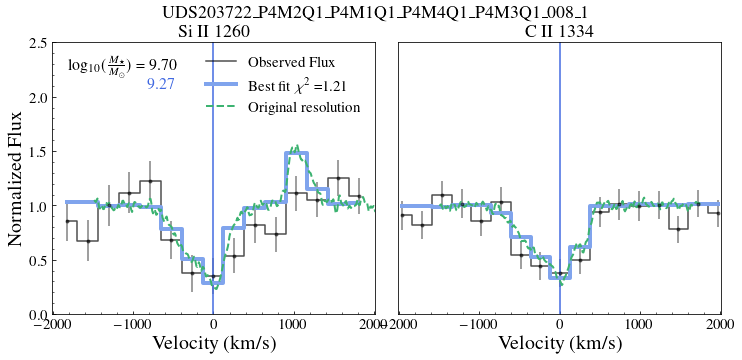

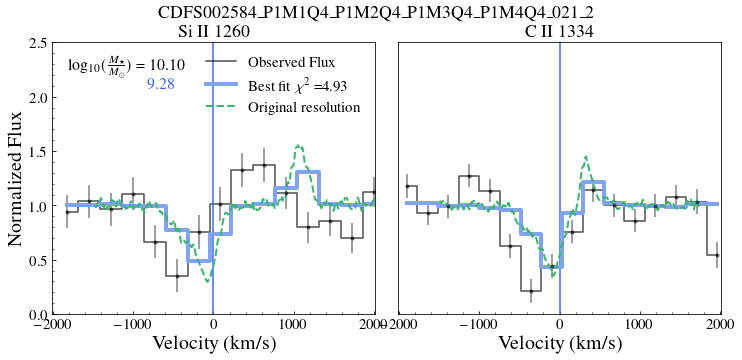

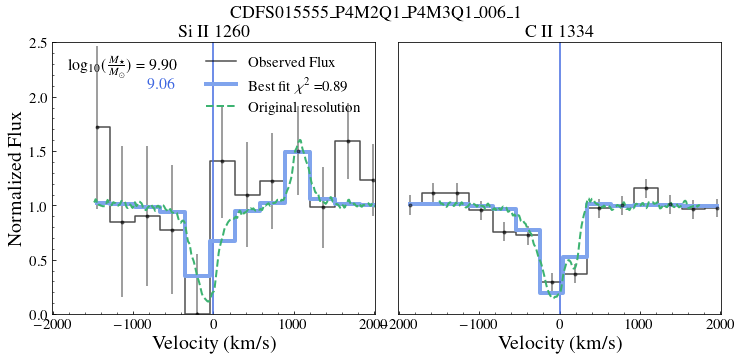

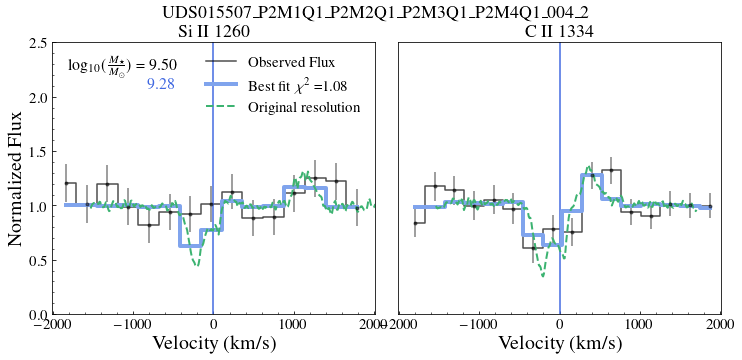

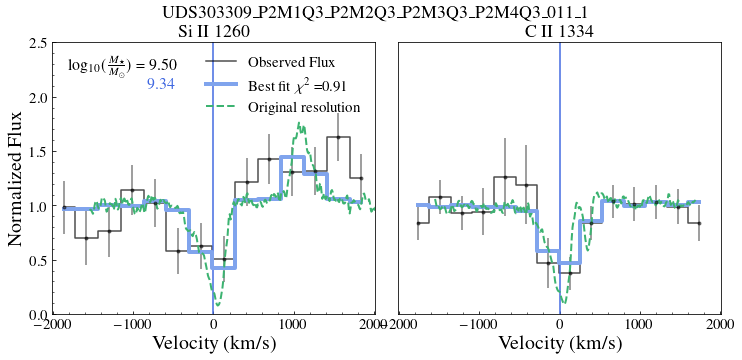

...

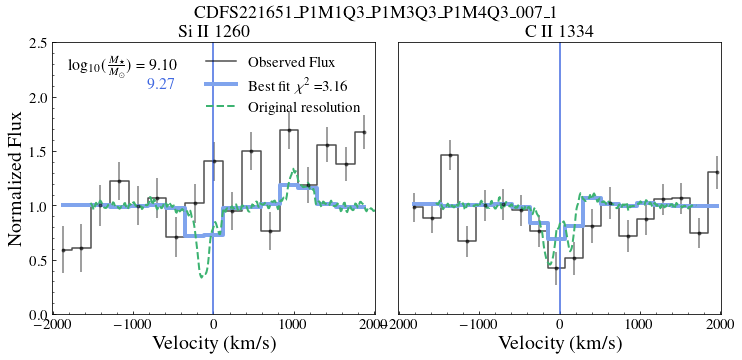

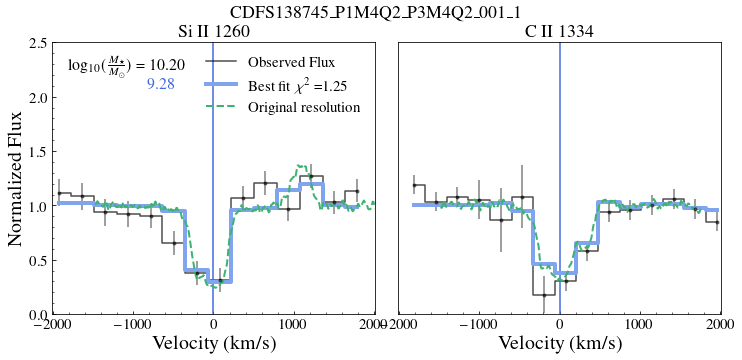

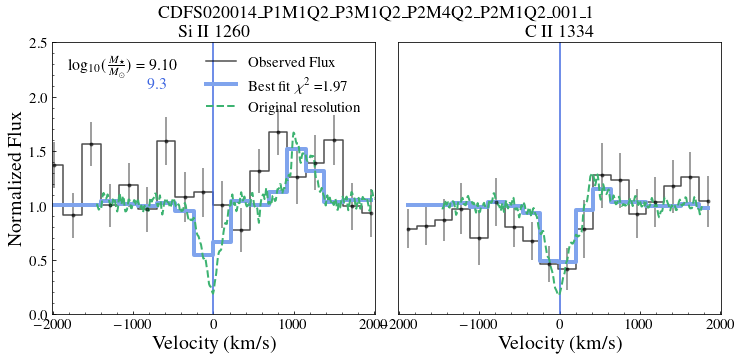

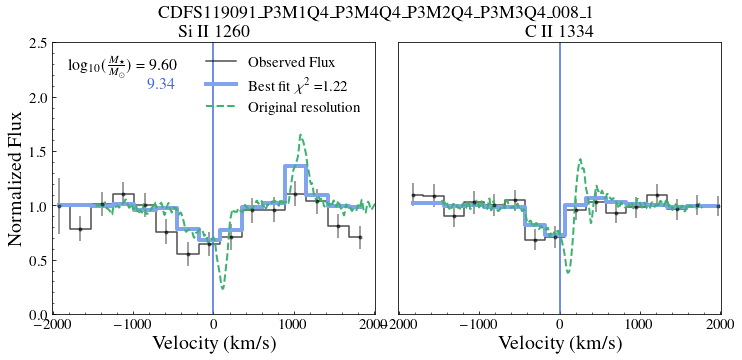

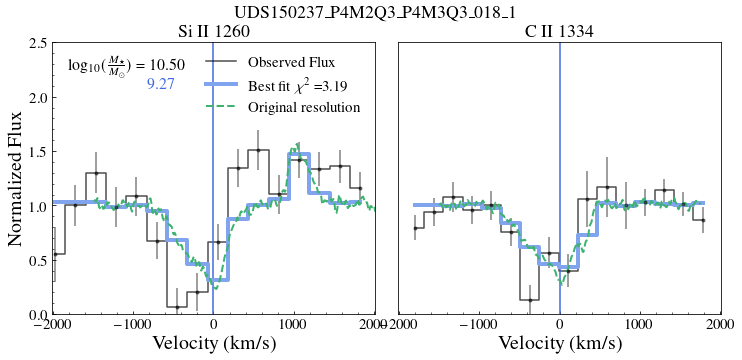

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


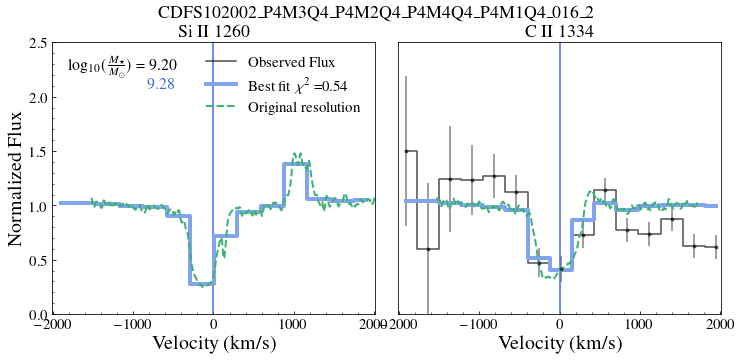

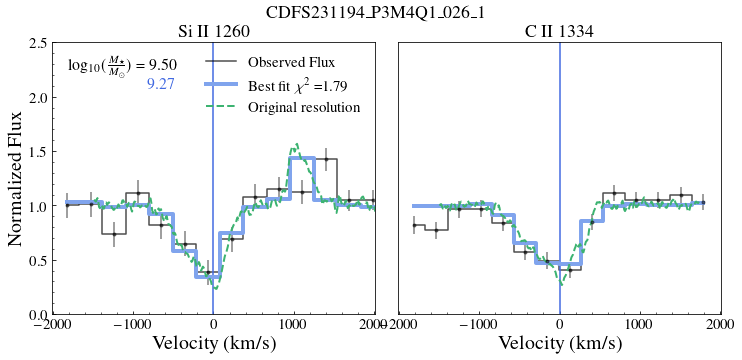

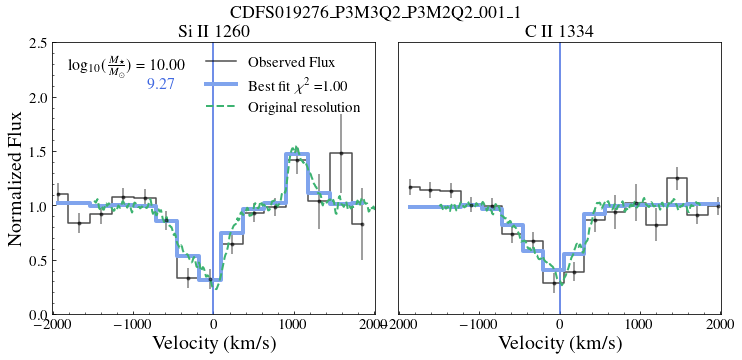

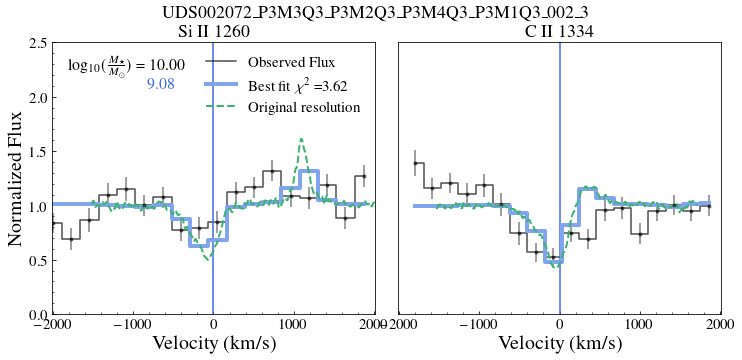

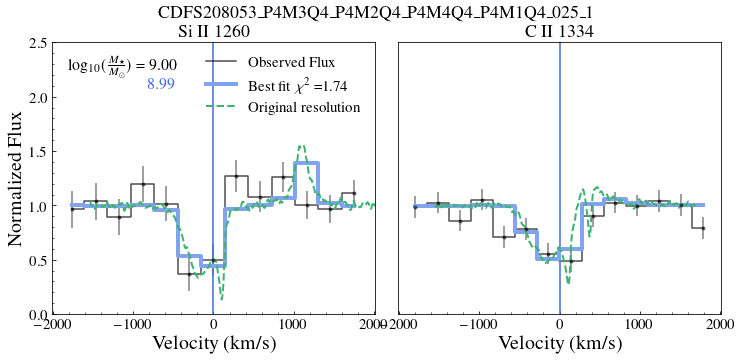

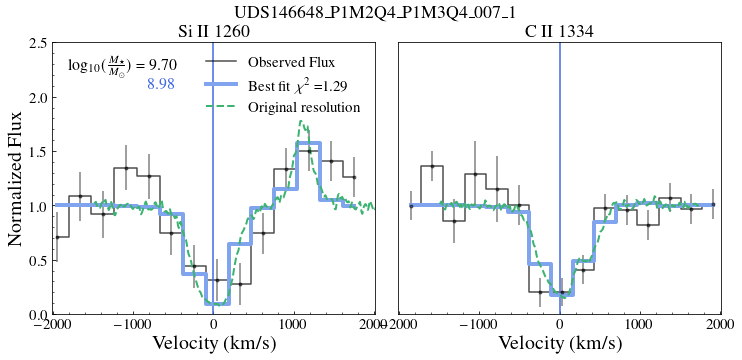

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


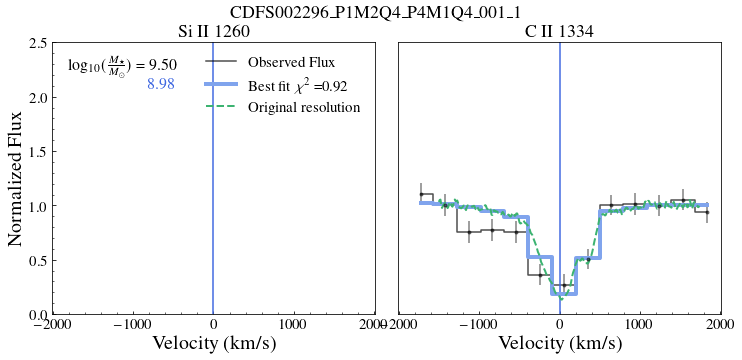

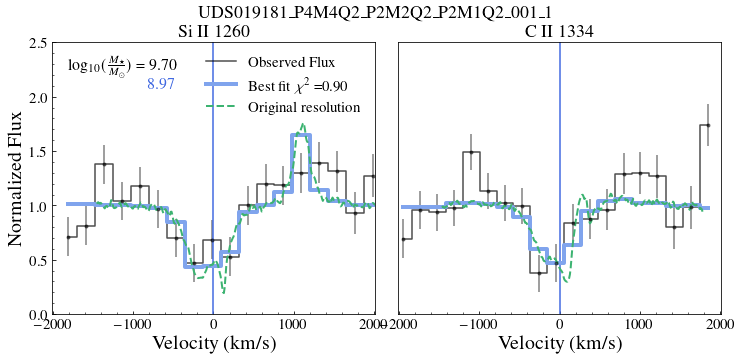

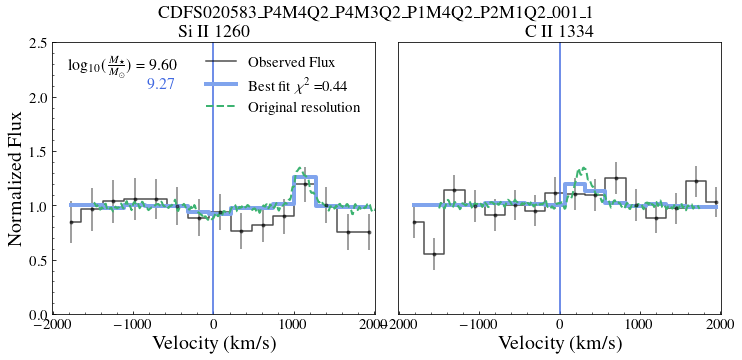

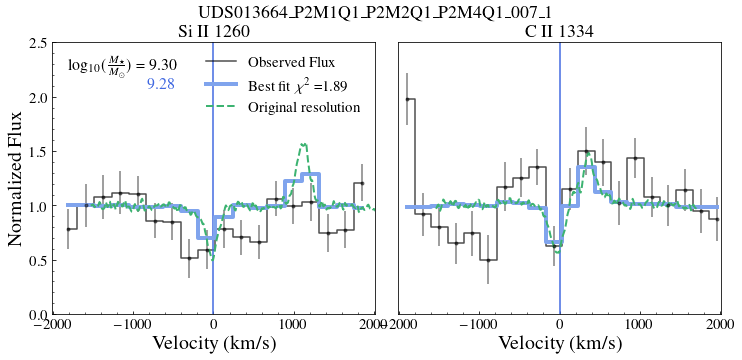

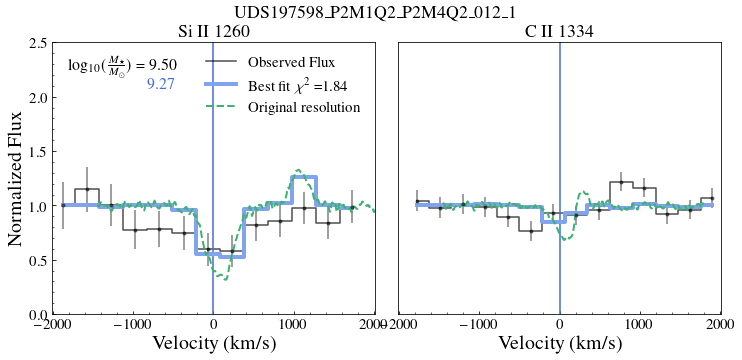

...

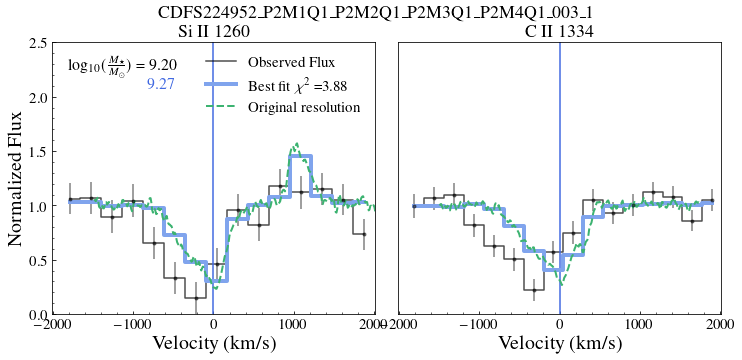

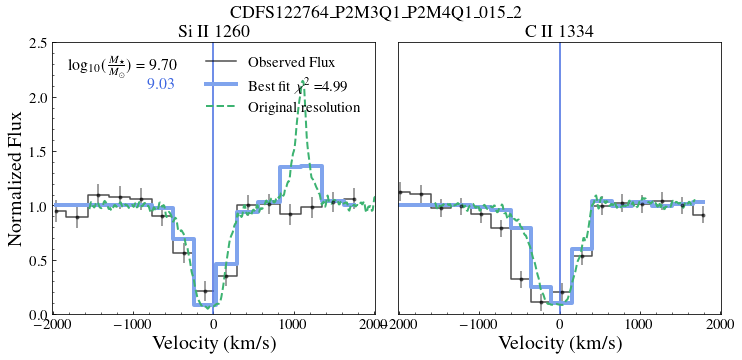

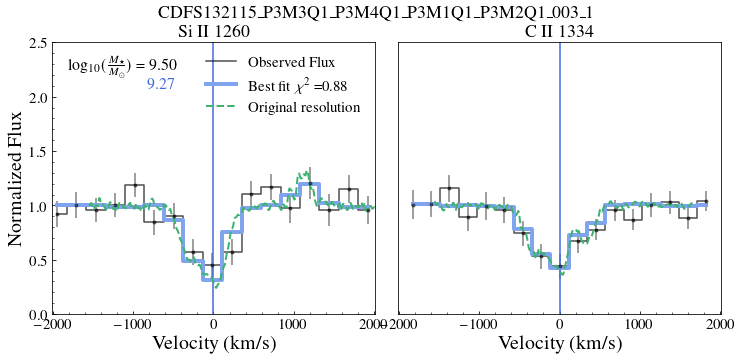

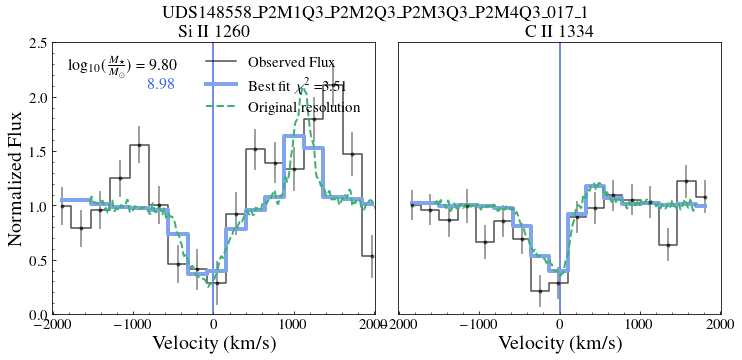

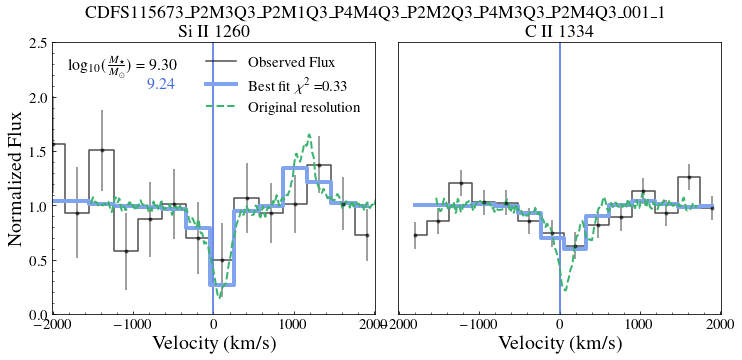

KeyError: 131

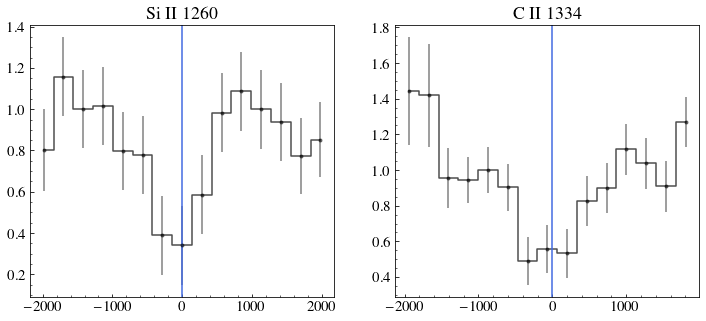

In [588]:
dfFS   = pd.read_csv('Vandels_10best_nooffset.csv')
v_cm = np.genfromtxt(path_to_folder+'./dat_files/vcm_90_164.dat',unpack=True)
chi2allC_FS = []
chi2allS_FS = []
chi2all_FS = []
onesig = 0
twosig = 0
threesig = 0
otherssig = 0
true_i= 0
for i in range(len(info)):    
    
    if(info['snr_per_pix'][i]<5):
        continue
#     print({info["spectrum"][i]})
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
    wave = dat1['wl']/(1+redshift)
    err  =  dat1['flam_err']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux = dat1['flam']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=0
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

    cutCIIall = (vcIId>-2000) & (vcIId<2000) 
    cutSiIIall = (vsiIId>-2000) & (vsiIId<2000)  
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]  
    
    rmedCII = ((vcII<-500) | (vcII > 500))
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) 
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,2,figsize=(12,5))
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.5)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed Flux')
    axs[1].set_title('C II 1334')
    axs[1].axvline(0, c= 'royalblue')
   
    
    axs[0].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.5)
    axs[0].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid', label = 'Observed Flux' )
    axs[0].set_title('Si II 1260')
    axs[0].axvline(0, c= 'royalblue')


    #######################################################                                                                                           
                                                                                                            
    # with FS
    bestDir         = dfFS['DirAll0'][true_i]
    bestOut         = dfFS['OutputAll0'][true_i]
    bestChi2FS      = dfFS['x2All0'][true_i]
    if(bestChi2FS<=1):
        onesig+=1
    elif(bestChi2FS<=2):
        twosig+=1
    elif(bestChi2FS<=3):
        threesig+=1
    else:
        otherssig+=1
    lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = rkms_vandels/4 / 2.355/((vcII_s[50]-vcII_s[49]))
    modelcii       = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    modelNewcii    = np.interp(vcII,vcII_s, modelcii)

    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    modelcii=fluxcII[bestDir,1:]/fmedCII
        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  =  rkms_vandels/4/ 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    modelsi      = gaussian_filter(fluxsiII[bestDir,1:]/np.median(fluxsiII[bestDir,1:]), sigma = sigma_pixelsi)
    modelNewsi     = np.interp(vsiII,vsiII_s, modelsi)
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    modelsi = fluxsiII[bestDir,1:]/np.median(fluxsiII[bestDir,1:])/fmedSiII
    
#     line1 = Line2D([0], [0], label='Observed flux', color='k')    
#     line3 = Line2D([0], [0], label='Best match', color=cFS)
#     patch = patches.Patch(facecolor='#E99F0C', label='Masked', alpha = 0.2)   

# #         handles.extend([patch,line])
#     axs[0].legend([line1,line3], ['Observed flux',  'Best fit'], frameon = False, ncol = 3,
#                  loc = (0.4,1), fontsize = 18)
        
        
    axs[0].set_xlabel('Velocity (km/s)', fontsize = 20,)
    axs[1].set_xlabel('Velocity (km/s)', fontsize = 20)
    axs[0].set_ylabel('Normalized Flux', fontsize = 20)
    axs[1].set_yticks([])
    axs[0].set_xlim(-2010,2010)
    axs[1].set_xlim(-2010,2010)
    plt.suptitle( '%s'%info["spectrum"][i].replace("_", "\_" ), fontsize = 18)
    
    axs[0].set_ylim(0,2.5)
    axs[1].set_ylim(0,2.5)

    maskCII = (vcII >-1000) & (vcII < 1000)
    maskSiII = (vsiII > - 800)   & (vsiII < 1700)
    #& (~((vsiII >-364) & (vsiII <-144)))
    lnlikecII  =  np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2)#/len(modelNewcii[maskCII])
    ncII = len(modelNewcii[maskCII])

    lnlikesiII =  np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)#/len(modelNewsi[maskSiII])
    nsiII = len(modelNewsi[maskSiII])
        
#     print('All ', lnlikecII/ncII, lnlikesiII/nsiII)
    lnlikeall  = (lnlikecII + lnlikesiII)/(ncII+nsiII)
#     print(lnlikeall)  
    chi2allC_FS.append(lnlikecII/ncII)
    chi2allS_FS.append(lnlikesiII/nsiII)
    chi2all_FS.append(lnlikeall)
    axs[1].plot(vcII, modelNewcii, c =cFS, lw = 4, label = 'Best match', drawstyle = 'steps-mid')
    axs[0].plot(vsiII, modelNewsi, c =cFS, lw = 4, drawstyle = 'steps-mid',
                label = 'Best fit $\chi^2$ =%.2f'%(bestChi2FS))# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])
   

    axs[1].plot(vcII_s, gaussian_filter(modelcii,sigma = 1), c ='mediumseagreen', lw = 2, ls = '--')
    axs[0].plot(vsiII_s, gaussian_filter(modelsi,sigma = 1), c ='mediumseagreen', lw = 2,
                label = 'Original resolution', ls = '--')# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])

    axs[0].text(0.05, 0.9, r'log$_{10}(\frac{M_\star}{M_\odot})$ = %.2f '%info['lmass'][i],
                transform=axs[0].transAxes, fontsize = 16)
    axs[0].text(0.05+(0.915-0.67), 0.83, str(np.round(np.log10(Mstar[bestOut-90]),2)),
                transform=axs[0].transAxes, fontsize = 16, c = 'royalblue')
    axs[0].legend(frameon = False, loc = 'upper right')
    plt.subplots_adjust(wspace=0.07, hspace=None)
    plt.savefig('Plots/WithoutOffsets/'+info["spectrum"][i]+'_bestmatch_nooffset.pdf', bbox_inches = 'tight')
    plt.show()
    true_i +=1
#     if(true_i>2):
#         break


34 55 16


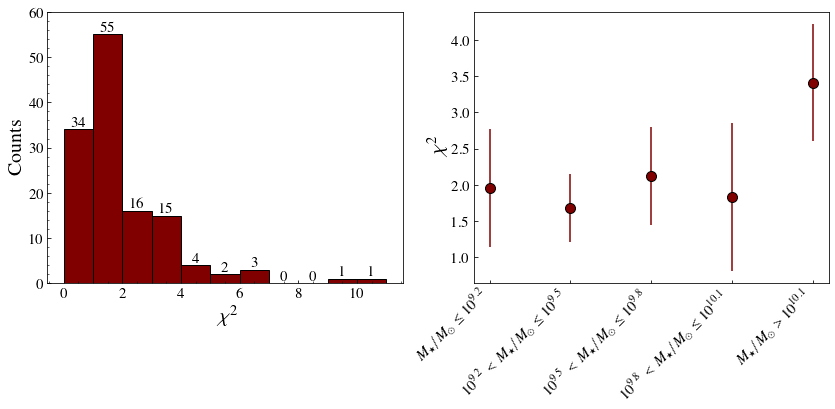

In [565]:
print(onesig, twosig, threesig)
fig, (ax1, ax2) = plt.subplots(1,2, figsize = (14,5))
counts, edges, bars =ax1.hist(dfFS['x2All0'],bins = [0,1,2,3,4,5,6,7,8,9,10,11],align='mid', 
                              alpha = 1, label = 'VANDELS',
             edgecolor = 'k',color = '#800000', )
ax1.set_xlabel(r'$\chi^2$', fontsize = 20)
ax1.set_ylabel(r'Counts', fontsize = 20)
# axs[0].legend(frameon = False, fontsize = 15))           
ax1.bar_label(bars)
ax1.set_ylim(0,60)

mask1 = info['lmass'][info['snr_per_pix']>5]<9.2
mask3 = (9.2 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.5)
# mask4 = (9.4 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.6)
mask5 = (9.5 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.8)
mask6 = (9.8 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<10.1)
mask7 = (10.1 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<10.4)
# mask8 = (10.2 <=info['lmass'][info['snr_per_pix']>5])#& (info['lmass'][info['snr_per_pix']>5]<10.4)
mask9 = (10.4 <=info['lmass'][info['snr_per_pix']>5])

ychi = [np.mean(dfFS['x2All0'][mask1.values]),
         np.mean(dfFS['x2All0'][mask3.values]),
             np.mean(dfFS['x2All0'][mask5.values]),np.mean(dfFS['x2All0'][mask6.values]),
         np.mean(dfFS['x2All0'][mask7.values])]
ystd = [np.std(dfFS['x2All0'][mask1.values]),
         np.std(dfFS['x2All0'][mask3.values]),
    np.std(dfFS['x2All0'][mask5.values]),np.std(dfFS['x2All0'][mask6.values]),
         np.std(dfFS['x2All0'][mask7.values])]

ax2.errorbar(np.arange(len(ychi)),ychi, yerr = np.asarray(ystd)/2, marker = 'o', markeredgecolor ='k',color = '#800000',
           markersize = 10, ls = 'None')

ax2.minorticks_off()
ax2.set_xticks([0,1,2,3,4])
ax2.set_ylabel(r'$\chi^2$', fontsize = 20)

ax2.set_xticklabels([r'$M_\star/M_\odot \leq 10^{9.2}$',
                     r'$10^{9.2}$ $<$ $M_\star/M_\odot \leq 10^{9.5}$',
                     r'$10^{9.5}$ $<$ $M_\star/M_\odot\leq 10^{9.8}$',
                     r'$10^{9.8}$ $<$ $M_\star/M_\odot  \leq 10^{10.1}$',
                     r'$M_\star/M_\odot > 10^{10.1}$'],ha="right" ,rotation = 45)
plt.savefig('Plots/Chisquare_wooff.pdf', bbox_inches = 'tight')


5      0.430725
13     0.299606
15     0.912445
19     1.130430
27     1.990837
33     1.937158
37     0.455410
61     3.625406
69     1.895476
71     3.163402
78     0.996752
102    6.444831
107    2.159768
Name: x2All0, dtype: float64


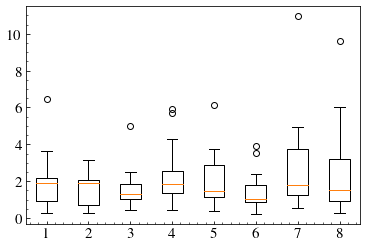

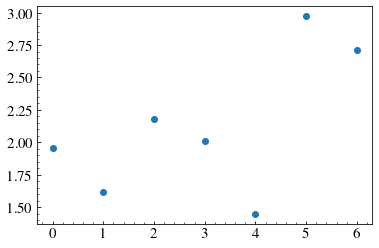

In [541]:
mask1 = info['lmass'][info['snr_per_pix']>5]<9.2
# mask2 = (9 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.2)
mask3 = (9.2 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.4)
mask4 = (9.4 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.6)
mask5 = (9.6 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.8)
mask6 = (9.8 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<10)
mask7 = (10 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<10.2)
mask8 = (10.2 <=info['lmass'][info['snr_per_pix']>5])#& (info['lmass'][info['snr_per_pix']>5]<10.4)
mask9 = (10.4 <=info['lmass'][info['snr_per_pix']>5])
         
print(dfFS['x2All0'][mask1.values])
plt.boxplot([dfFS['x2All0'][mask1.values],dfFS['x2All0'][mask2.values],dfFS['x2All0'][mask3.values],
             dfFS['x2All0'][mask4.values],
             dfFS['x2All0'][mask5.values],dfFS['x2All0'][mask6.values],dfFS['x2All0'][mask7.values],
             dfFS['x2All0'][mask8.values]])

plt.figure()
plt.scatter(np.arange(7),[np.mean(dfFS['x2All0'][mask1.values]),
         np.mean(dfFS['x2All0'][mask3.values]),
             np.mean(dfFS['x2All0'][mask4.values]),
             np.mean(dfFS['x2All0'][mask5.values]),np.mean(dfFS['x2All0'][mask6.values]),
         np.mean(dfFS['x2All0'][mask7.values]),
             np.mean(dfFS['x2All0'][mask8.values])])

In [538]:
 info['spectrum'][(info['lmass']>10.4) & (info['snr_per_pix']>5) ]

240                          UDS003664_P1M1Q4_010_1
260    CDFS131961_P3M3Q1_P3M4Q1_P3M1Q1_P3M2Q1_002_1
530                   UDS150237_P4M2Q3_P4M3Q3_018_1
729                          UDS143762_P4M1Q4_033_1
Name: spectrum, dtype: object

### Compare stellar masses

1846000000.0


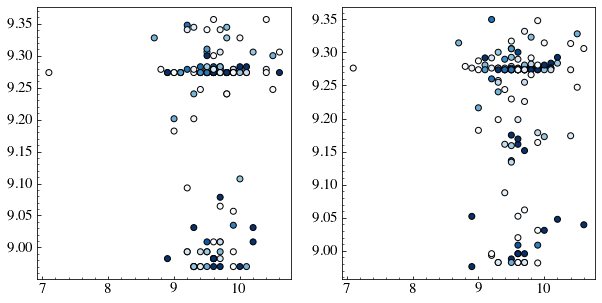

In [154]:
fig, (ax0, ax1) = plt.subplots(1,2,figsize =(14,5) )
ax0.scatter(info[info['snr_per_pix']>5]['lmass'], np.log10(Mstar[outall[:,0].astype(int)-90]), 
            c = Chi2all[:,0], vmin = 1, vmax = 3, cmap = 'Blues', edgecolor = 'k')

bestMstar10 = []
print(np.median(Mstar[outall[i, 0:10].astype(int)-90]))
for i in range(len(outall[:,0])):
    bestMstar10.append(np.median(Mstar[outall[i, :10].astype(int)-90]))
#     print(np.median(Mstar[outall[i, 10*i:10*(i+1)].astype(int)-90]))
ax1.scatter(info[info['snr_per_pix']>5]['lmass'], np.log10(bestMstar10), 
            c = Chi2all[:,0], vmin = 1, vmax = 3, cmap = 'Blues', edgecolor = 'k')

### Escape fractions

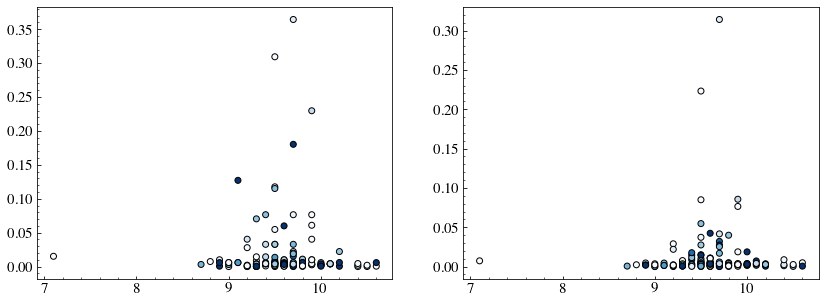

In [160]:
fig, (ax0, ax1) = plt.subplots(1,2,figsize =(14,5) )
ax0.scatter(info[info['snr_per_pix']>5]['lmass'], fesc900[outall[:,0].astype(int)-90,dirall[:,0].astype(int)], 
            c = Chi2all[:,0], vmin = 1, vmax = 3, cmap = 'Blues', edgecolor = 'k')

fesc_med = []
for i in range(len(outall[:,0])):
    fesc_med.append(np.median(fesc900[outall[i, :10].astype(int)-90, dirall[i, :10].astype(int)]))
#     print(np.median(Mstar[outall[i, 10*i:10*(i+1)].astype(int)-90]))
ax1.scatter(info[info['snr_per_pix']>5]['lmass'], fesc_med, 
            c = Chi2all[:,0], vmin = 1, vmax = 3, cmap = 'Blues', edgecolor = 'k')

In [163]:
print(np.mean(fesc_med),np.median(fesc_med), np.std(fesc_med))
fesc_one = fesc900[outall[:,0].astype(int)-90,dirall[:,0].astype(int)]
print(np.mean(fesc_one),np.median(fesc_one), np.std(fesc_one))


0.012376676877862597 0.0034479000000000003 0.035642903548567834
0.02059666411514275 0.0043153 0.051506485305232906


## Fit with shift

In [222]:
def shift5(arr, num, fill_value=1):
    result = np.empty_like(arr)
    if num > 0:
        result[:num] = fill_value
        result[num:] = arr[:-num]
    elif num < 0:
        result[num:] = fill_value
        result[:num] = arr[-num:]
    else:
        result[:] = arr
    return result

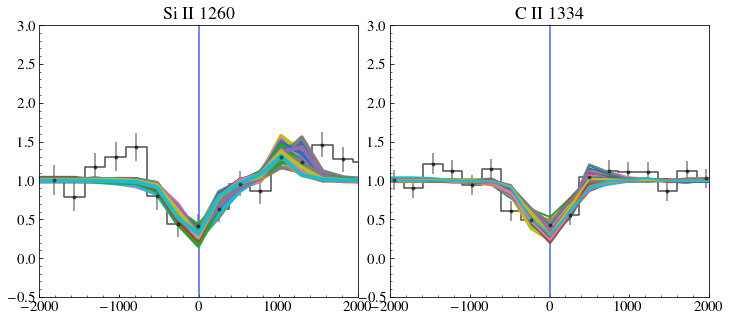

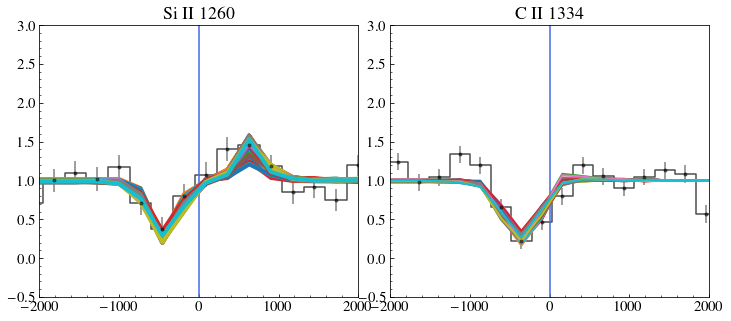

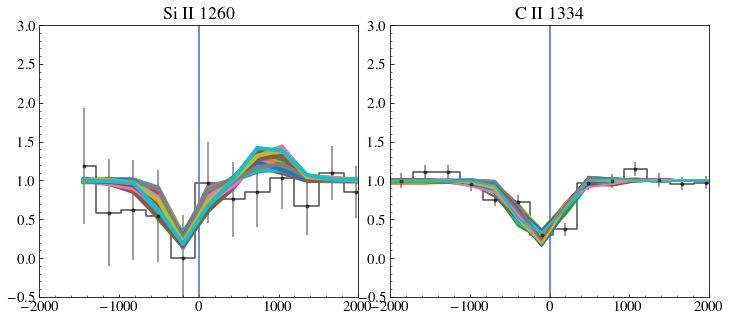

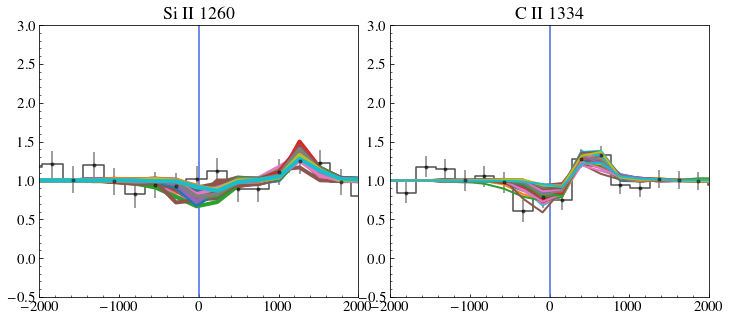

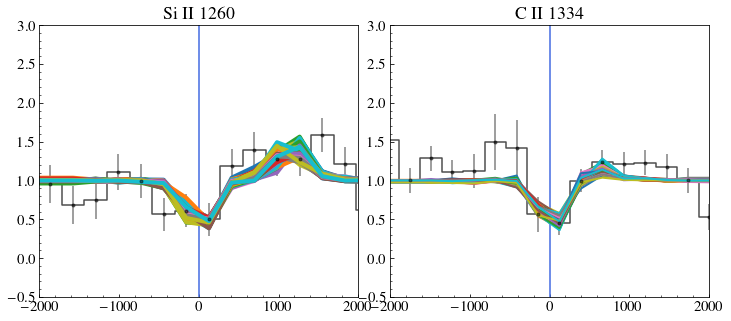

...

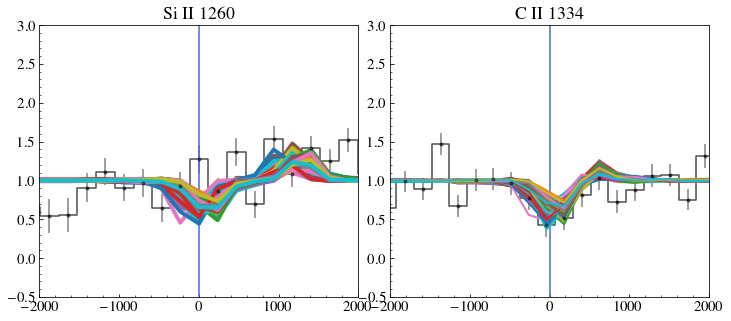

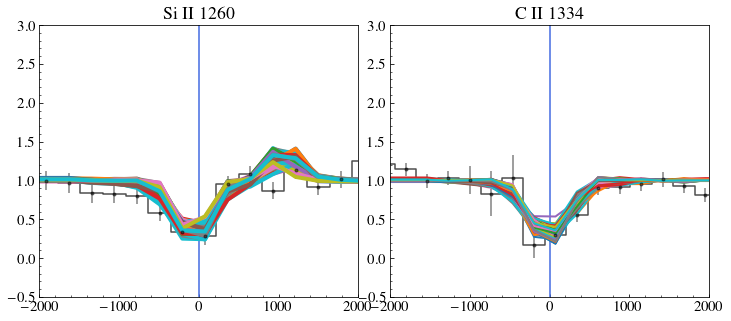

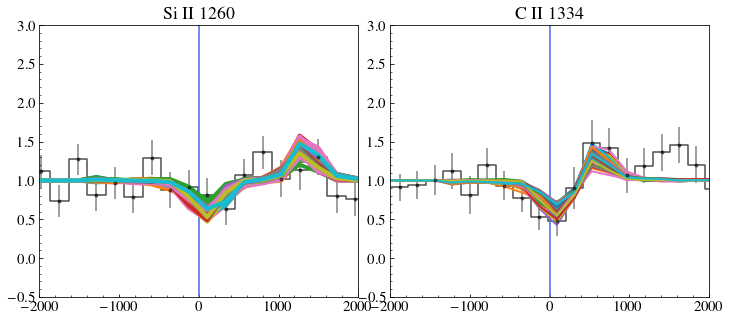

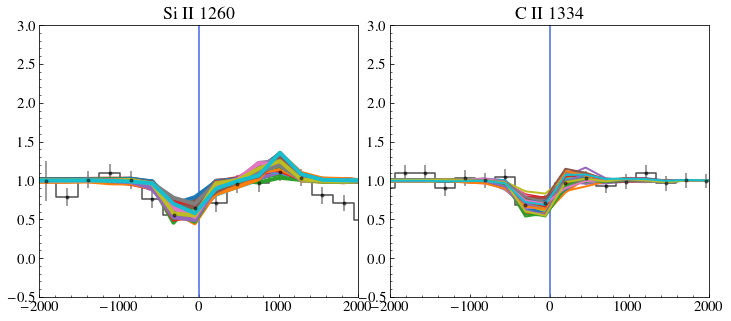

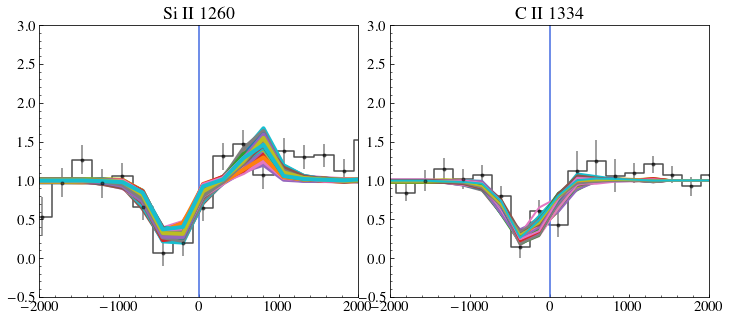

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


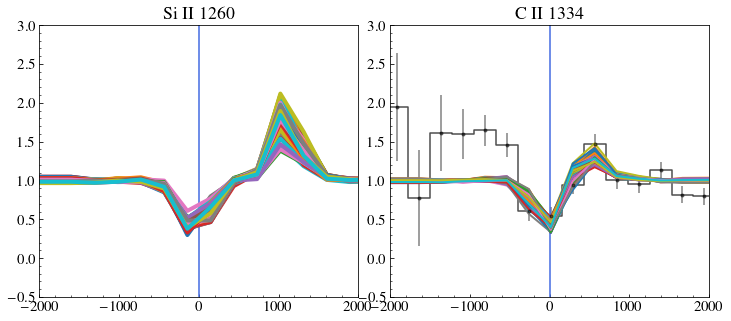

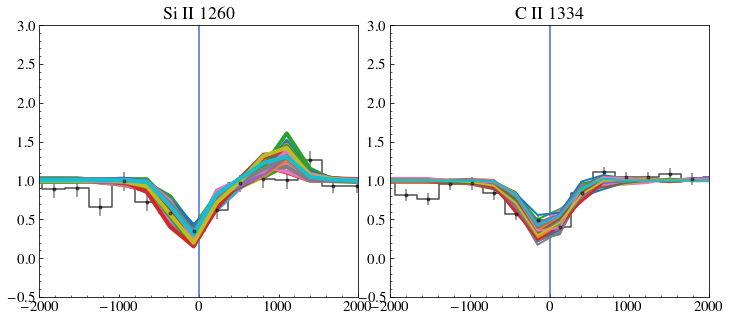

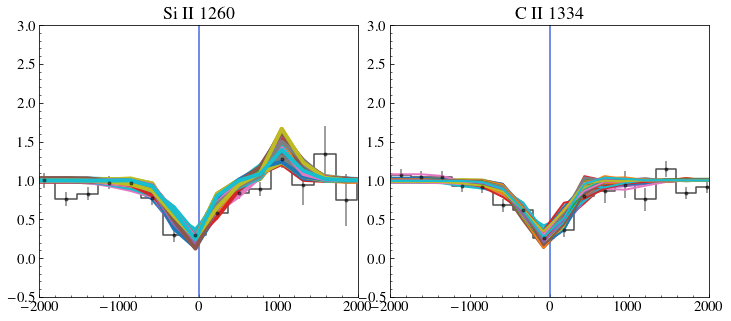

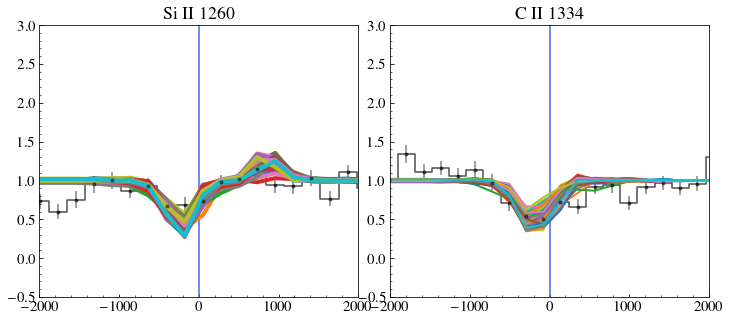

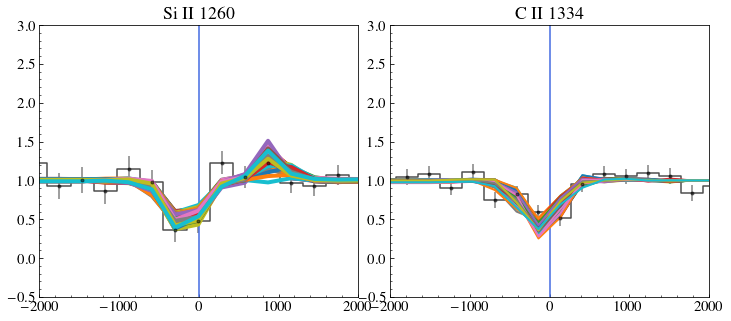

...

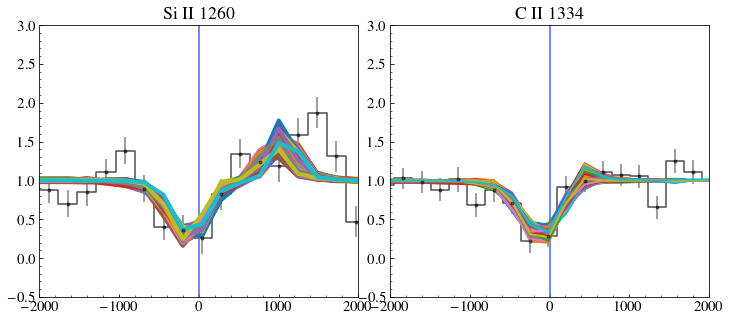

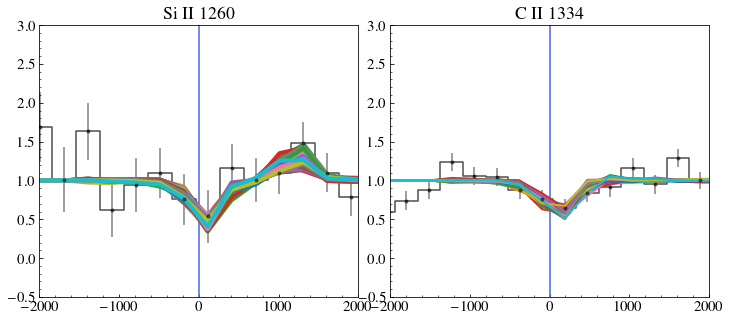

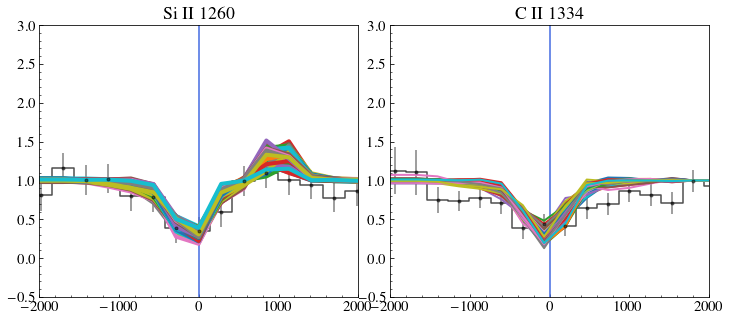

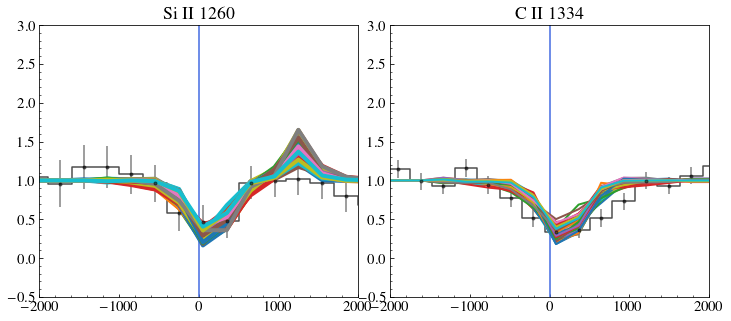

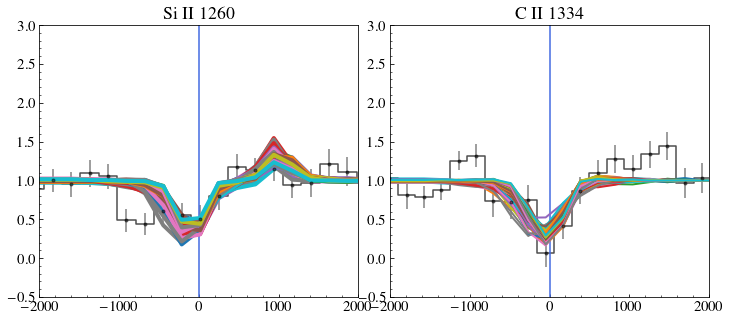

In [235]:
import scipy.signal as signal
from scipy import fftpack
import time
nGal =len(info[(info['snr_per_pix']>=5) & (info['lmass']>7.5)])
nmocks         = 100
Chi2all        = np.zeros((nGal, nmocks)) + 1e40
dirall         = np.zeros((nGal, nmocks)) - 1
outall         = np.zeros((nGal, nmocks)) - 1
offall         = np.zeros((nGal, nmocks)) - 1

v_cm = np.genfromtxt(path_to_folder+'/dat_files/vcm_90_164.dat',unpack=True)
path_to_data = path_to_data_arr[-1]

analyze_i = 0

for i in range(len(info)):    
    
    if(info['snr_per_pix'][i]<5 or info['lmass'][i]<7.5):
        continue
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
    wave = dat1['wl']/(1+redshift)
    err  =  dat1['flam_err']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux = dat1['flam']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=0
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

    cutCIIall = (vcIId>-3000) & (vcIId<3000) 
    cutSiIIall = (vsiIId>-3000) & (vsiIId<3000)  
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]  
    
    rmedCII = ((vcII<-1200) | (vcII>1200))
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-1000) |  (vsiII > 2000) )
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII  
    
    
    fig, axs = plt.subplots(1,2,figsize=(12,5))
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.5)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed')
    axs[1].set_title('C II 1334')
    axs[1].axvline(0, c= 'royalblue')
   
    
    axs[0].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.5)
    axs[0].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid' )
    axs[0].set_title('Si II 1260')
    axs[0].axvline(0, c= 'royalblue')

    bestfluxsiall = np.zeros((nmocks, len(vsiII)))
    bestfluxciiall = np.zeros((nmocks, len(vcII)))
    
    
    for output in range(90,165,1):
    
        lcII,  fluxcII  = read_spectrum_c(path_to_data,output) 
        lsiII, fluxsiII = read_spectrum_si(path_to_data,output) 
        
        for idir in range(300):
            lcII_systemic = lcII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lcII) 
            lcII_systemic = lcII_systemic[1:]
            vcII_s    = (lcII_systemic/wcII1334 -1)*c

            lsiII_systemic = lsiII + np.dot(directions[idir,:],v_cm[:,output-90])/c_cgs*1e5*np.mean(lsiII) 
            lsiII_systemic = lsiII_systemic[1:]
            vsiII_s  = (lsiII_systemic/wsiII1260 -1)*c

            sigma_pixelcII  =  rkms_vandels/2 /2.355/ ((vcII_s[50] - vcII_s[49]))
            sigma_pixelsiII =  rkms_vandels/2 /2.355/ ((vsiII_s[50]- vsiII_s[49]))

            modelcII    = gaussian_filter(fluxcII[idir,1:], sigma = sigma_pixelcII)
            modelsiII   = gaussian_filter(fluxsiII[idir,1:], sigma = sigma_pixelsiII)
            

            rmedCII = ((vcII_s<-1200) | (vcII_s>1200))
            fmedCII = np.nanmedian(modelcII[rmedCII])
            modelcII /= fmedCII            

            rmedSiII = ((vsiII_s<-1000) |  (vsiII_s > 2000) )
            fmedSiII = np.nanmedian(modelsiII[rmedSiII])
            modelsiII /= fmedSiII
            
            extrapcII   =  modelcII[(vcII_s>-1500) & (vcII_s<1500)]
            fcIIextrap  =  np.interp(vcII_s[(vcII_s>-1500) & (vcII_s<1500)], vcII,fcII )
            extrapsiII  =  modelsiII[(vsiII_s>-1500) & (vsiII_s<1900)]
            fsiIIextrap =  np.interp(vsiII_s[(vsiII_s>-1500) & (vsiII_s<1900)], vsiII,fsiII )

            modelextrap = np.concatenate((extrapcII, extrapsiII))
            fextrap = np.concatenate((fcIIextrap, fsiIIextrap))

            A = fftpack.fft(np.asarray(fextrap))
            B = fftpack.fft(modelextrap)
            Ar = -A.conjugate()
            Br = -B.conjugate()
            d = np.abs(fftpack.ifft(Ar*B))
            d[100:len(d)-100] = 0
            off = np.argmax(d)
            if(off>len(d)/2):
                off = off - len(fextrap) #-len(modelextrap)
            off = -off
            modelsiII = shift5(modelsiII, off)
            modelcII = shift5(modelcII, off)

            modelNewcII = np.interp(vcII,vcII_s, modelcII)
            modelNewsiII= np.interp(vsiII,vsiII_s, modelsiII)

            maskCII = (vcII >-1000) & (vcII < 1000)
            maskSiII =  (vsiII > -1000)  & (vsiII < 1700)

            
            if(len(ecII[maskCII]) > 0):
                lnlikecII  =  np.nansum(((fcII[maskCII]-modelNewcII[maskCII])**2)/ecII[maskCII]**2) #/len(ecII[maskCII])
                ncII = len(fcII[maskCII])
            else:
                lnlikecII = 0
                ncII = 0
            if(len(esiII[maskSiII]) > 0):
                lnlikesiII =  np.nansum(((fsiII[maskSiII] - modelNewsiII[maskSiII])**2)/esiII[maskSiII]**2)#/len(esiII[maskSiII])
                nsiII = len(fsiII[maskSiII])               
            else:
                lnlikesiII = 0
                nsiII = 0

            if(np.isnan(lnlikesiII)):
                lnlikesiII = 0
                nsiII = 0
            if(np.isnan(lnlikecII)):
                lnlikecII = 0
                ncII = 0
            lnlikeall  = (lnlikecII + lnlikesiII)/(ncII + nsiII)
            
            if(lnlikeall > Chi2all[analyze_i][-1]):
                continue
            else:
                for j in range(nmocks):                            
                    if(lnlikeall < Chi2all[analyze_i][j]):
                        b = dirall[analyze_i].copy()
                        b = np.insert(b, j, idir)
                        b = b[:-1]
                        dirall[analyze_i] = b

                        b = Chi2all[analyze_i].copy()
                        b = np.insert(b, j, lnlikeall)
                        b = b[:-1]
                        Chi2all[analyze_i] = b

                        b = outall[analyze_i].copy()
                        b = np.insert(b,j, output)
                        b = b[:-1]
                        outall[analyze_i] = b

                        b = offall[analyze_i].copy()
                        b = np.insert(b,j, off)
                        b = b[:-1]
                        offall[analyze_i] = b

                        bestfluxsiall = np.insert(bestfluxsiall,j, modelNewsiII,0)
                        bestfluxsiall = bestfluxsiall[:-1, :]

                        bestfluxciiall = np.insert(bestfluxciiall,j, modelNewcII,0)
                        bestfluxciiall = bestfluxciiall[:-1]                 

                        break
 



    for k in range(nmocks):
#         if(np.sum(bestfluxsiall[k]))
        off = offall[analyze_i][k]
        #print(off)
        #print('Velocity offset:', vcII_s[50+int(off)]-vcII_s[50],vsiII_s[50+int(off)]-vsiII_s[50] )
        axs[1].plot(vcII, bestfluxciiall[k],
                label = 'Mock %d - TS %d - Chi %1.3f - off vel %.0f'%(k, outall[analyze_i][k],
                                                             Chi2all[analyze_i][k],
                                                                      vsiII_s[50+int(off)]-vsiII_s[50]), lw = 2)

        axs[0].plot(vsiII, bestfluxsiall[k],  lw = 4)

    plt.subplots_adjust(wspace = 0.1)
#     plt.suptitle(label[i])
#     plt.savefig('Plots/'+info["spectrum"][i]+'match_off.pdf', bbox_inches = 'tight')
    axs[0].set_ylim(-0.5,3)
    axs[1].set_ylim(-0.5,3)
    axs[0].set_xlim(-2000,2000)
    axs[1].set_xlim(-2000,2000)   
    analyze_i +=1
    plt.show()
    plt.close()
#     break

                

In [243]:
print(Chi2all[0][:])

[1.15985676 1.16954766 1.27751321 1.32140053 1.3231661  1.32390987
 1.32555262 1.33099523 1.34341882 1.35043905 1.3532535  1.36301251
 1.36363138 1.36750534 1.37265298 1.37577034 1.37908619 1.38231068
 1.38312893 1.38341656 1.39180797 1.3958621  1.39660825 1.39797453
 1.40236344 1.40368351 1.40398551 1.40592545 1.41202867 1.41210522
 1.41364817 1.41542322 1.41758701 1.41850869 1.41878451 1.42041673
 1.4208168  1.42255764 1.42258276 1.42385178 1.43121723 1.43211194
 1.43214985 1.43947927 1.44100461 1.4451859  1.44578922 1.44611157
 1.44743468 1.44775053 1.45037188 1.45464567 1.4558015  1.45811397
 1.45955202 1.46035439 1.46055247 1.46447711 1.46515944 1.46559593
 1.46754233 1.46763748 1.47227893 1.47441581 1.47519301 1.47822734
 1.47908879 1.47998753 1.48043462 1.48135649 1.48457941 1.48740948
 1.48747173 1.48824512 1.48906735 1.49006545 1.49044593 1.49052803
 1.49084121 1.49151034 1.49246107 1.49332352 1.4963282  1.49840107
 1.49917033 1.50213613 1.5026887  1.50299728 1.50370827 1.5038

In [241]:
totCol = np.vstack((info[(info['snr_per_pix']>=5) & (info['lmass']>7.5)]['spectrum'],outall[:,0].astype(int), 
                    dirall[:,0].astype(int),Chi2all[:,0], offall[:,0]))
C=['Galaxy','OutputAll0','DirAll0', 'x2All0', 'outAll0']

for k in range(1,nmocks):
    totCol = np.vstack((totCol,outall[:,k].astype(int), dirall[:,k].astype(int),Chi2all[:,k],offall[:,k]))
    C.extend([f'OutputAll{k}',f'DirAll{k}',f'x2All{k}', f'outAll{k}'])
    
# print(C)
# print(totCol)
df = pd.DataFrame(totCol.T) # A is a numpy 2d array
df.to_csv(f"Vandels_100best_offset.csv", sep=',', header= C, index=False) 

### Plot some fits, see quality

here 1
here 1
9.7 0.8205468030127248 0.7772197059741653 0.8735021438376308


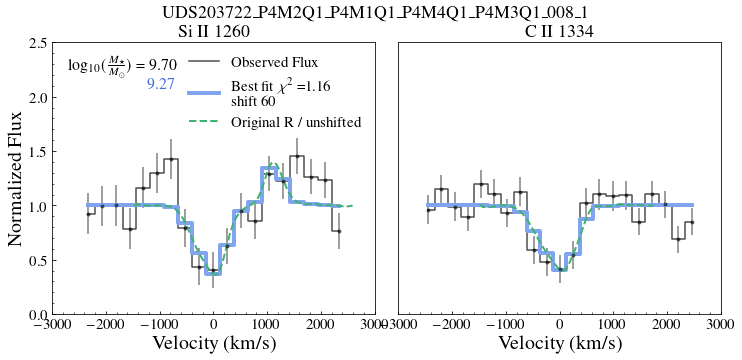

10.1 1.0766193452305595 1.260382697919898 0.8724378422424055


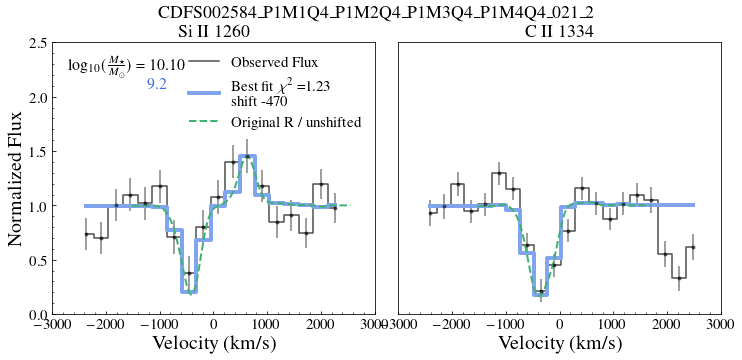

9.9 1.1497102324125588 1.9619023736613233 0.23599407350769885


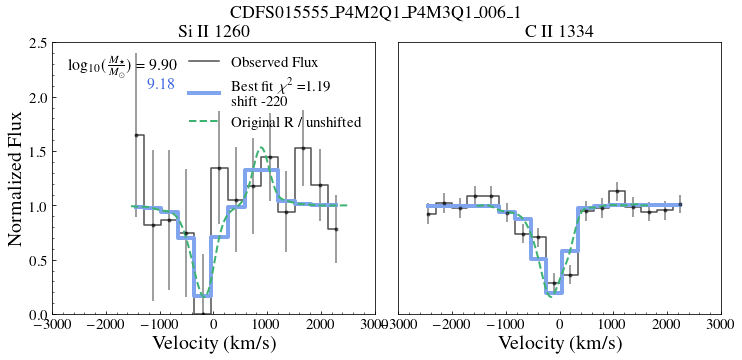

here 1
here 1
9.5 0.7120176998862007 0.8384886670624958 0.5714944030236505


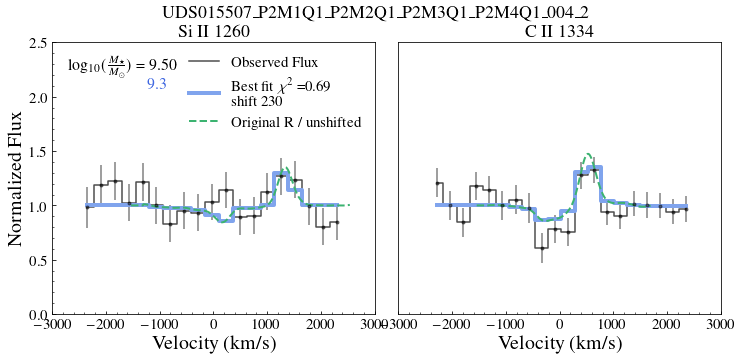

here 1
here 1
9.5 0.6040591015377728 0.44313430890515815 0.8052150923285413


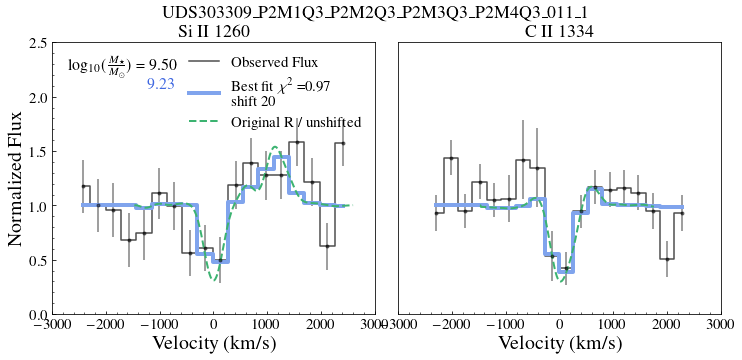

here 1
here 1
9.5 0.3763416950947322 0.4448637913487006 0.30020603259032297


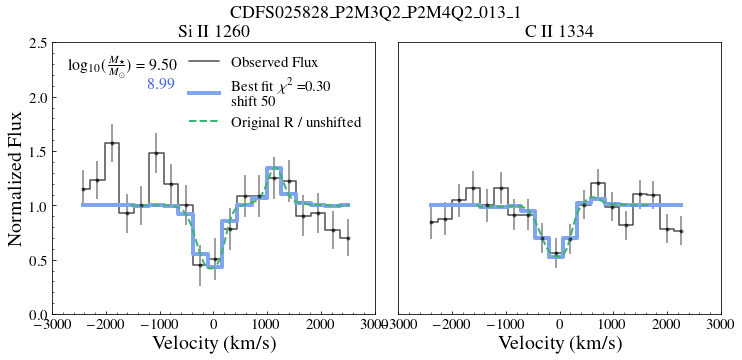

here 1
here 1
10.2 1.0617744287244733 0.6542125566164004 1.5146209532889983


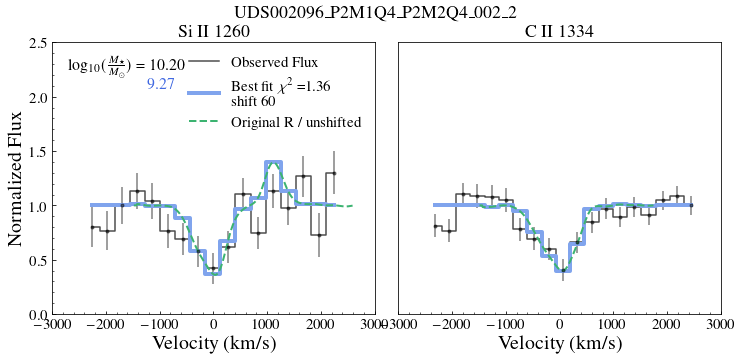

9.6 1.7266256476645456 2.7902423389035174 0.5566472873016771


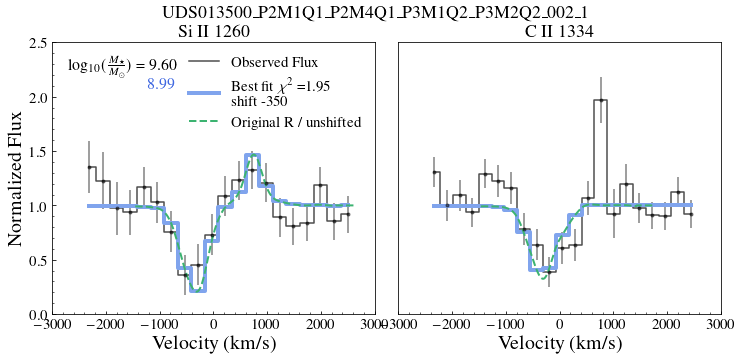

9.4 1.037715264758388 1.3356535518634778 0.7066727235305105


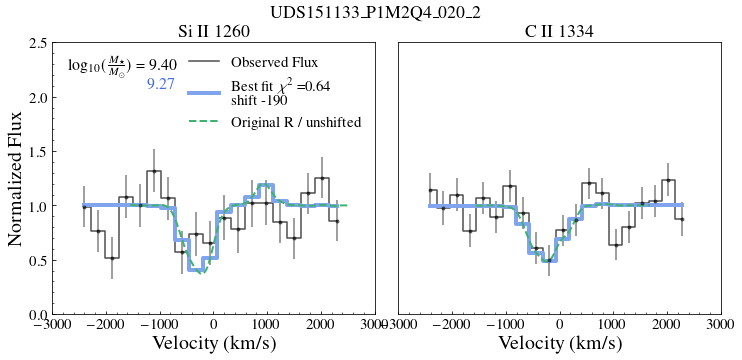

here 1
here 1
9.7 1.5765616372943037 1.3247014540066382 1.85640628539171


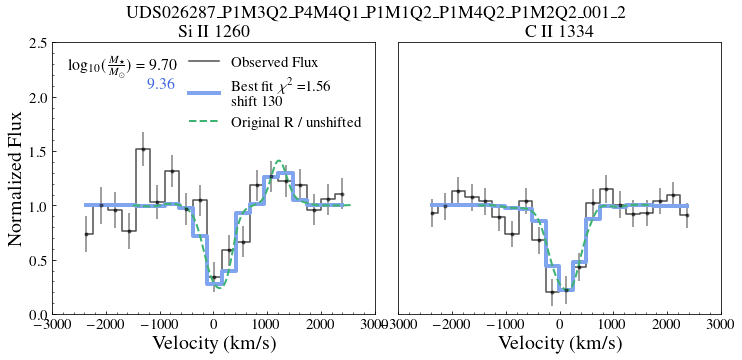

10.1 0.846557727171704 0.9893114925919841 0.6879424322602818


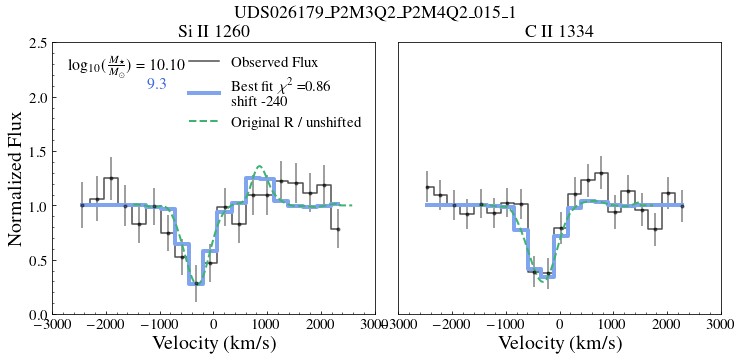

here 1
here 1
9.7 1.15953709042756 1.1506911899334045 1.1693658687543997


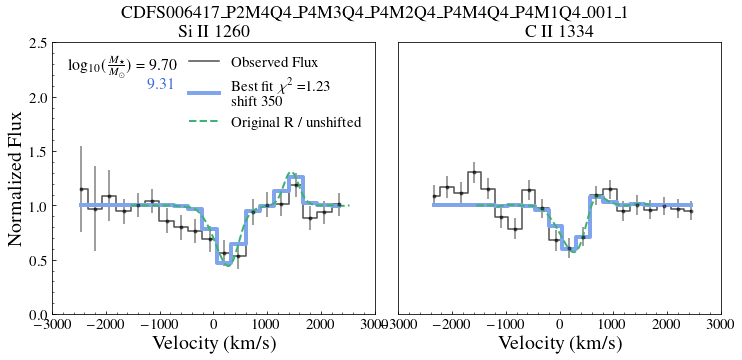

9.3 0.33192774488579035 0.444329186470814 0.20703725423576408


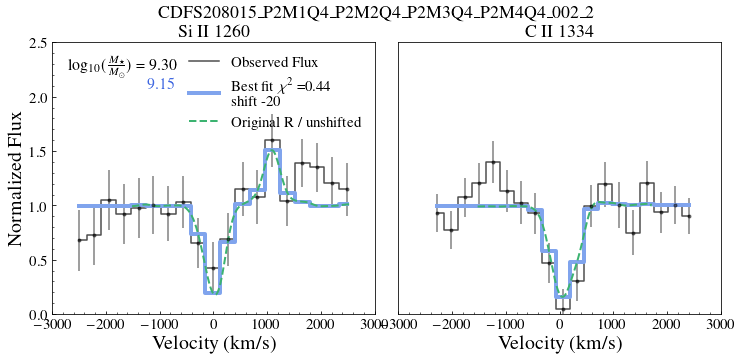

here 1
here 1
9.0 1.2692329718638027 1.172314271578007 1.3661516721495985


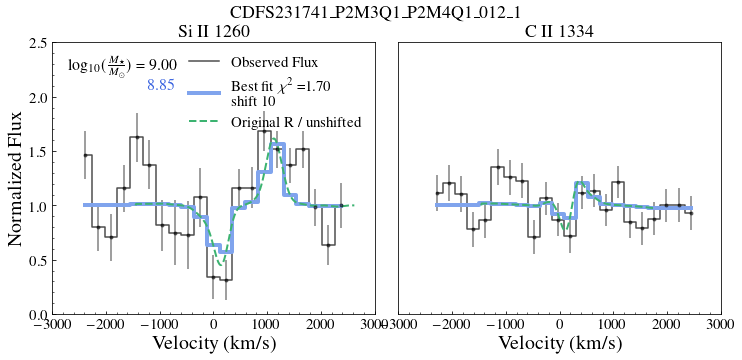

here 1
here 1
9.5 0.8544598474422346 0.5289787250237241 1.179940969860745


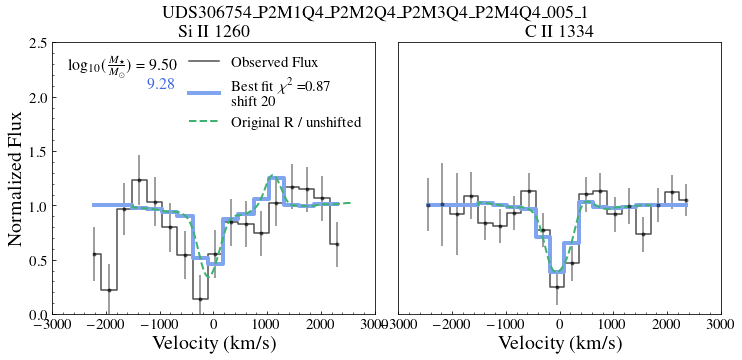

9.7 1.8669099956965447 2.134732327047675 1.572305431210302


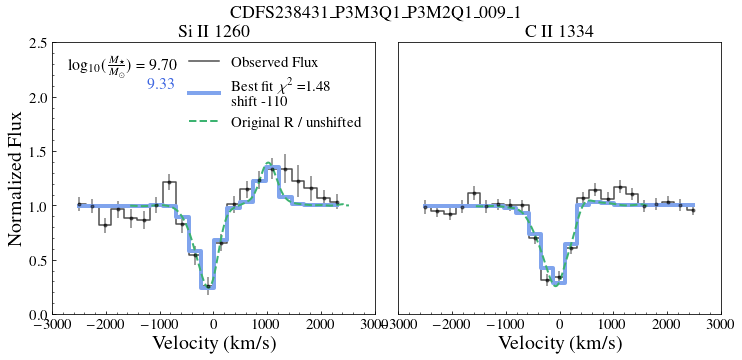

8.8 1.2481403950740821 1.9392415186303744 0.55703927151779


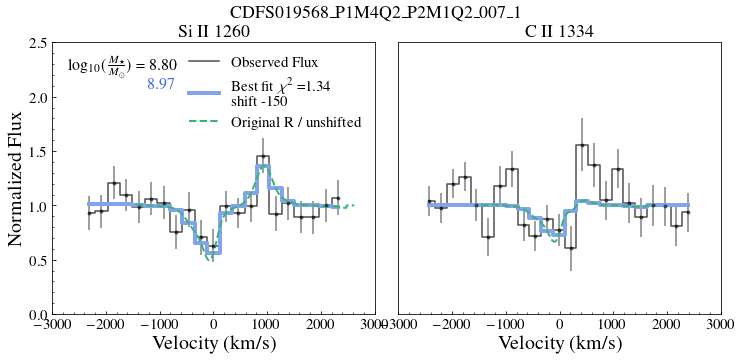

9.6 1.5073239407905887 1.7833244331263693 1.2006567270841662


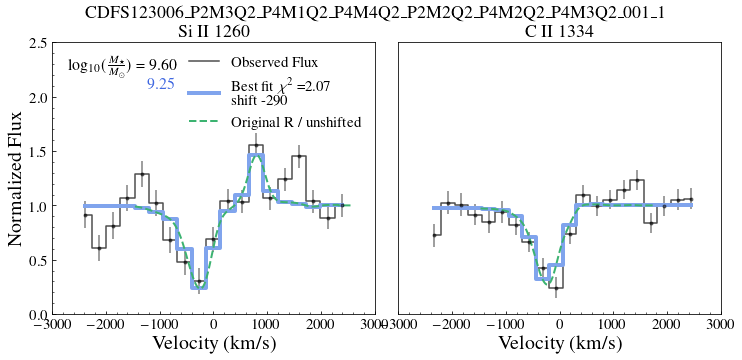

here 1
here 1
9.5 0.7984522804974179 0.48975156110013807 1.1071529998946978


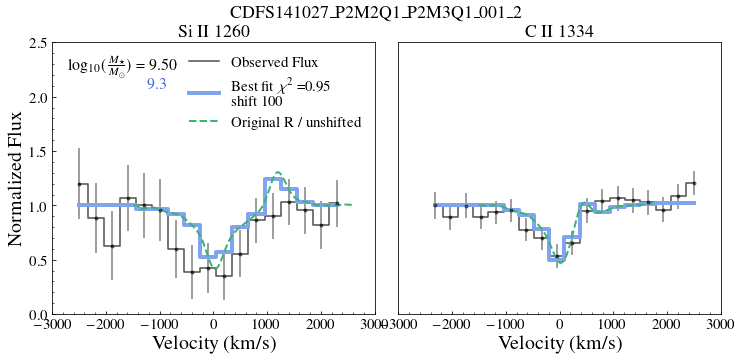

9.5 0.6704290557452104 0.5290936423283168 0.8117644691621041


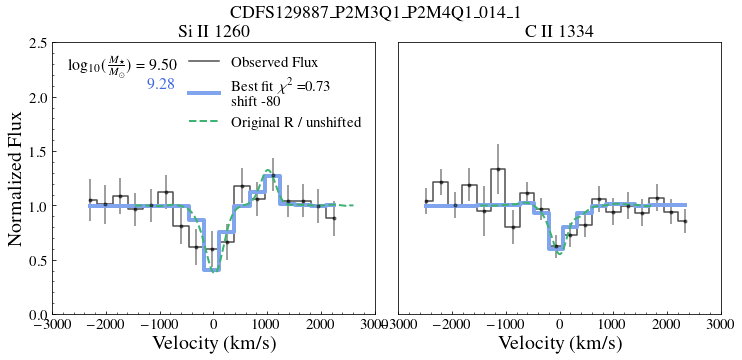

here 1
here 1
8.9 1.4106441269590757 2.481344643458764 0.3399436104593871


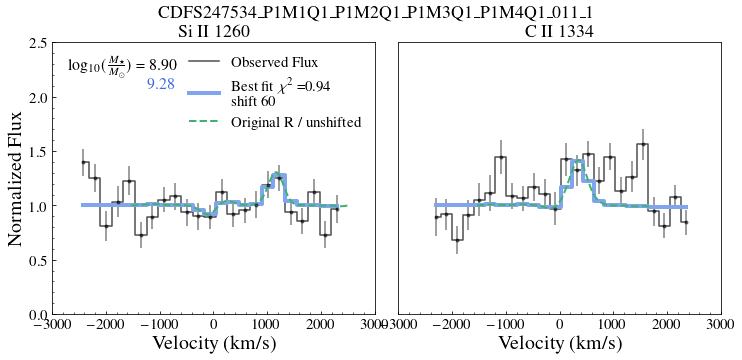

here 1
here 1
9.4 0.6305530776751024 0.14964581228729132 1.1114603430629135


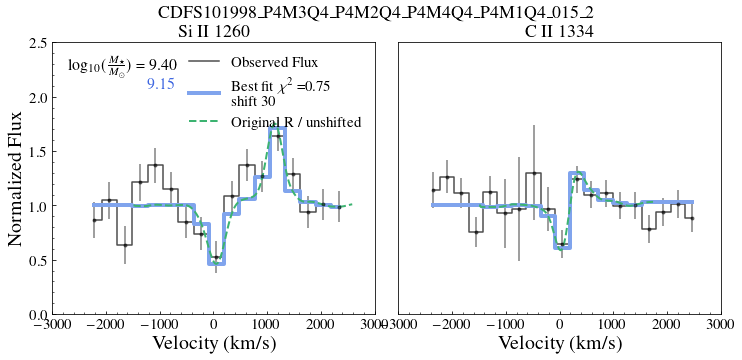

9.5 0.844203470524342 1.0091950477443137 0.6792118933043702


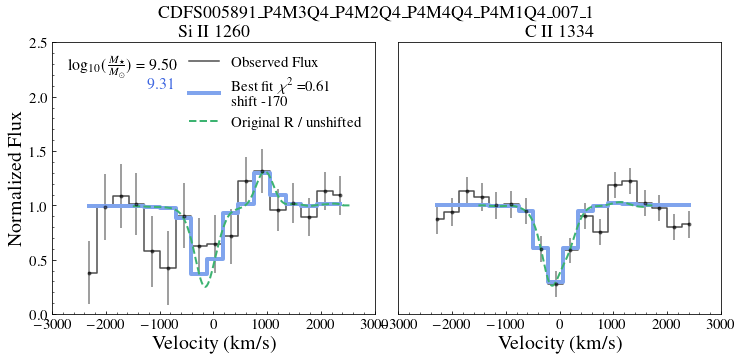

here 1
here 1
9.2 0.9900488924316426 1.1854981886895313 0.7728830077006552


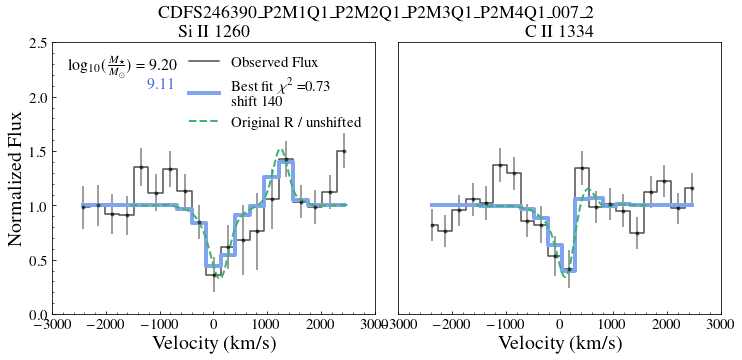

9.2 0.48725394100296693 0.5976103779193804 0.37689750408655337


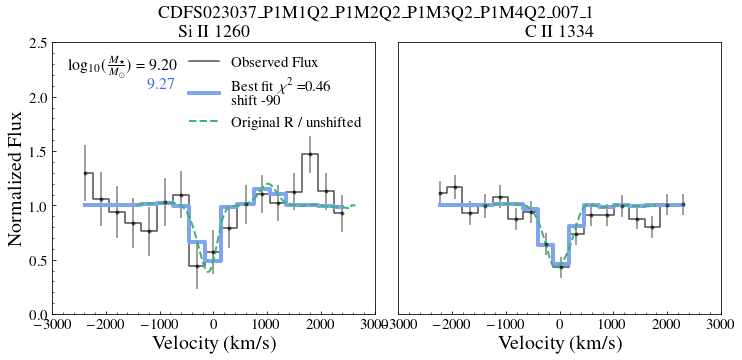

9.3 1.6706180615719326 2.109826833374669 1.2314092897691962


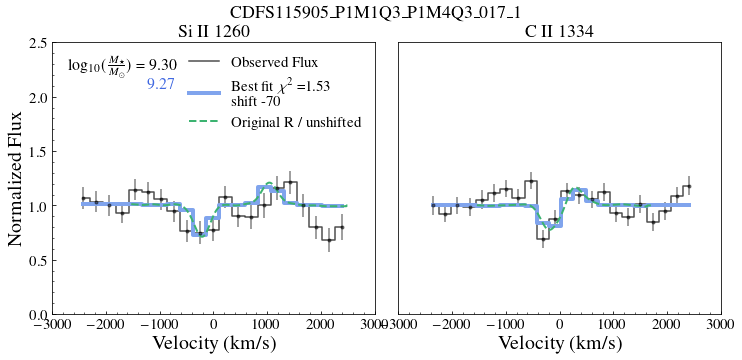

here 1
here 1
9.3 1.5071126213547459 0.7176334399168508 2.296591802792641


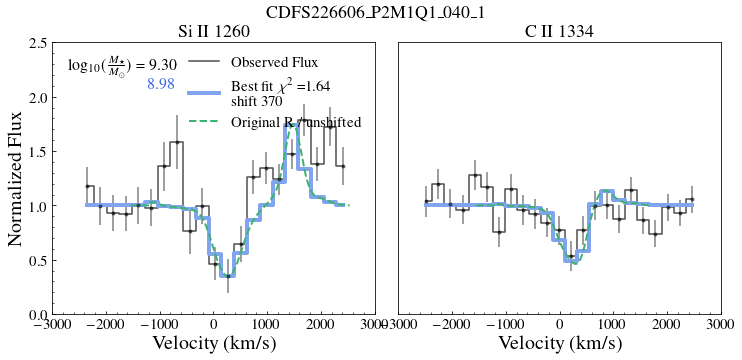

9.9 0.8032118901705829 0.4797856787645582 1.1266381015766074


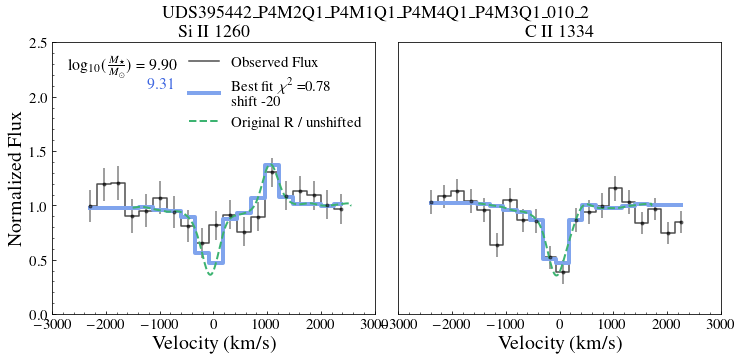

here 1
here 1
9.0 2.5794663090256904 2.8765608074617774 2.2493613107633714


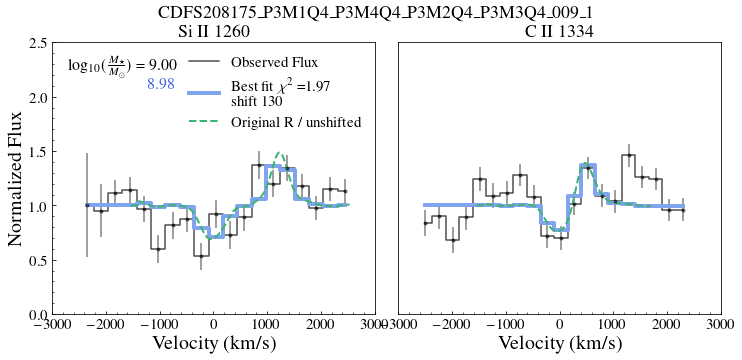

10.6 3.0676382404317613 3.6802242620049808 2.3937936167012204


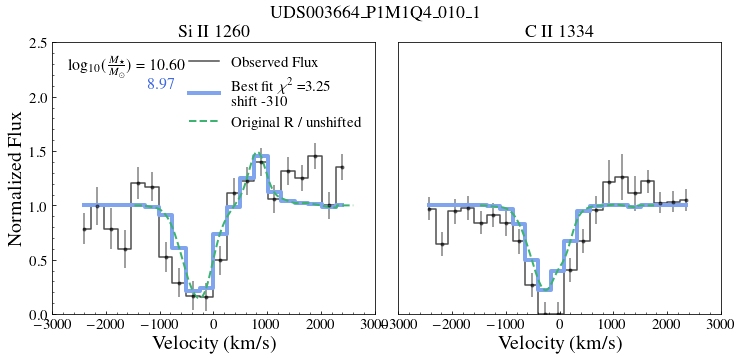

9.5 0.838869749589229 0.8024243496286352 0.8789596895458821


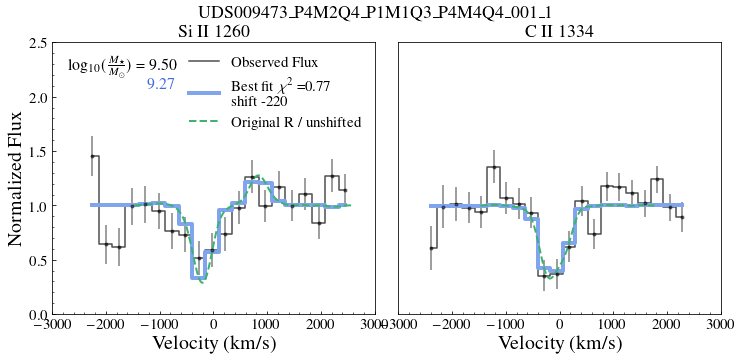

here 1
here 1
10.6 3.346359091313925 4.015645839113383 2.6770723435144665


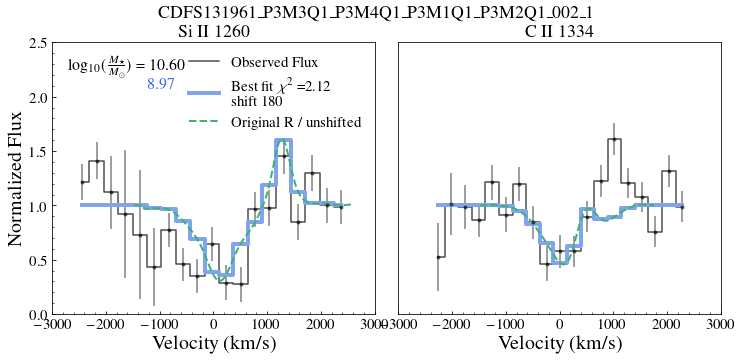

here 1
here 1
10.0 1.7988739311823418 2.971752158027187 0.625995704337497


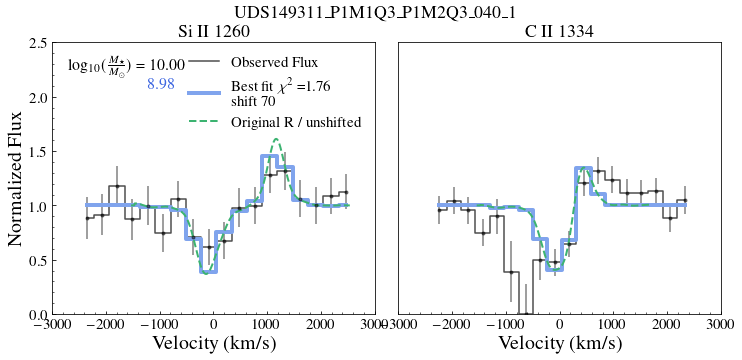

here 1
here 1
9.7 1.7145229345836777 2.763043696968813 0.6660021721985425


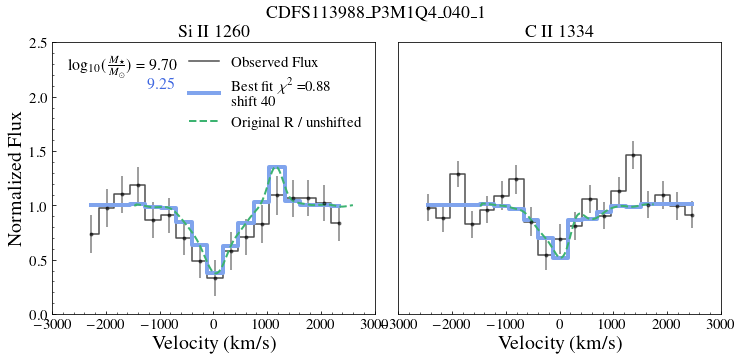

8.7 0.8312615356155417 0.18337523497523733 1.4791478362558461


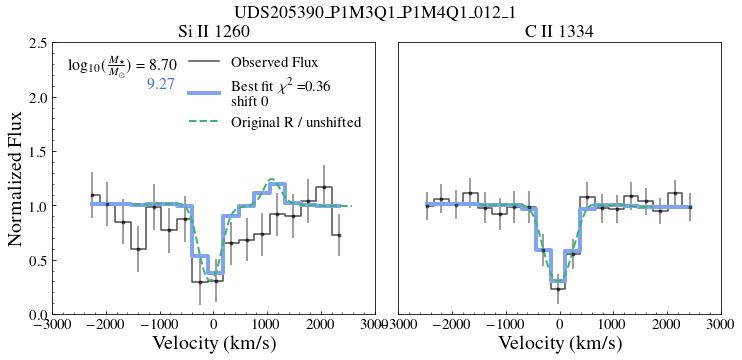

here 1
here 1
9.8 1.0013309115171476 0.5686244511562873 1.4340373718780077


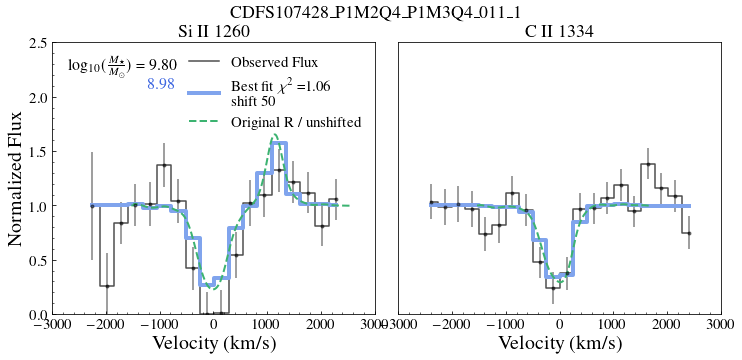

9.8 1.1801191169425471 1.214274869793836 1.1459633640912583


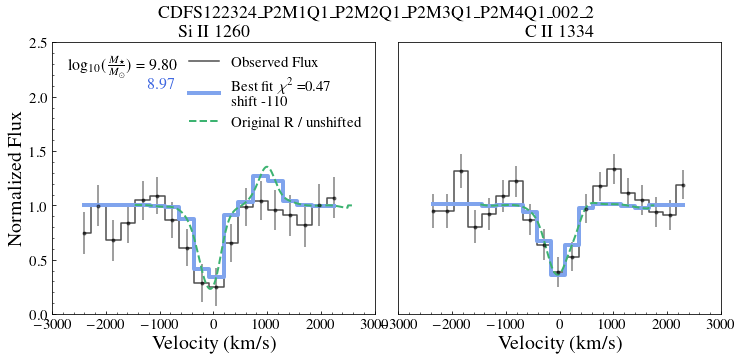

here 1
here 1
9.6 0.9549831326922408 0.6367383290663525 1.3085884700543389


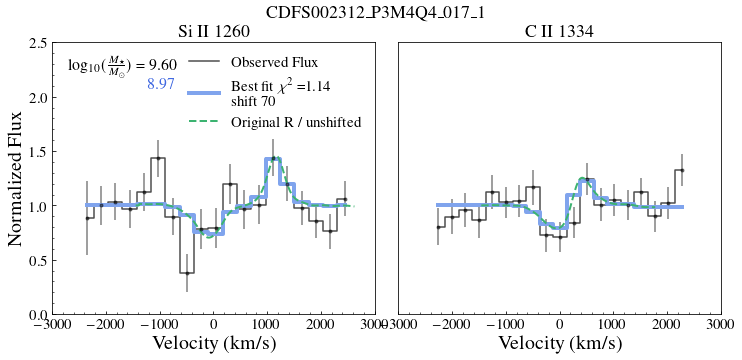

here 1
here 1
9.0 1.2442362706214514 0.7651960981651819 1.7232764430777208


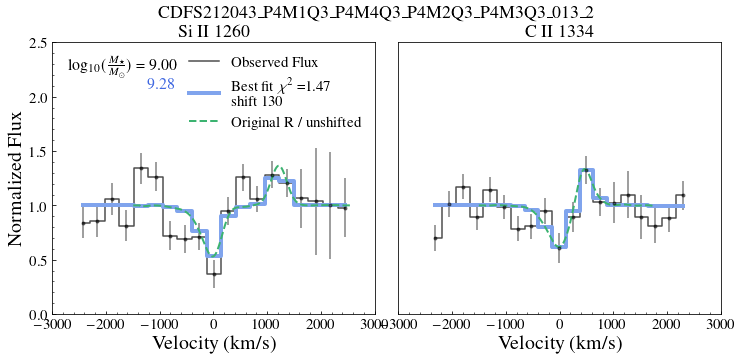

9.9 1.699164891259684 2.6780527931675207 0.6115116669176431


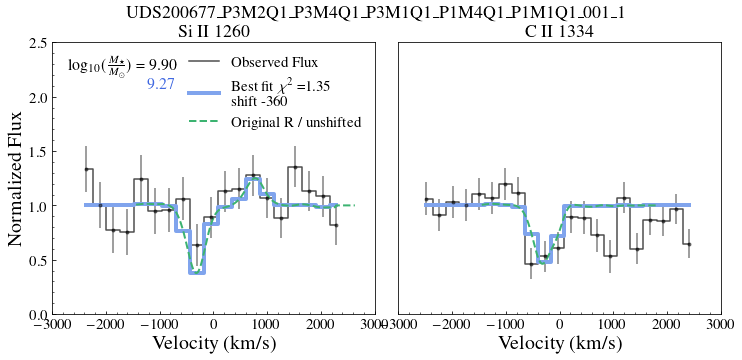

here 1
here 1
9.8 1.574559542634224 2.154844179700717 0.994274905567731


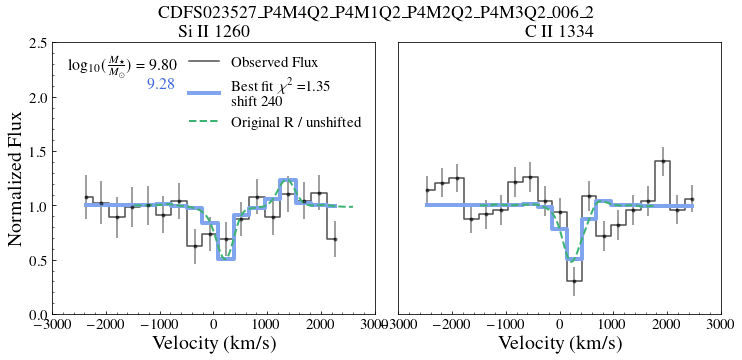

9.7 1.0456888064312297 1.1636919741221061 0.9276856387403534


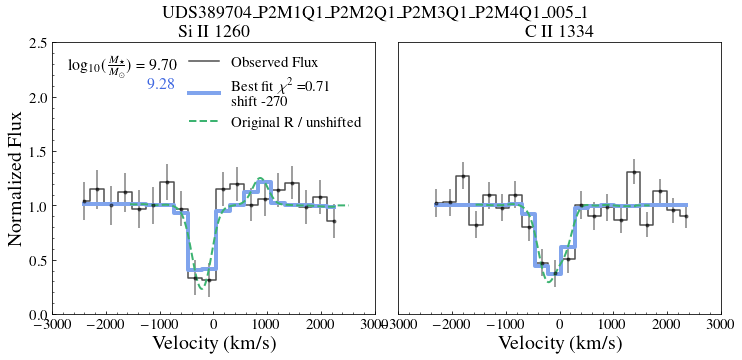

9.6 1.2589011888020056 1.8253975603051518 0.6924048172988592


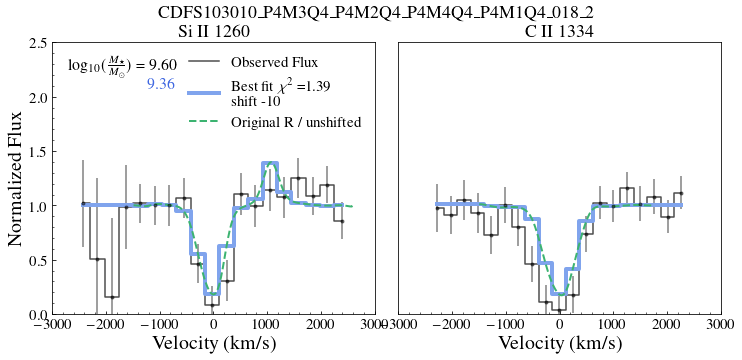

here 1
here 1
9.2 4.623970251186475 5.578693001324827 3.563167195477194
HEEEEL YEEEAH


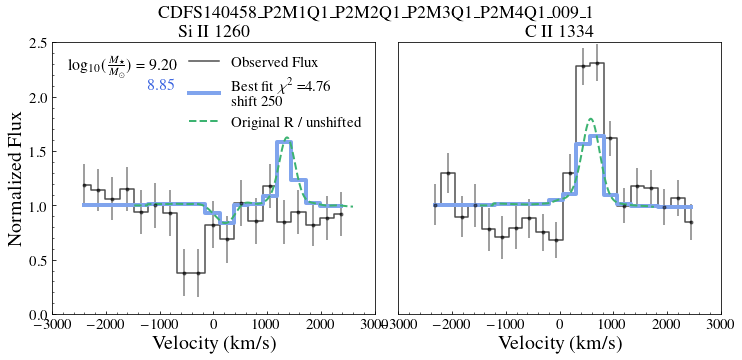

9.3 1.3874175782742306 0.8065978875902498 1.9682372689582117


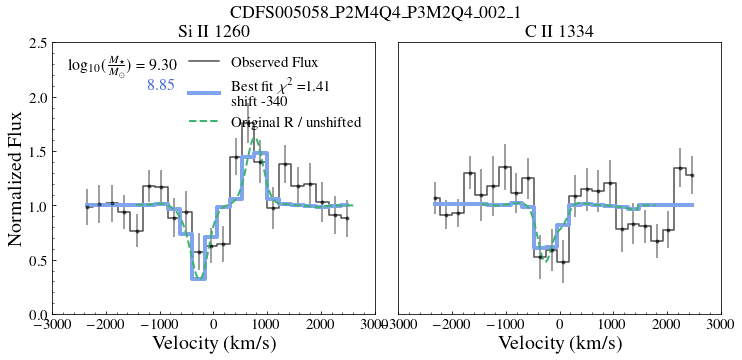

9.6 0.9275420767213088 0.6443642576327174 1.2107198958099004


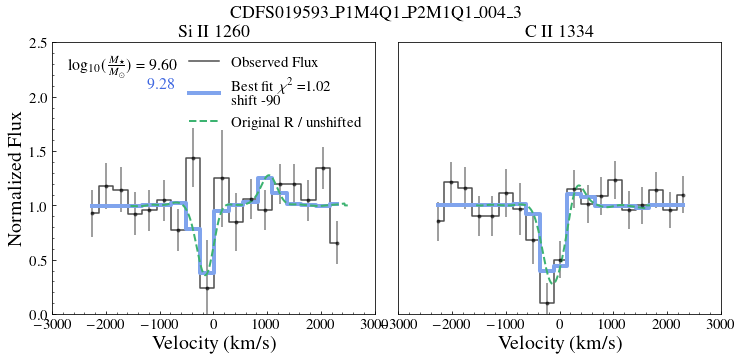

9.8 0.5016699039620723 0.302383538452117 0.7009562694720276


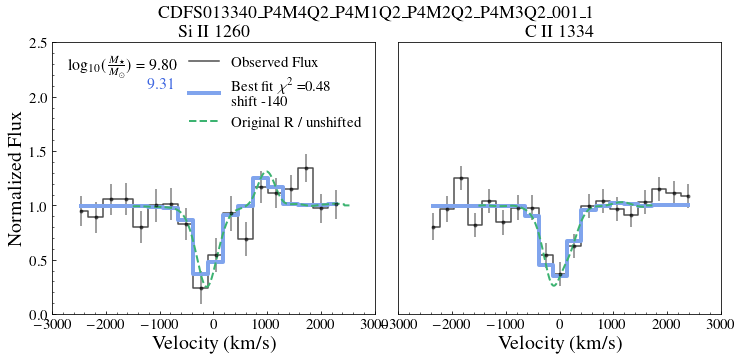

here 1
here 1
9.7 0.7777259926634292 0.520814163543858 1.0346378217830003


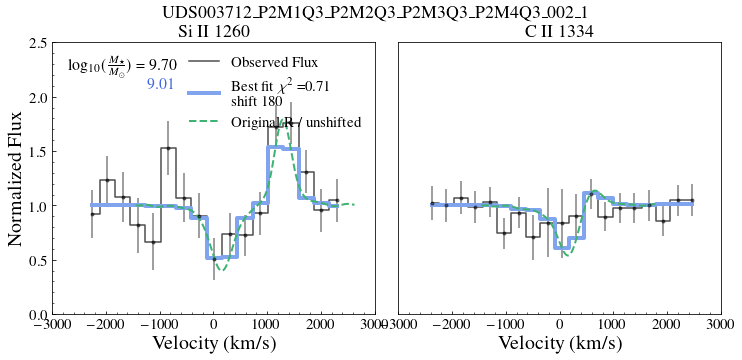

here 1
here 1
9.7 0.7085339351677596 0.8224226883093936 0.5851544525976563


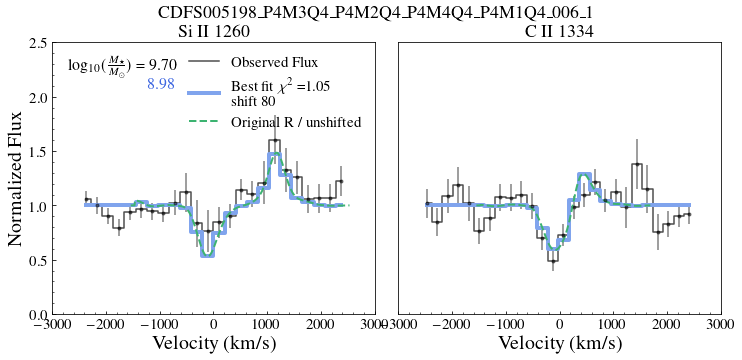

10.0 1.9254561664610836 1.045545215228596 2.8053671176935713


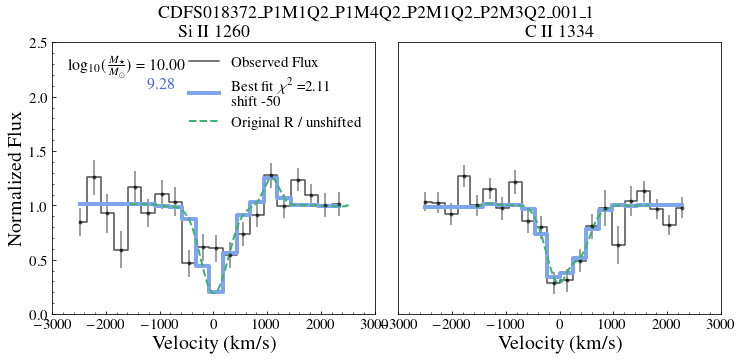

9.7 1.5891345569270834 1.2669529215411355 1.9113161923130313


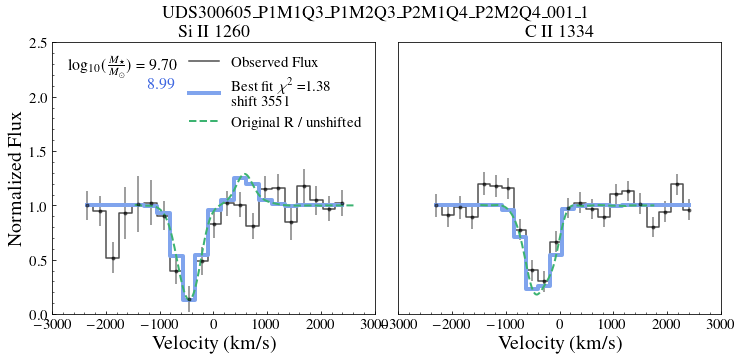

here 1
here 1
9.5 1.2781190543289742 1.31042947788442 1.2422185837118123


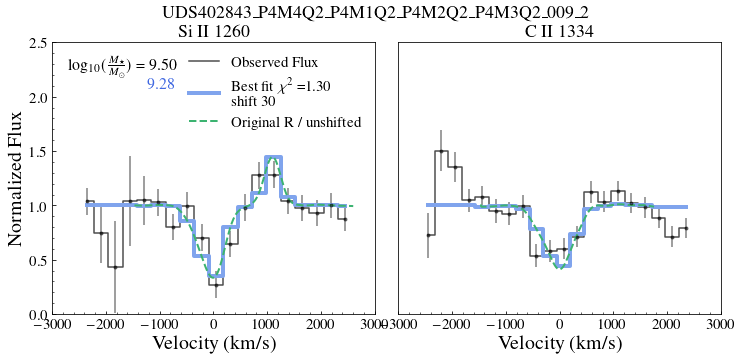

9.5 1.6597861355880759 1.0601092597605382 2.2094899384299858


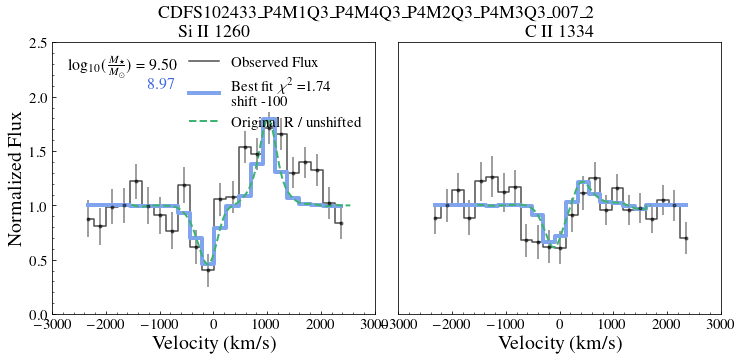

9.7 0.5179869286286726 0.20283613920716198 0.8331377180501831


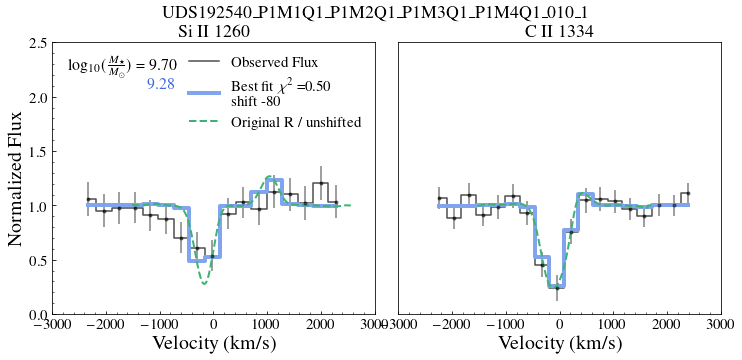

here 1
here 1
9.9 1.087748235240435 1.2393361545228903 0.9361603159579797


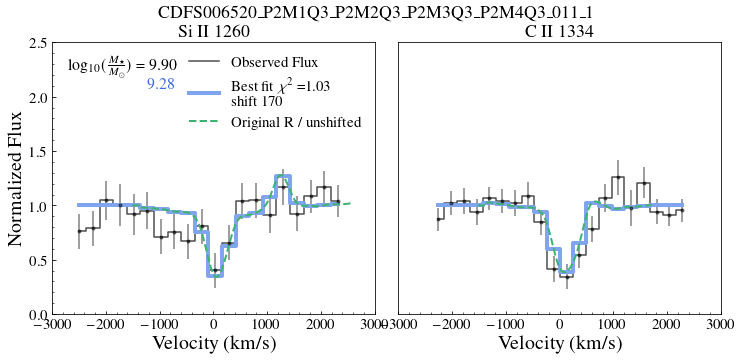

9.6 1.6110365909231568 1.8718582085494058 1.326503917149067


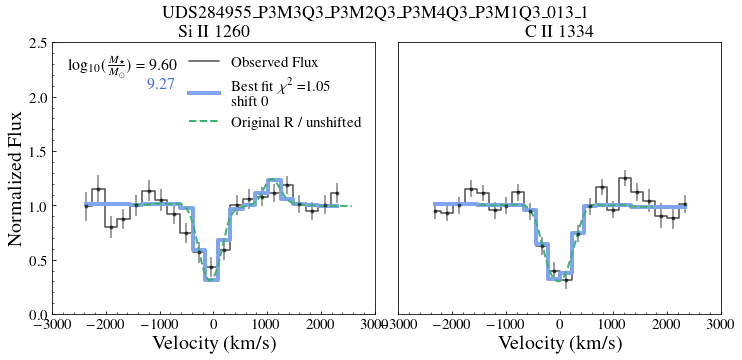

9.3 1.8956446956603514 2.354227574554326 1.3953724641396519


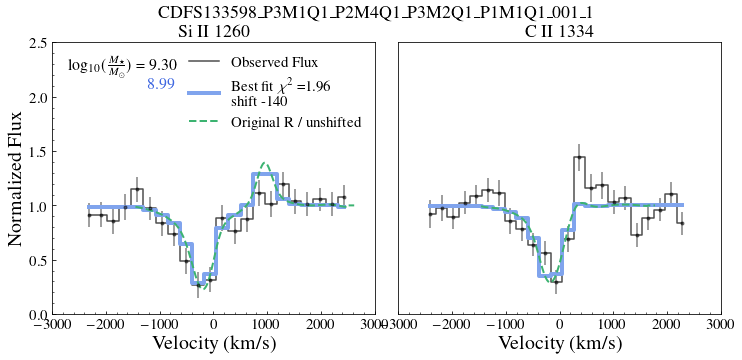

9.6 1.9784388487206466 1.7231095643279022 2.2801916393666173


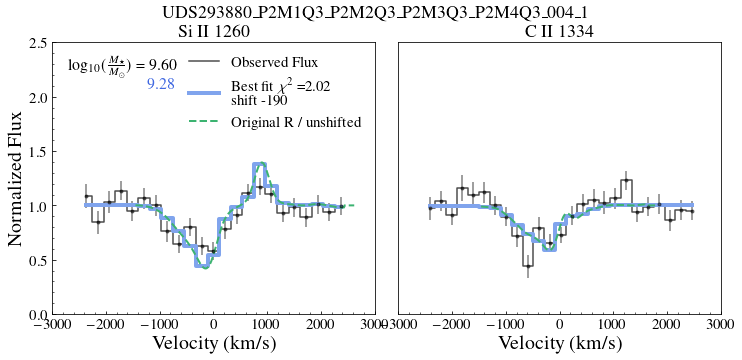

9.6 1.179782618925919 1.3502278008210795 1.0093374370307586


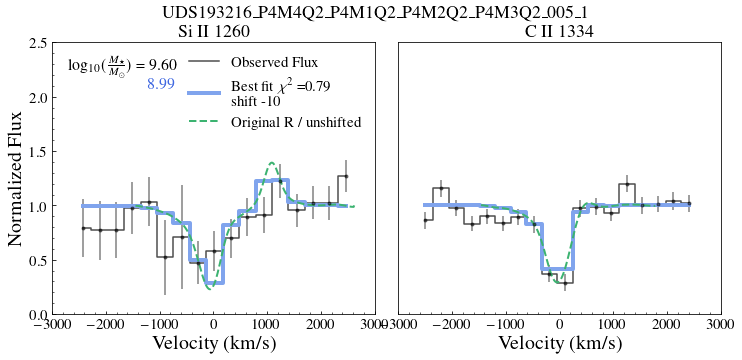

9.6 2.066407233324716 2.190174233636225 1.942640233013207


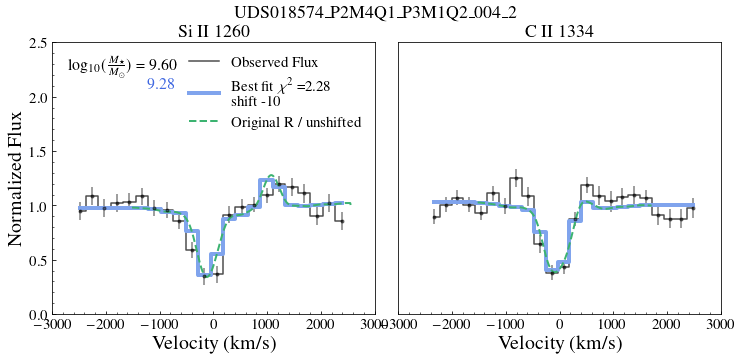

10.4 1.6416315588203443 0.6799810339764599 2.6032820836642285


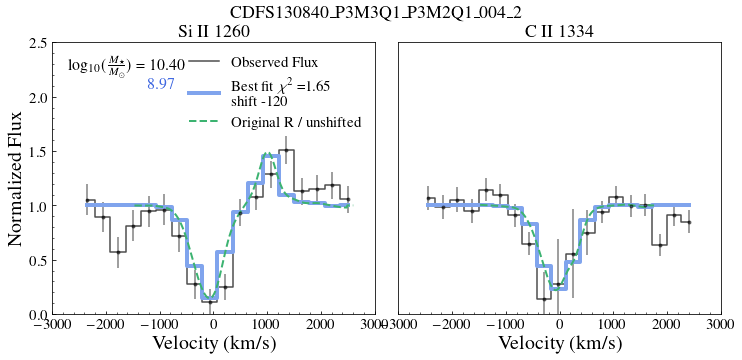

9.6 3.1159790857876235 1.6269903251432905 4.604967846431957


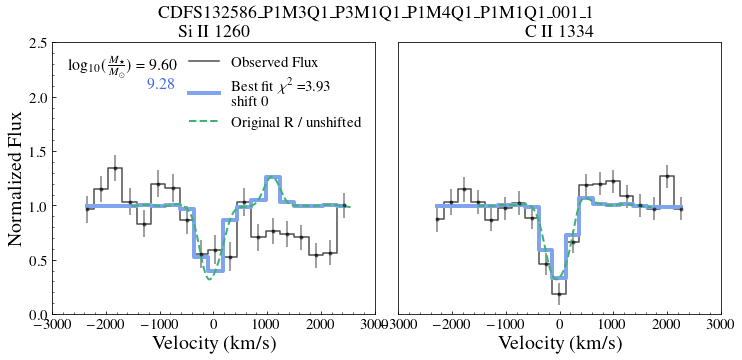

here 1
here 1
8.9 1.3839647357170617 1.9213875563191904 0.7868282683813629


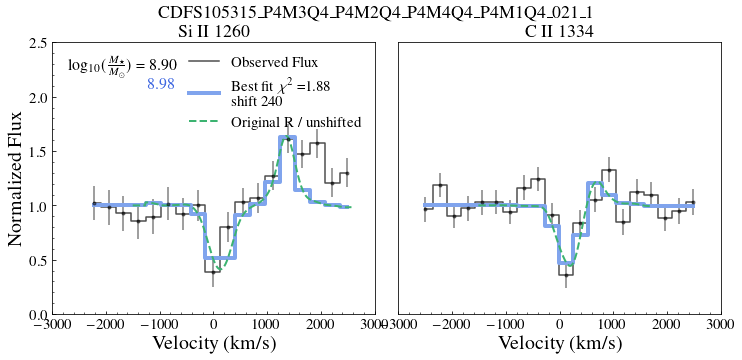

10.1 1.8831459430623327 1.568188173417601 2.1981037127070646


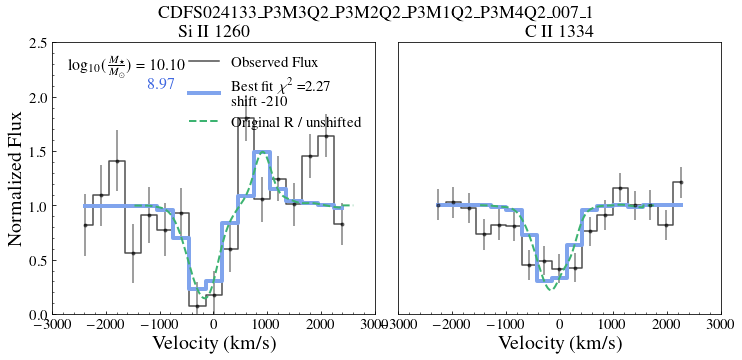

9.5 2.000293690466004 2.1757814223936816 1.8248059585383274


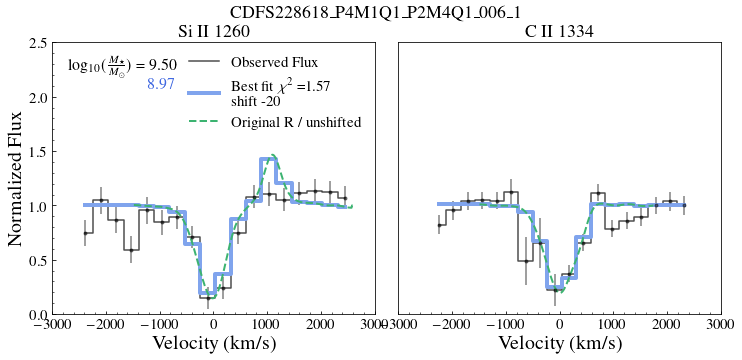

9.6 1.1091269013085532 0.9948669720145172 1.2348128235319926


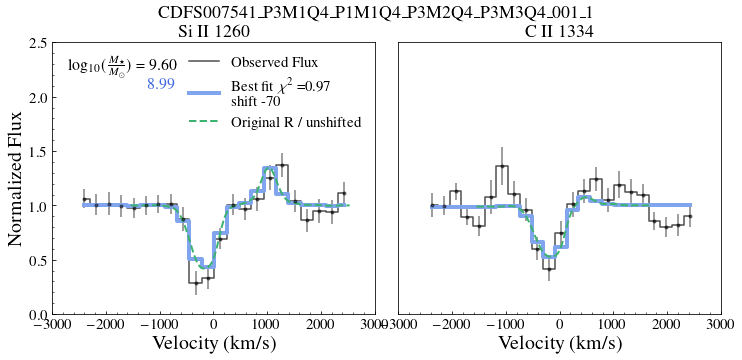

here 1
here 1
9.3 0.4385119371242682 0.31680182349154107 0.5737453967161872


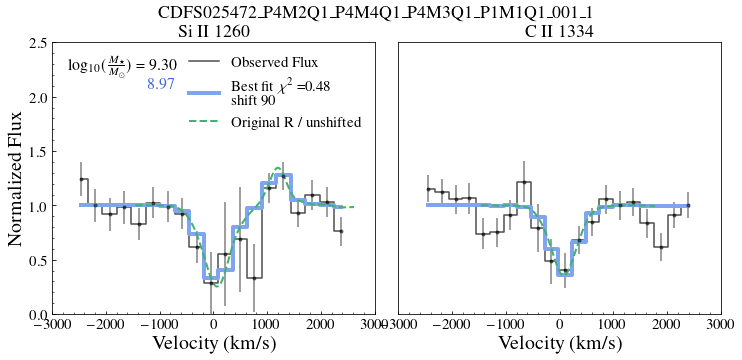

9.4 1.7900318790498047 0.5871136608955178 3.1266076769990128


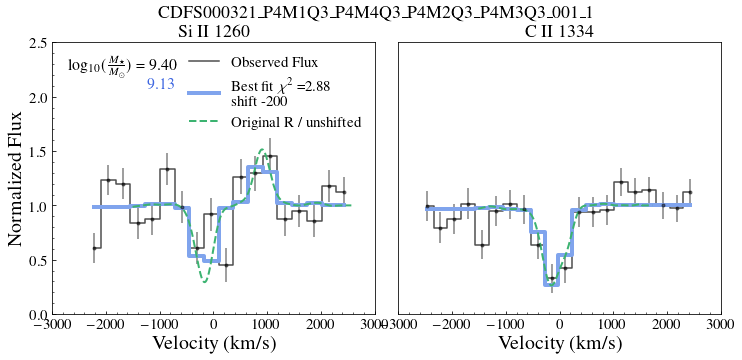

10.0 1.4837008592074536 0.7368130416630781 2.3052774585062665


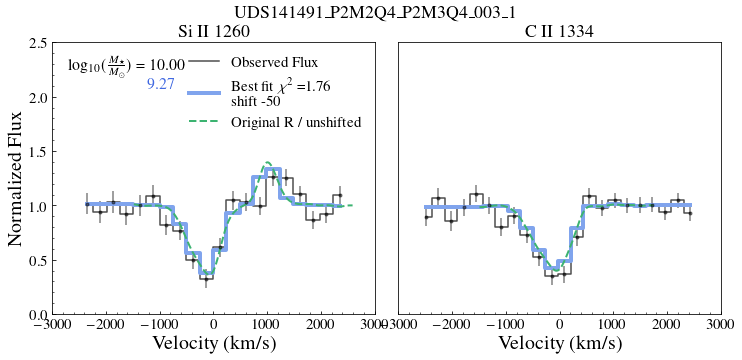

here 1
here 1
9.4 2.499370554178772 2.9866581076086547 1.9037968777644716


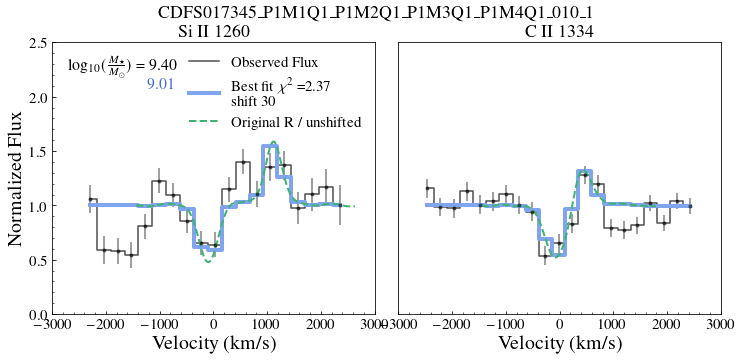

here 1
here 1
9.1 2.8209484530119817 0.9865755365182374 4.655321369505726


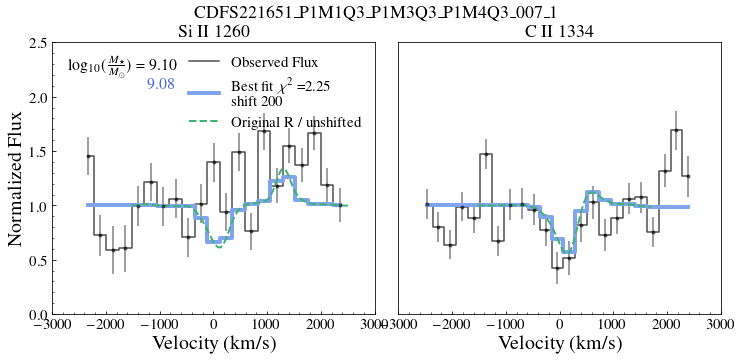

10.2 1.2353059054892592 0.2722195119526704 2.305401898307691


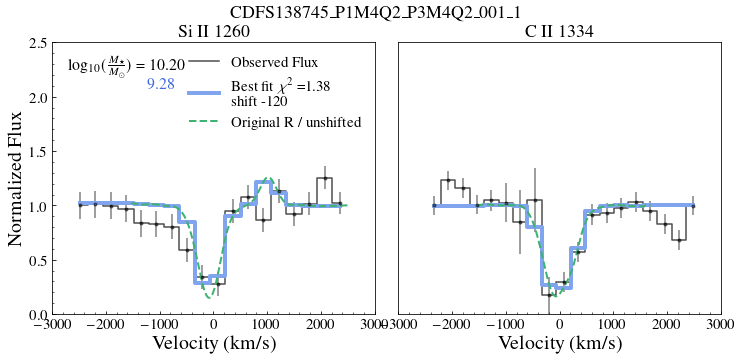

here 1
here 1
9.1 0.8255827704613126 0.6790990789980708 0.9720664619245546


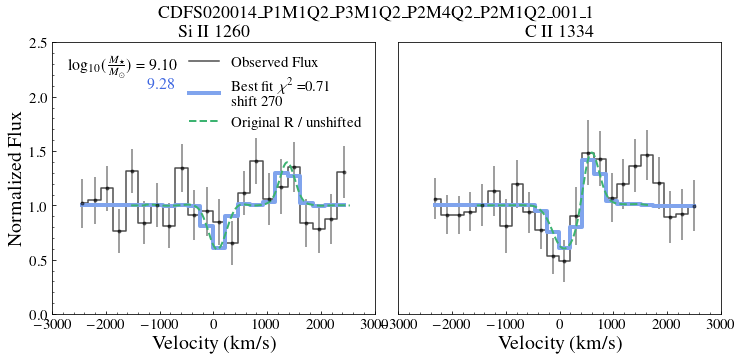

9.6 0.6275667760845801 0.3296719512301156 0.9585610259228741


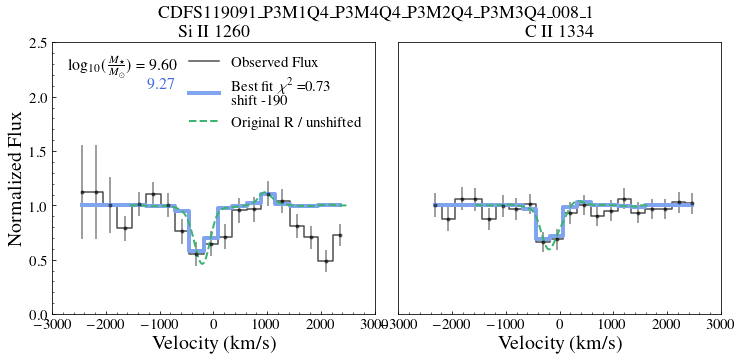

10.5 1.4493034801081557 1.1505917566920698 1.7480152035242411


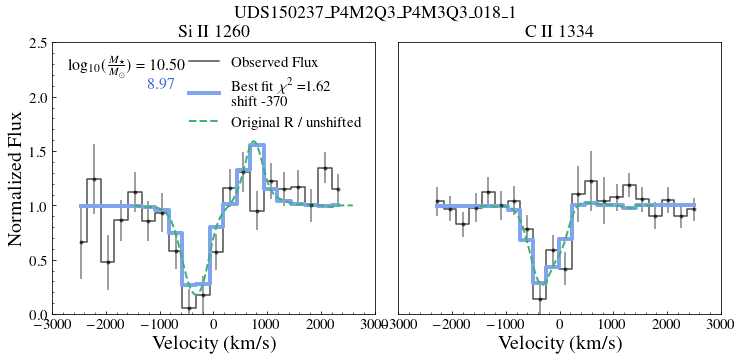

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


9.2 1.4533578860248182 2.7452315624913233 0.0


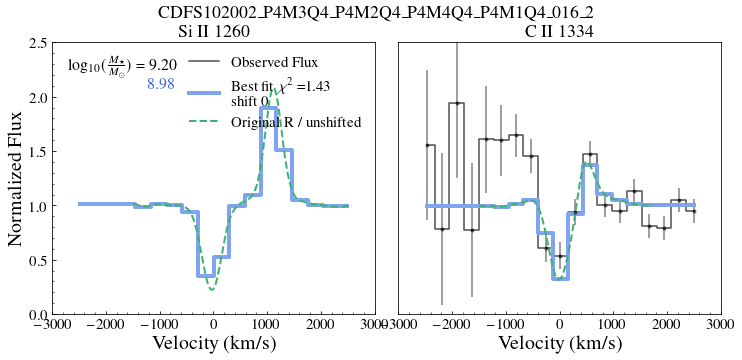

9.5 1.283730810459476 0.7139269725107708 1.8535346484081812


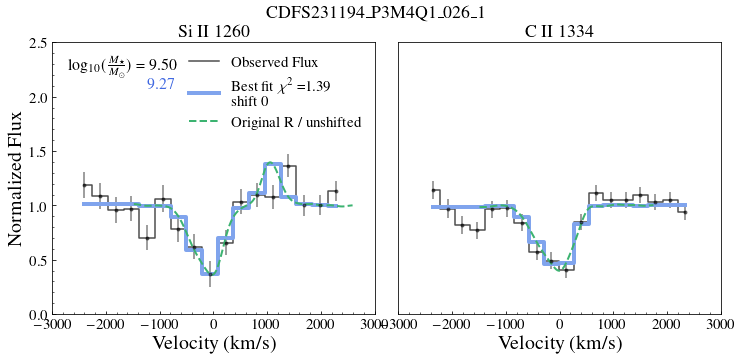

10.0 1.3347699651110507 1.0076014117274 1.6982905799817736


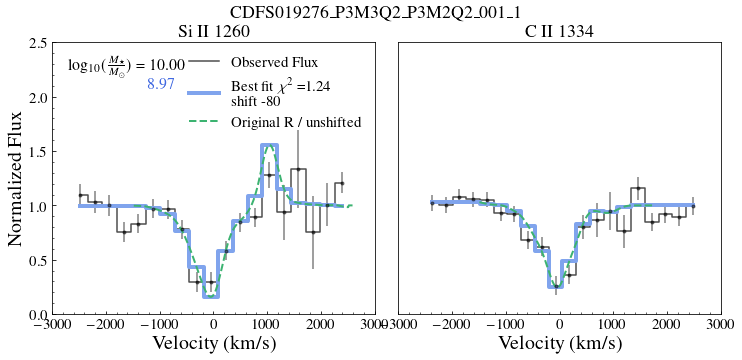

10.0 2.322470368303803 2.504676802965092 2.123699712309669


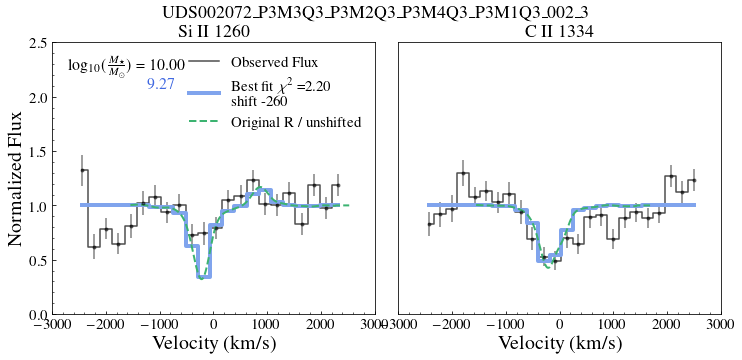

9.0 1.1925408082705244 1.8806780315244 0.5044035850166488


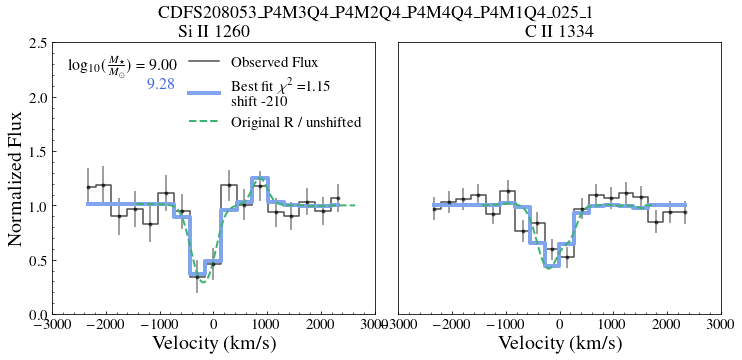

9.7 1.4084585789851407 1.3620310749149498 1.4548860830553314


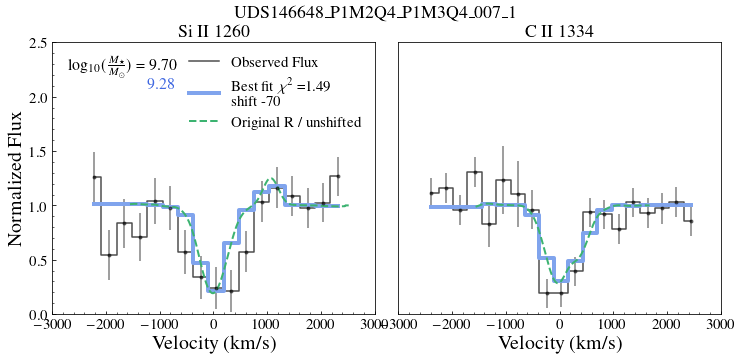

9.5 0.9578166653724374 1.07124031511744 0.6553535993857641


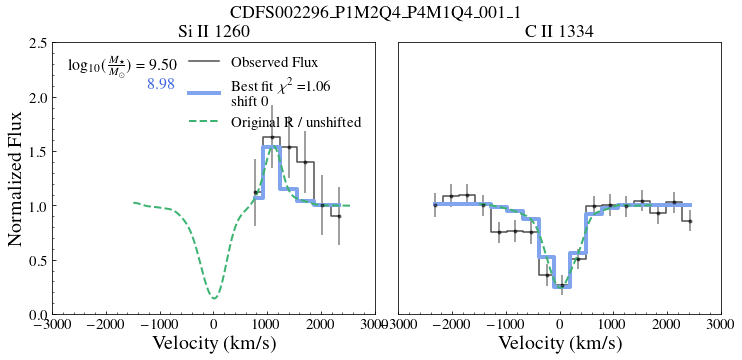

9.7 0.8220084800105971 1.0251343497132113 0.6004166221532


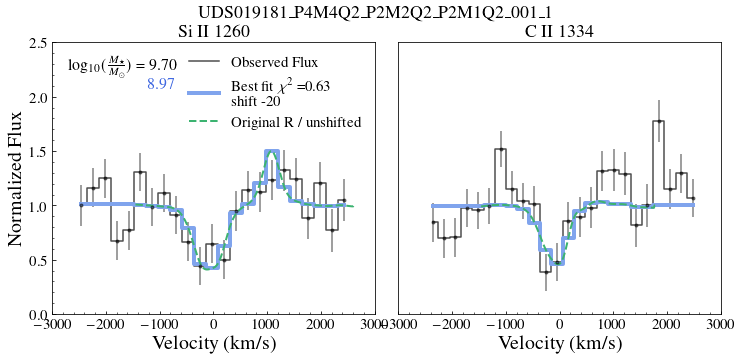

here 1
here 1
9.6 0.340221662962342 0.44768360582912853 0.2327597200955555


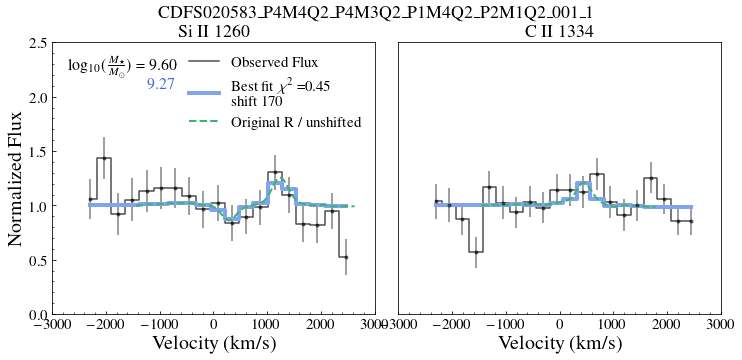

here 1
here 1
9.3 2.9247478725504923 2.9319303534653467 2.917565391635638


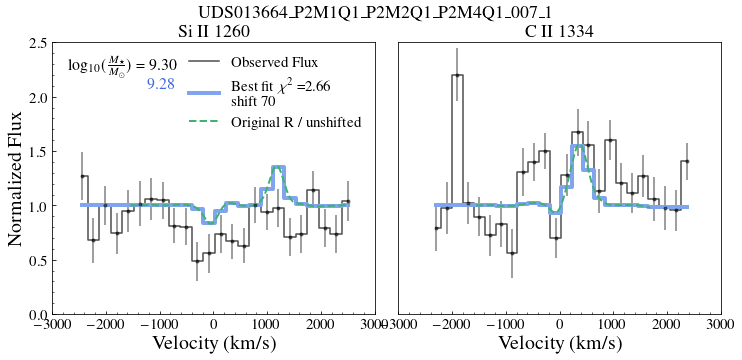

here 1
here 1
9.5 1.7055780603761161 2.0096100499180336 1.4015460708341985


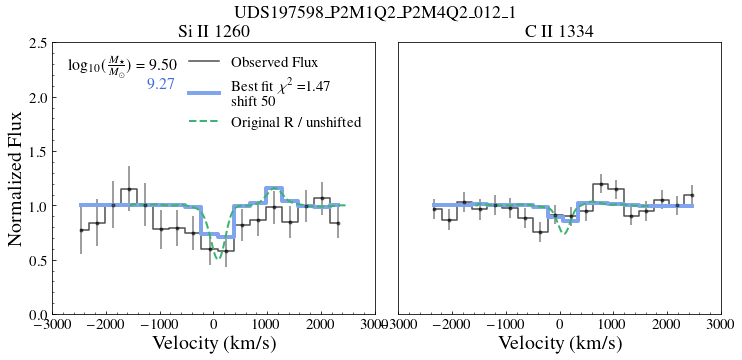

here 1
here 1
9.7 1.4968779535839114 0.42053647435930774 2.573219432808515


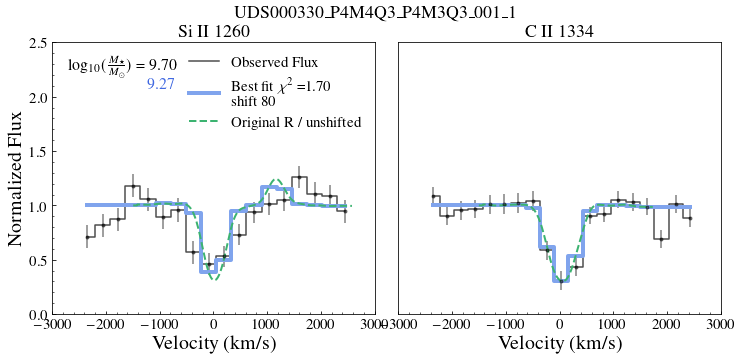

9.4 1.1381054923868572 0.5278104444804617 1.816211101171741


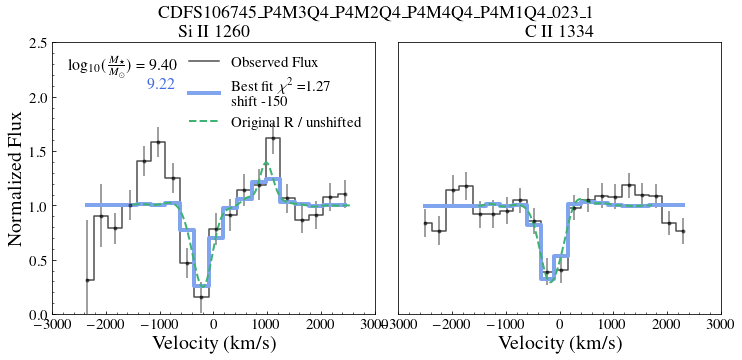

10.1 1.841791467215997 2.151212145971809 1.532370788460185


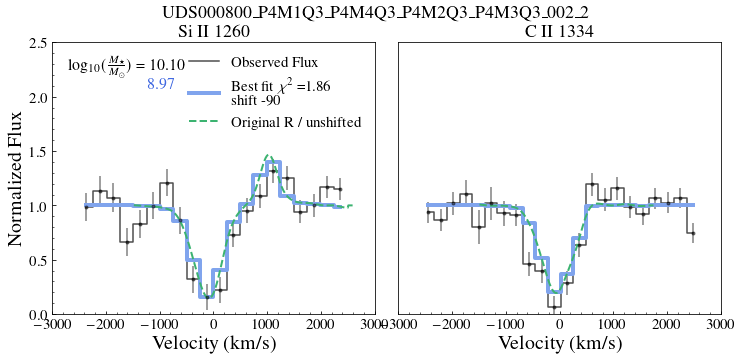

9.9 1.0107652302923869 1.3358270326536479 0.685703427931126


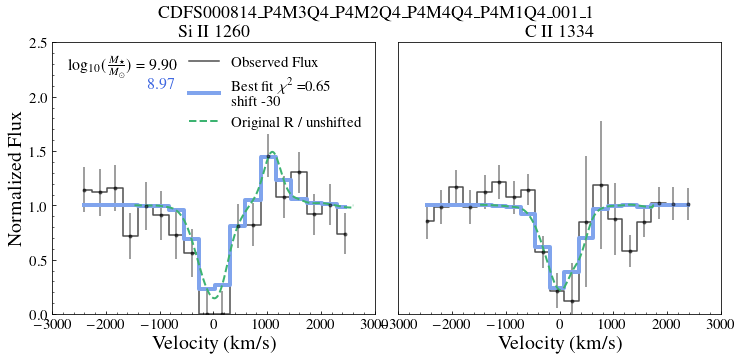

9.6 1.9474471755507248 2.120220515503741 1.743260501060797


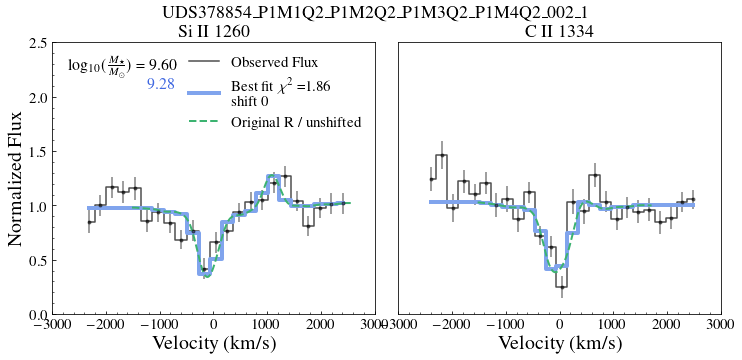

9.6 0.833322201319838 0.79394351503337 0.872700887606306


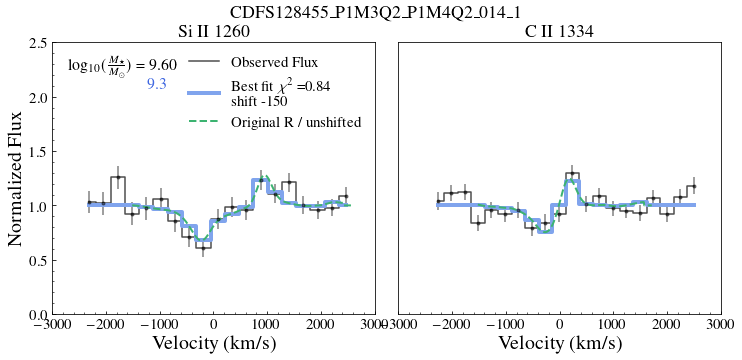

9.3 1.1130355149283344 1.3509781886235133 0.8486547663781355


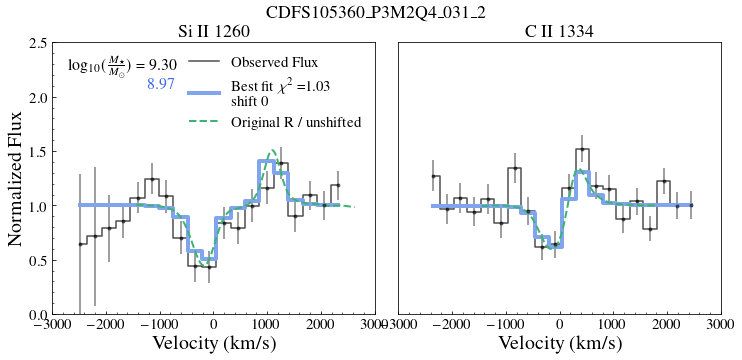

here 1
here 1
9.5 1.2634003128554043 1.776232059786065 0.6935872607102256


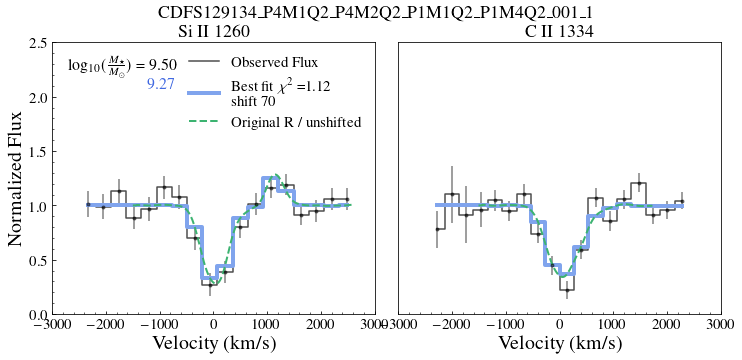

9.6 0.6659830878858181 0.7795195519604177 0.5524466238112183


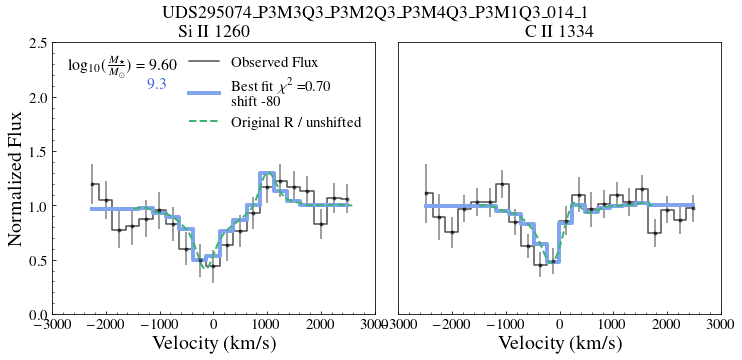

here 1
here 1
9.5 0.22610118884152305 0.21277921197511918 0.239423165707927


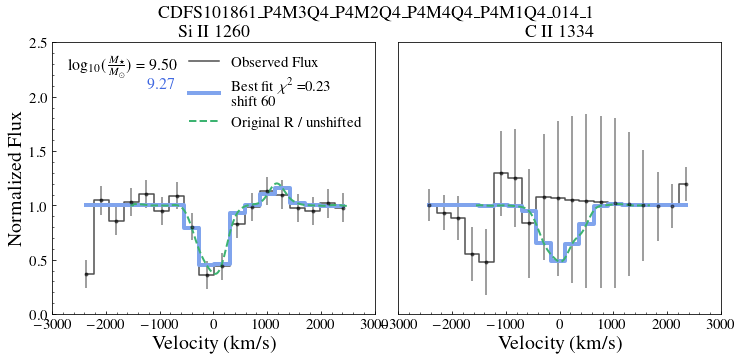

9.3 1.8811721659806586 2.3667581375083757 1.3072978359933565


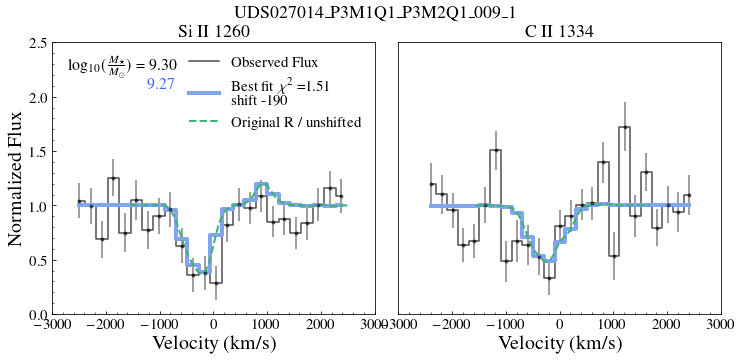

10.5 4.416234021399743 0.841515661903453 7.990952380896033
HEEEEL YEEEAH


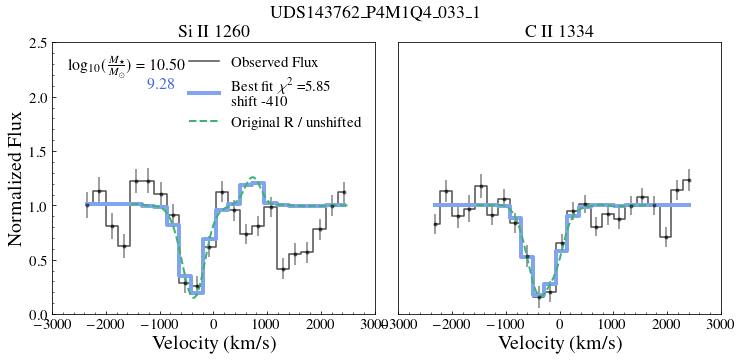

here 1
here 1
9.4 0.8558076214874383 0.92736780116996 0.7842474418049167


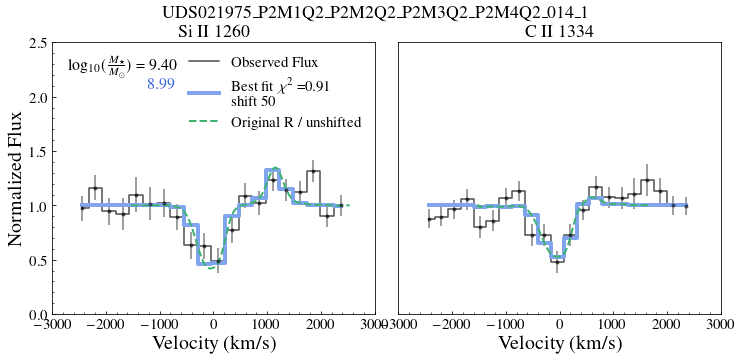

here 1
here 1
10.0 1.2133367177104704 1.1528542340956625 1.2738192013252785


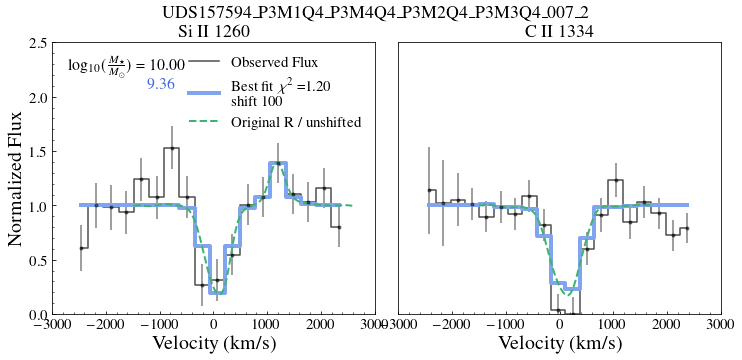

here 1
here 1
9.8 2.383763023929366 1.5190802299798523 3.34452168387327


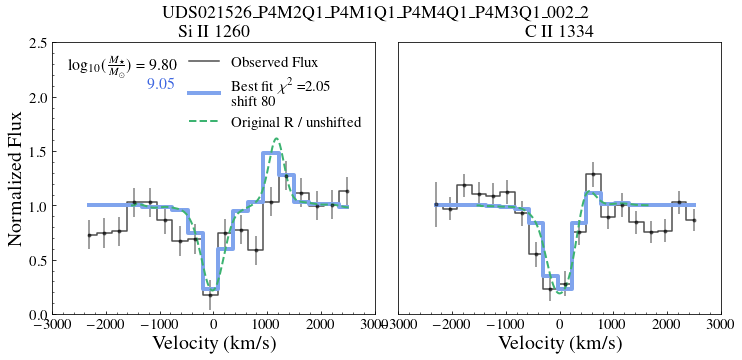

10.4 2.247735635483027 3.4065596302236085 1.088911640742446


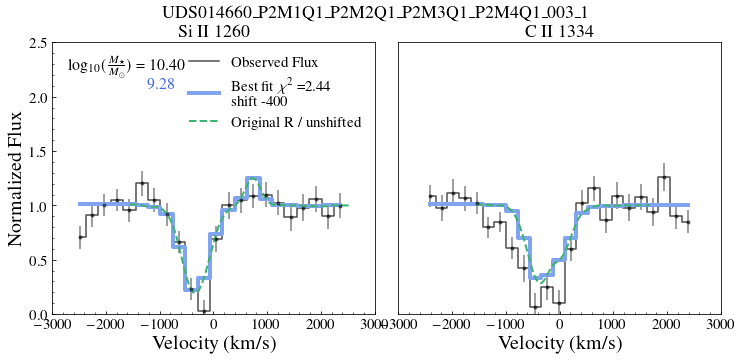

here 1
here 1
9.4 1.3989003046344353 1.280648663061963 1.5171519462069076


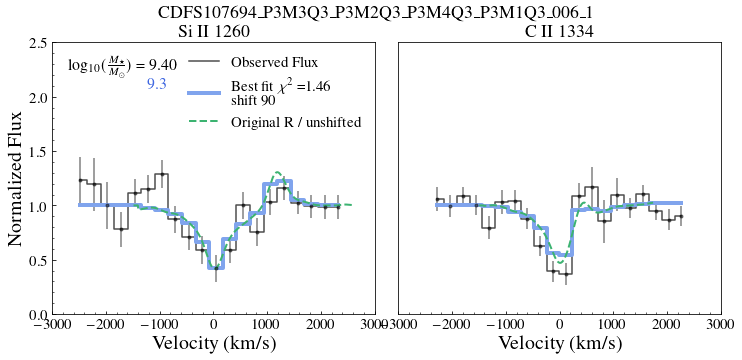

8.9 1.1126846395134387 0.7894695086274296 1.4682212834880486


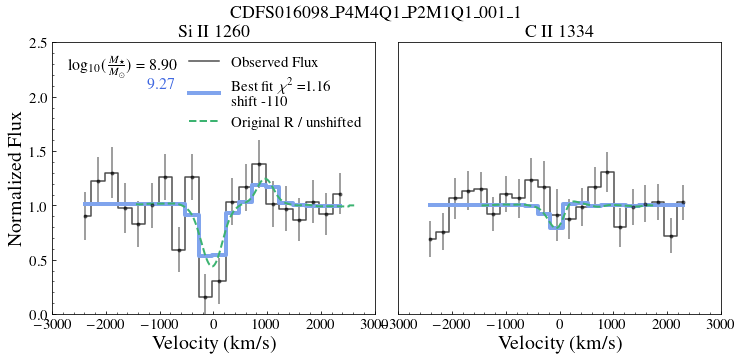

here 1
here 1
9.8 1.273258501782925 1.4403241051614106 1.1061928984044394


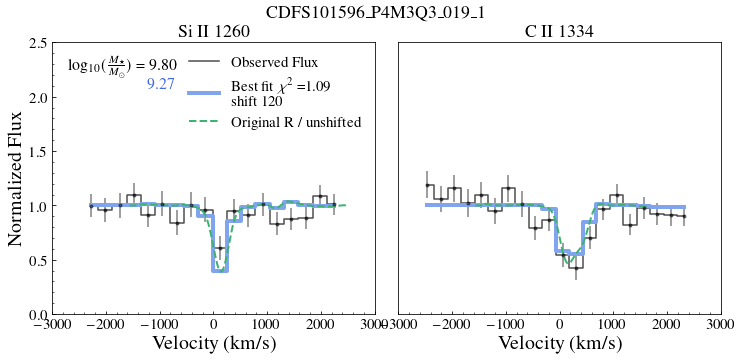

10.4 0.5440506397790227 0.6631384003252401 0.4130541031781837


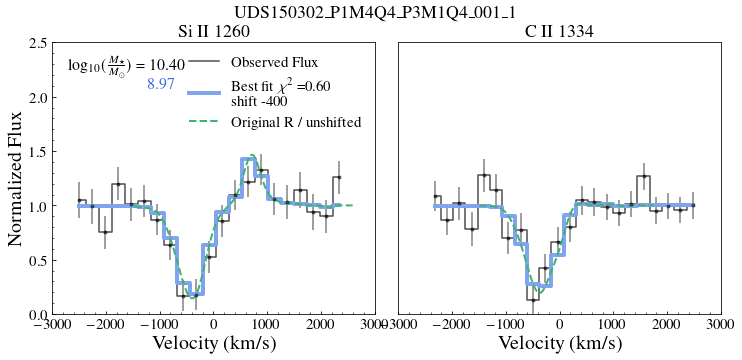

9.7 1.0280331727868566 0.7719087779890537 1.2841575675846597


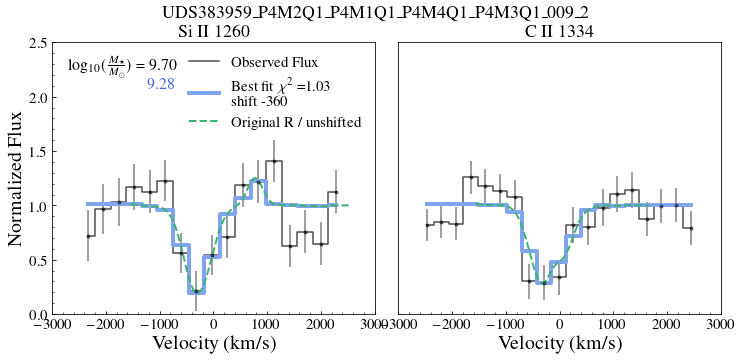

here 1
here 1
9.5 1.0415970514119632 1.1803681566486006 0.8902103911538134


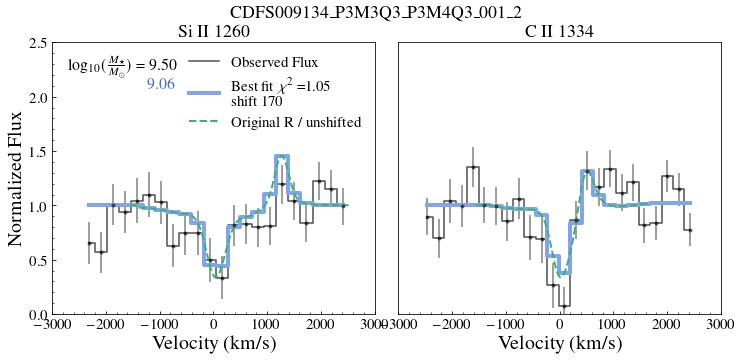

9.1 0.5837405811030009 0.6496623724700921 0.5112266105992006


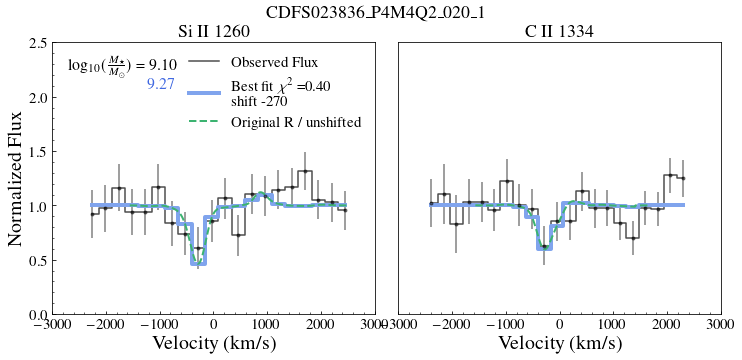

9.6 3.119486290343778 1.9371084099824236 4.400395660735246


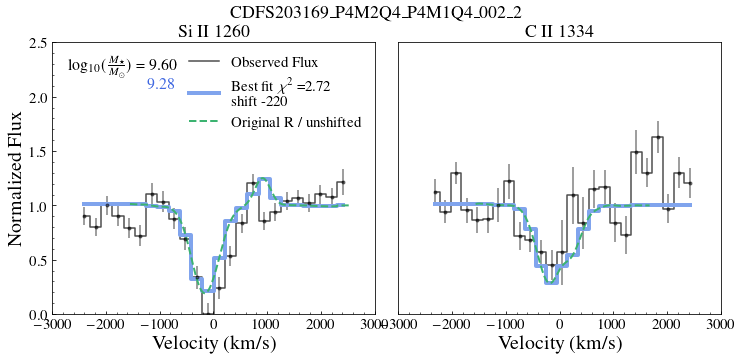

9.9 0.849068589545773 0.7844038198037502 0.9281033081193565


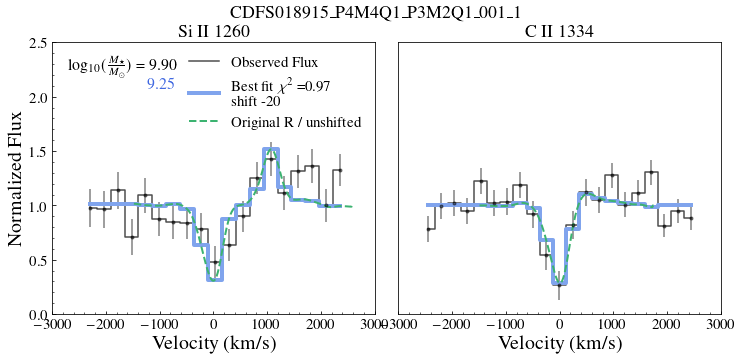

here 1
here 1
9.9 8.355919819372438 0.7453050880383705 15.966534550706507


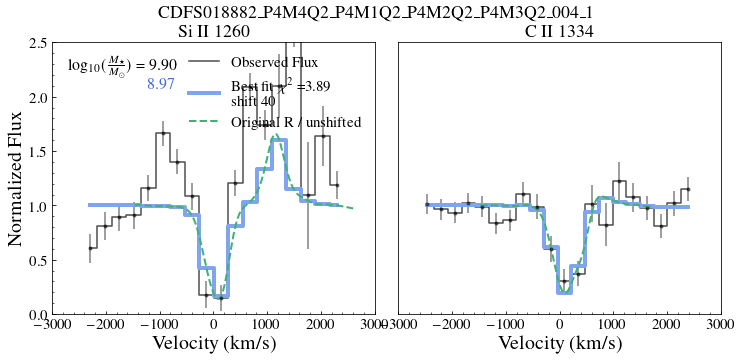

9.8 0.5507728433121453 0.5518461923855537 0.5496994942387369


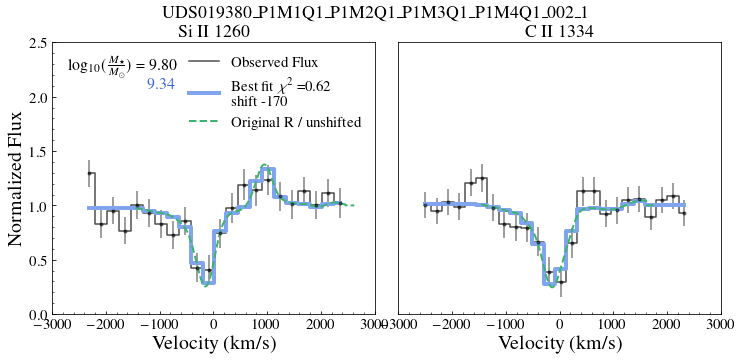

9.2 1.5646592557235028 1.7743606663302316 1.3549578451167739


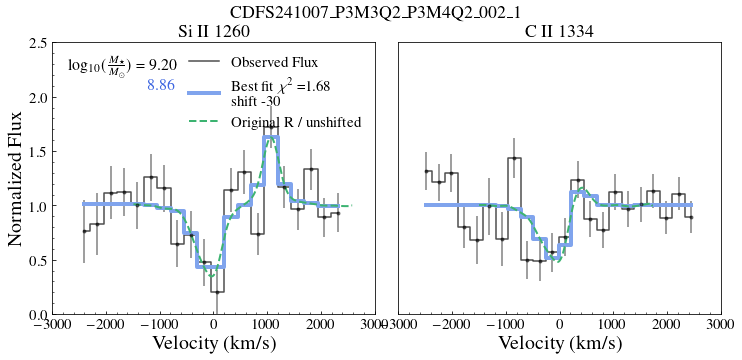

here 1
here 1
9.7 0.4170081731611257 0.21347997807163432 0.6431506121494495


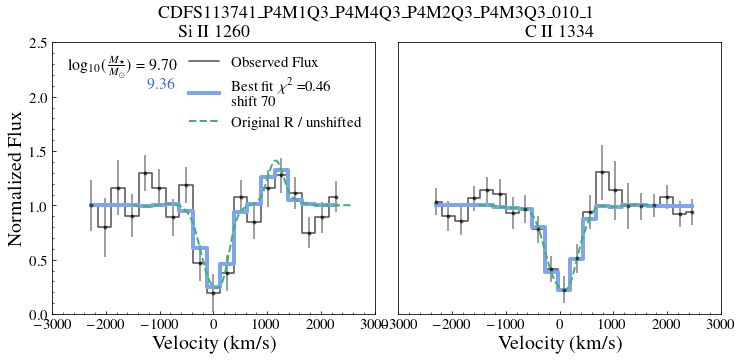

9.9 1.3660301108695347 1.7476309910788366 0.9844292306602329


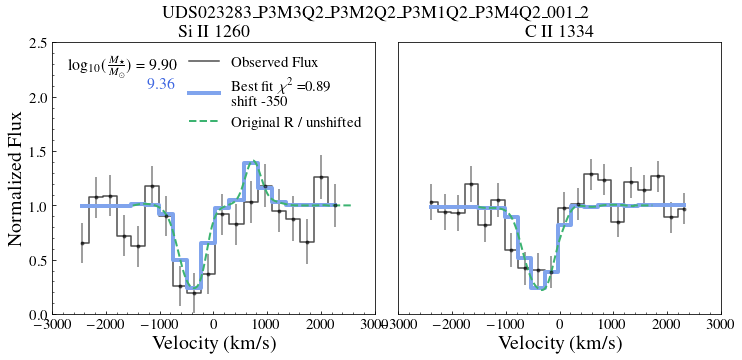

10.2 2.0272610008899212 2.3555020469019574 1.6990199548778846


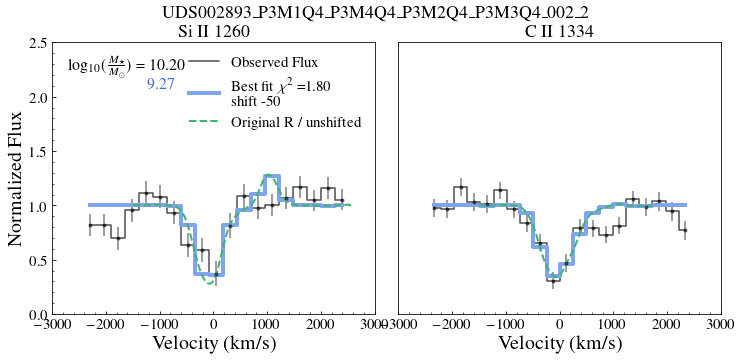

here 1
here 1
9.9 2.2625063564720396 3.3444857965628443 1.0603069785933674


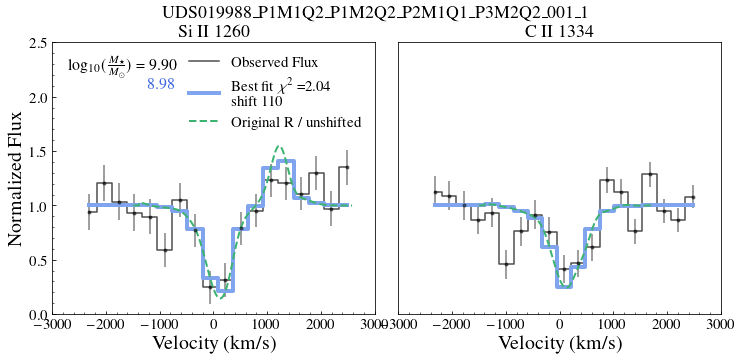

10.0 1.6406132282685628 1.0404786972951248 2.2407477592420006


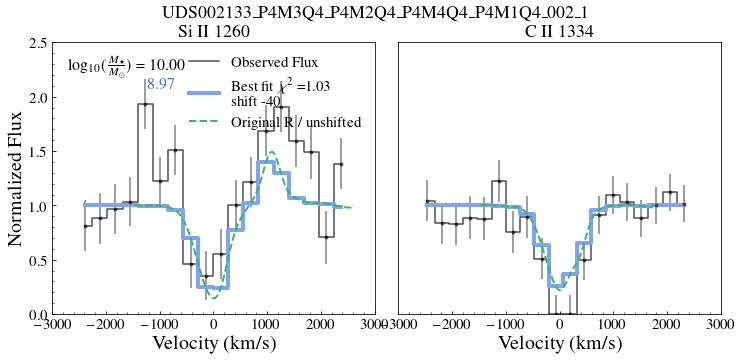

9.5 0.5537402281126338 0.6924559007323497 0.4150245554929179


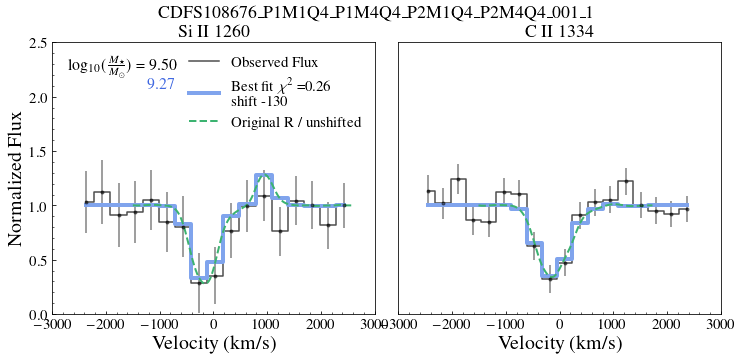

here 1
here 1
9.2 0.972094080019182 0.3844450555462178 1.6131657430805975


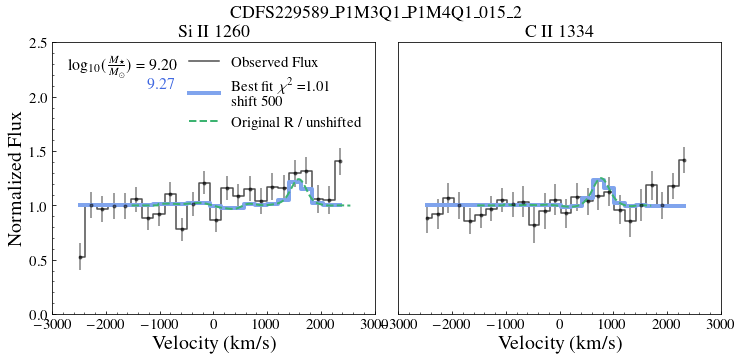

here 1
here 1
9.4 2.0680586826129486 2.2691007662997698 1.8418863384652753


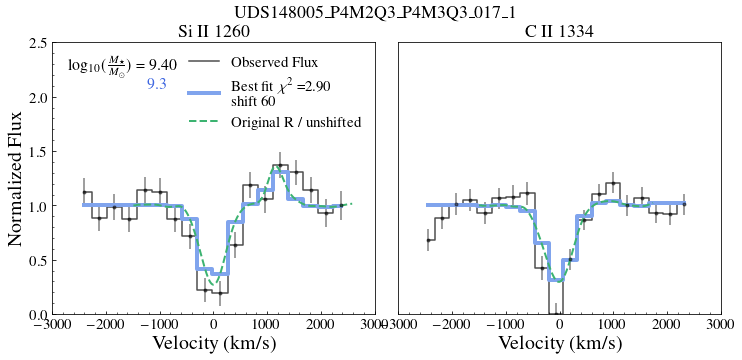

9.6 0.5350963470072603 0.6838939117775875 0.36976571948467435


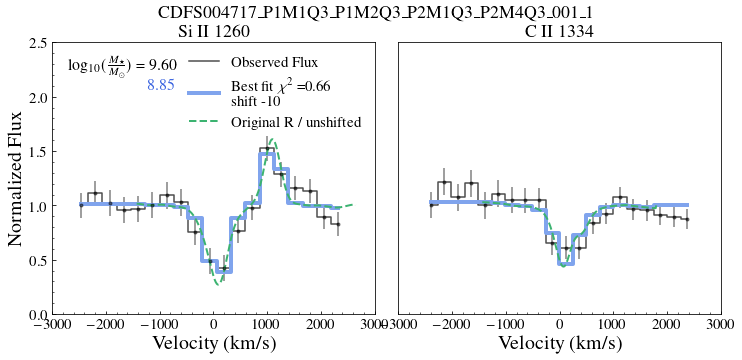

9.7 1.384887206726059 2.1684390065927914 0.6013354068593265


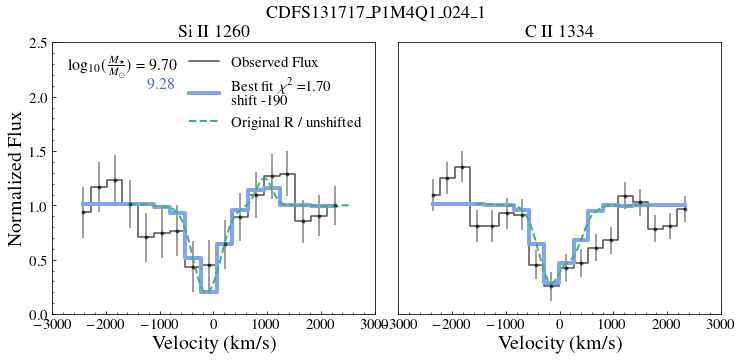

9.5 0.579308992918465 0.6209763219887282 0.5334749309411755


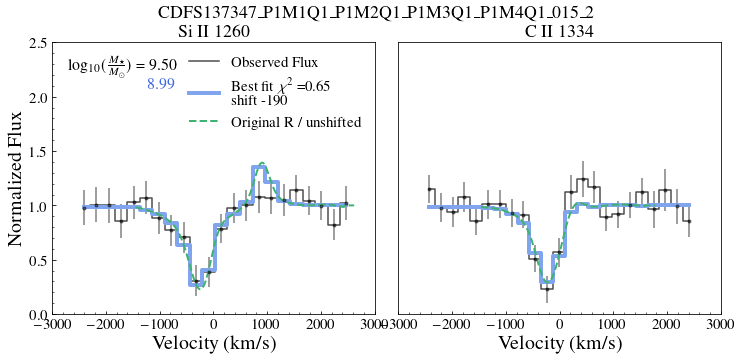

9.2 1.0355459350067622 1.0730282806065274 0.9938988843403566


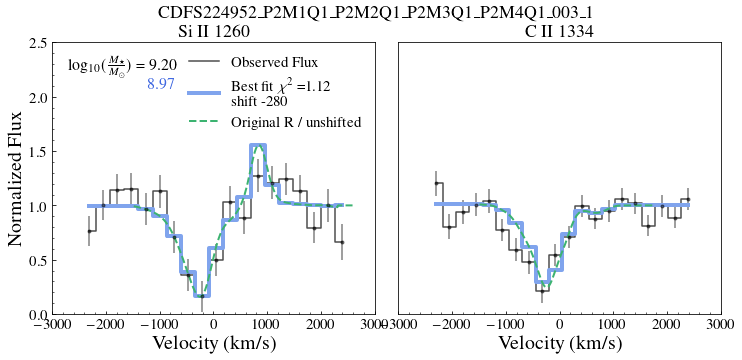

9.7 3.7079192796613 3.563569089394084 3.8522694699285167


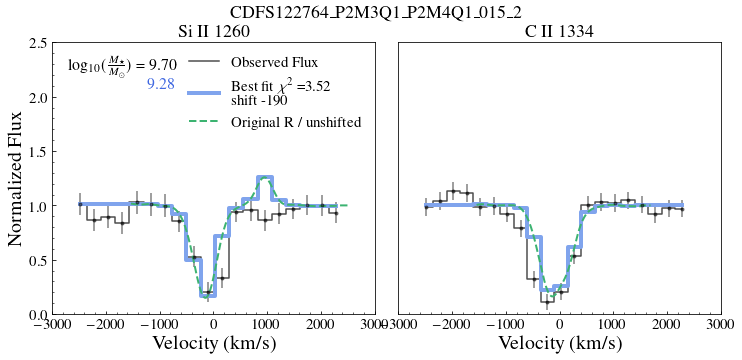

here 1
here 1
9.5 0.5988085464863283 0.28739533569065495 0.9102217572820016


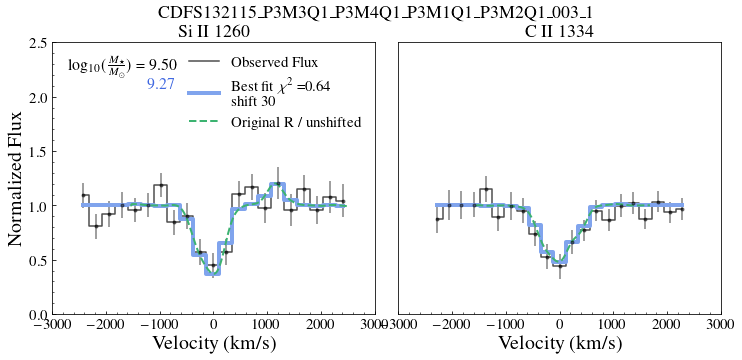

9.8 2.4502117195813464 1.1905544640087902 3.7098689751539022


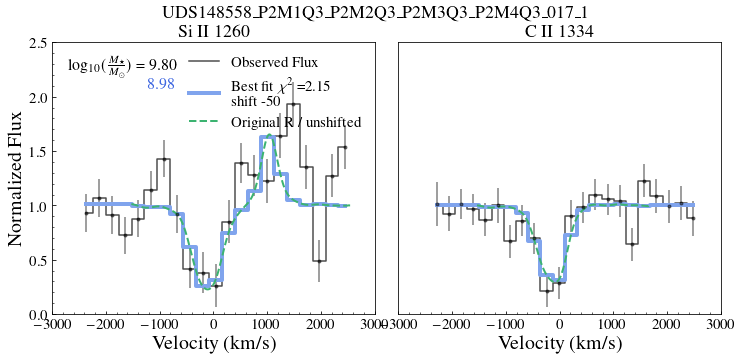

here 1
here 1
9.3 0.32395348186504036 0.37189853725850897 0.2700152945473882


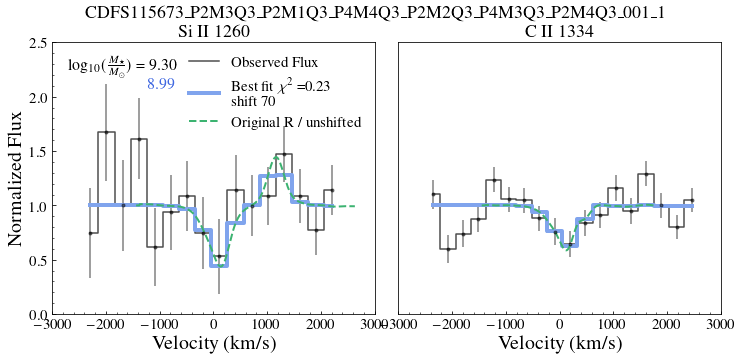

9.9 0.6738100533198401 1.0524126094974908 0.2952074971421894


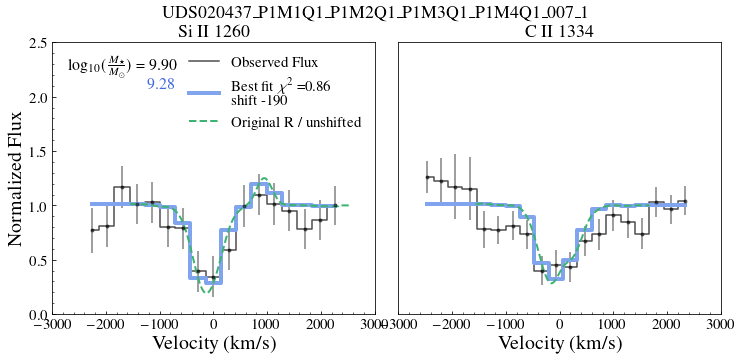

here 1
here 1
9.6 0.9684836096542895 1.4626361100766496 0.4125620466791343


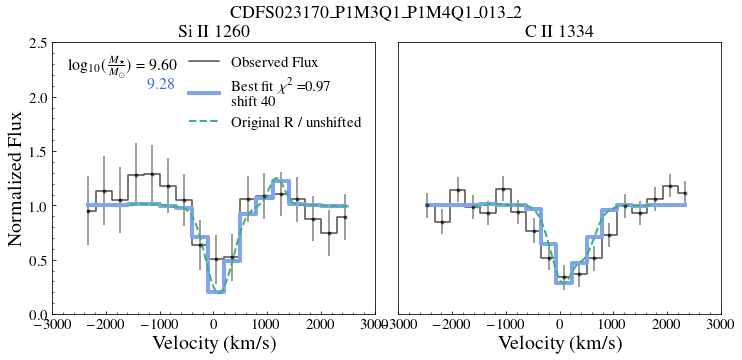

9.8 2.1767371859841886 1.5019179054987584 2.912903673786477


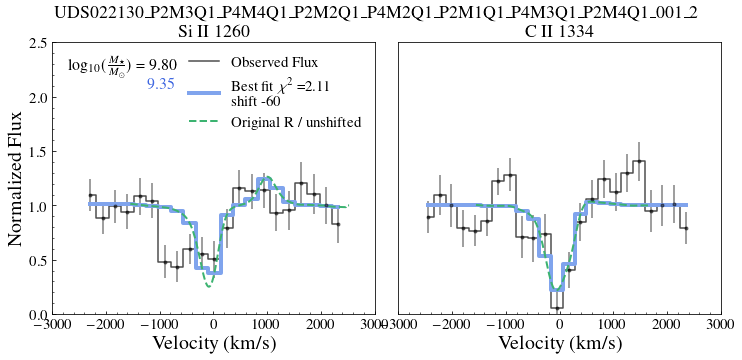

In [321]:
dfFS   = pd.read_csv('Vandels_100best_offset.csv')
v_cm = np.genfromtxt(path_to_folder+'./dat_files/vcm_90_164.dat',unpack=True)
chi2allC_off = []
chi2allS_off = []
chi2all_off = []
onesig = 0
twosig = 0
threesig = 0
otherssig = 0
true_i= 0
def shift5(arr, num, fill_value=1):
    result = np.empty_like(arr)
    if num > 0:
        print('here', fill_value)
        result[:num] = fill_value
        result[num:] = arr[:-num]
    elif num < 0:
        result[num:] = fill_value
        result[:num] = arr[-num:]
    else:
        result[:] = arr
    return result
for i in range(len(info)):    
    
    if(info['snr_per_pix'][i]<5 or info['lmass'][i]<7.5):
        continue
#     print({info["spectrum"][i]})
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
    wave = dat1['wl']/(1+redshift)
    err  =  dat1['flam_err']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux = dat1['flam']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=0
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

    cutCIIall = (vcIId>-2500) & (vcIId<2500) 
    cutSiIIall = (vsiIId>-2500) & (vsiIId<2500)  
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]  
    
    rmedCII = ((vcII<-1000) | (vcII>1000))
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-1000) |  (vsiII > 1700) )
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII  
    

    
    
    fig, axs = plt.subplots(1,2,figsize=(12,5))
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.5)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed Flux')
    axs[1].set_title('C II 1334')
#     axs[1].axvline(0, c= 'royalblue')
   
    
    axs[0].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.5)
    axs[0].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid', label = 'Observed Flux' )
    axs[0].set_title('Si II 1260')
#     axs[0].axvline(0, c= 'royalblue')


    #######################################################                                                                                           
                                                                                                            
    # with FS
    bestDir         = dfFS['DirAll0'][true_i]
    bestOut         = dfFS['OutputAll0'][true_i]
    bestChi2FS      = dfFS['x2All0'][true_i]
    bestOff      =int(dfFS['outAll0'][true_i])
    if(bestChi2FS<=1):
        onesig+=1
    elif(bestChi2FS<=2):
        twosig+=1
    elif(bestChi2FS<=3):
        threesig+=1
    else:
        otherssig+=1
        
        
    lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = rkms_vandels/2 / 2.355/((vcII_s[50]-vcII_s[49]))
    modelcii       = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    
        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  =  rkms_vandels/2/ 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    modelsi      = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
    rmedSiII = ((vsiII_s<-1000) |  (vsiII_s > 1700) )
    fmedSiII = np.nanmedian(modelsi[rmedSiII])
    modelsi /= fmedSiII
    
    modelsi = shift5(modelsi, bestOff,1)
#     print(modelcii[:10])

    rmedCII = ((vcII_s<-1000) | (vcII_s>1000))
    fmedCII = np.nanmedian(modelcii[rmedCII])
    modelcii /= fmedCII
    modelcii = shift5(modelcii, bestOff,1)
    modelNewcii    = np.interp(vcII,vcII_s, modelcii)

    #modelcii=fluxcII[bestDir,1:]/fmedCII
    
    modelNewsi     = np.interp(vsiII,vsiII_s, modelsi)
#     rmedSiII = ((vsiII<-1000) |  (vsiII > 2000) )
#     fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
#     modelNewsi /= fmedSiII  
#     modelsi = fluxsiII[bestDir,1:]/fmedSiII
         
        
    
    maskCII = (vcII >-1000) & (vcII < 1500)
    maskSiII =  (vsiII > -1000)  & (vsiII <  1500)


    if(len(ecII[maskCII]) > 0):
        lnlikecII  =  np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2) #/len(ecII[maskCII])
        ncII = len(fcII[maskCII])
    else:
        lnlikecII = 0
        ncII = 0
    if(len(esiII[maskSiII]) > 0):
        lnlikesiII =  np.nansum(((fsiII[maskSiII] -  modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)#/len(esiII[maskSiII])
        nsiII = len(fsiII[maskSiII])               
    else:
        lnlikesiII = 0
        nsiII = 0

    if(np.isnan(lnlikesiII)):
        lnlikesiII = 0
        nsiII = 0
    if(np.isnan(lnlikecII)):
        lnlikecII = 0
        ncII = 0
    lnlikeall  = (lnlikecII + lnlikesiII)/(ncII + nsiII)

    print( info['lmass'][i] , lnlikeall, lnlikecII/ncII, lnlikesiII/nsiII)
        
    axs[0].set_xlabel('Velocity (km/s)', fontsize = 20,)
    axs[1].set_xlabel('Velocity (km/s)', fontsize = 20)
    axs[0].set_ylabel('Normalized Flux', fontsize = 20)
    axs[1].set_yticks([])
    axs[0].set_xlim(-3010,3010)
    axs[1].set_xlim(-3010,3010)
    plt.suptitle( '%s'%info["spectrum"][i].replace("_", "\_" ), fontsize = 18)
    
    axs[0].set_ylim(0,2.5)
    axs[1].set_ylim(0,2.5)

#     maskCII = (vcII >-1000) & (vcII < 1000)
#     maskSiII = (vsiII > - 800)   & (vsiII < 1700)
#     #& (~((vsiII >-364) & (vsiII <-144)))
#     lnlikecII  =  np.nansum(((fcII[maskCII]-modelNewcii[maskCII])**2)/ecII[maskCII]**2)#/len(modelNewcii[maskCII])
#     ncII = len(modelNewcii[maskCII])

#     lnlikesiII =  np.nansum(((fsiII[maskSiII] - modelNewsi[maskSiII])**2)/esiII[maskSiII]**2)#/len(modelNewsi[maskSiII])
#     nsiII = len(modelNewsi[maskSiII])
        
# #     print('All ', lnlikecII/ncII, lnlikesiII/nsiII)
#     lnlikeall  = (lnlikecII + lnlikesiII)/(ncII+nsiII)
# #     print(lnlikeall)  
#     chi2allC_off.append(lnlikecII/ncII)
#     chi2allS_off.append(lnlikesiII/nsiII)
    chi2all_off.append(lnlikeall)
    axs[1].plot(vcII, modelNewcii, c =cFS, lw = 4, label = 'Best match', drawstyle = 'steps-mid')
    axs[0].plot(vsiII, modelNewsi, c =cFS, lw = 4, drawstyle = 'steps-mid',
                label = 'Best fit $\chi^2$ =%.2f \n shift %.0f'%(bestChi2FS,vsiII_s[50+int(bestOff)]-vsiII_s[50]))# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])
   

    axs[1].plot(vcII_s, gaussian_filter(modelcii,sigma = 0), c ='mediumseagreen', lw = 2, ls = '--')
    axs[0].plot(vsiII_s, gaussian_filter(modelsi,sigma = 0), c ='mediumseagreen', lw = 2,
                label = 'Original R / unshifted', ls = '--')# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])

    axs[0].text(0.05, 0.9, r'log$_{10}(\frac{M_\star}{M_\odot})$ = %.2f '%info['lmass'][i],
                transform=axs[0].transAxes, fontsize = 16)
    axs[0].text(0.05+(0.915-0.67), 0.83, str(np.round(np.log10(Mstar[bestOut-90]),2)),
                transform=axs[0].transAxes, fontsize = 16, c = 'royalblue')
    axs[0].legend(frameon = False, loc = 'upper right')
    plt.subplots_adjust(wspace=0.07, hspace=None)
    if( bestChi2FS>4):
        print("HEEEEL YEEEAH")
#     plt.savefig('Plots/WithOffsets/'+info["spectrum"][i]+'_bestmatch_offset.pdf', bbox_inches = 'tight')
    plt.show()
    
    true_i +=1
#     if(true_i>2):
#     break


### Plot fit paper

99 3.254988593084383
106 5.049008286725912
106 5.441047256136047
148 1.1215330101984056
here 1
here 1
101 1.48185097471958
here 1
here 1
151 1.661908462460371
here 1
here 1
99 1.1191979684898326
104 1.638774276513522
102 1.8737711717869432


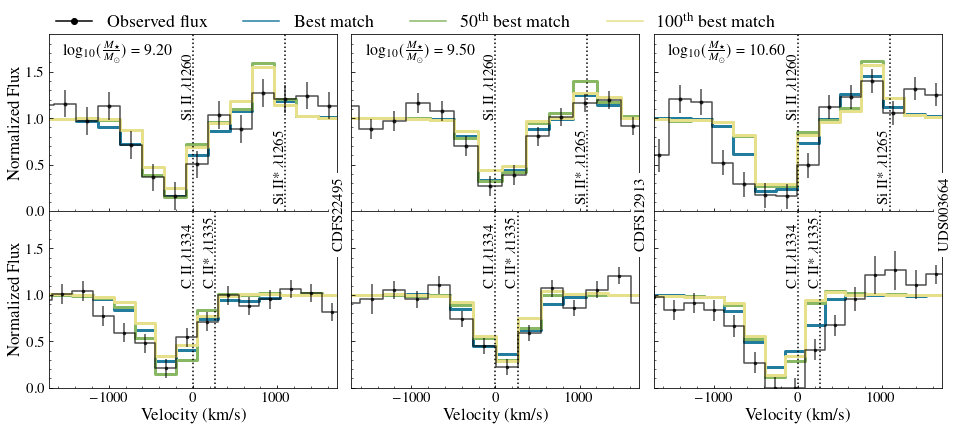

In [490]:
dfFS   = pd.read_csv('Vandels_100best_offset.csv')
v_cm = np.genfromtxt(path_to_folder+'./dat_files/vcm_90_164.dat',unpack=True)
gal_sel = ['CDFS2249', 'UDS003664', 'CDFS129134',]
true_i = -1
plt_i = 3
fig, axs = plt.subplots(2,3,figsize=(16,6.5),sharex=True, sharey = True)

for i in range(len(info)):    
    
    if(info['snr_per_pix'][i]<5 or info['lmass'][i]<7.5):
        continue
    true_i +=1
    found = False
    for name in gal_sel:
        if name in info['spectrum'][i]:
            found=True
            break
    if(found == False):
        continue
    plt_i -=1

#     print({info["spectrum"][i]})
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
    wave = dat1['wl']/(1+redshift)
    err  =  dat1['flam_err']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux = dat1['flam']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=0
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

    cutCIIall = (vcIId>-2500) & (vcIId<2500) 
    cutSiIIall = (vsiIId>-2500) & (vsiIId<2500)  
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]  
    
    rmedCII = ((vcII<-1000) | (vcII>1000))
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-1000) |  (vsiII > 1700) )
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII  
    

    
    
    axs[1,plt_i].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.7, markersize = 5)
    axs[1,plt_i].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed Flux' )
#     axs[1].set_title('C II 1334')
#     axs[1].axvline(0, c= 'royalblue')
   
    
    axs[0,plt_i].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.7)
    axs[0,plt_i].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid', label = 'Observed Flux' )
#     axs[0].set_title('Si II 1260')
#     axs[0].axvline(0, c= 'royalblue')


    #######################################################                                                                                           
                                                                                                            
    # with FS
    cfits = ['#227C9D','#89B865', '#E7E08B']
    for idxfix in [0,49,99]:
        bestDir         = dfFS[f'DirAll{idxfix}'][true_i]
        bestOut         = dfFS[f'OutputAll{idxfix}'][true_i]
        bestChi2FS      = dfFS[f'x2All{idxfix}'][true_i]
        bestOff          =   int(dfFS[f'outAll{idxfix}'][true_i])
        print(bestOut, bestChi2FS)


        lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
        lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

                ## CII Plot
        lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
        lcII_systemic  = lcII_systemic[1:]
        vcII_s         = (lcII_systemic/wcII1334 -1)*c
        sigma_pixelcii = rkms_vandels/2 / 2.355/((vcII_s[50]-vcII_s[49]))
        modelcii       = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)

            ## Si II plot
        lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
        lsiII_systemic = lsiII_systemic[1:]
        vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
        sigma_pixelsi  =  rkms_vandels/2/ 2.355/ ((vsiII_s[50]-vsiII_s[49]))
        modelsi      = gaussian_filter(fluxsiII[bestDir,1:], sigma = sigma_pixelsi)
        rmedSiII = ((vsiII_s<-1000) |  (vsiII_s > 1700) )
        fmedSiII = np.nanmedian(modelsi[rmedSiII])
        modelsi /= fmedSiII

        modelsi = shift5(modelsi, bestOff,1)
    #     print(modelcii[:10])

        rmedCII = ((vcII_s<-1000) | (vcII_s>1000))
        fmedCII = np.nanmedian(modelcii[rmedCII])
        modelcii /= fmedCII
        modelcii = shift5(modelcii, bestOff,1)
        modelNewcii    = np.interp(vcII,vcII_s, modelcii)

        #modelcii=fluxcII[bestDir,1:]/fmedCII

        modelNewsi     = np.interp(vsiII,vsiII_s, modelsi)


#         print( info['lmass'][i] , lnlikeall, lnlikecII/ncII, lnlikesiII/nsiII)

#         axs[0].set_xlabel('Velocity (km/s)', fontsize = 20,)


        
        axs[1,plt_i].plot(vcII, modelNewcii, c =cfits[idxfix//40], lw = 3, label = 'Best match', drawstyle = 'steps-mid', zorder = 0)
        axs[0,plt_i].plot(vsiII, modelNewsi, c =cfits[idxfix//40], lw =3, drawstyle = 'steps-mid',
                    label = 'Best match $\chi^2$ =%.2f'%(bestChi2FS), zorder = 0)# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])
    if(plt_i==0):
        axs[0,plt_i].set_ylabel('Normalized Flux', fontsize = 17)
        axs[1,plt_i].set_ylabel('Normalized Flux', fontsize = 17)

    axs[1,plt_i].set_xlabel('Velocity (km/s)', fontsize = 17)
    axs[0,plt_i].set_xlim(-1710,1710)
    axs[1,plt_i].set_xlim(-1710,1710)
    axs[1,plt_i].text(1660, 1.5, '%s'%info["spectrum"][i][:9], fontsize = 15, rotation = 90,
                     bbox=dict(facecolor='white', edgecolor='white'), zorder= 20)

    axs[0,plt_i].set_ylim(0,2.4)
    axs[1,plt_i].set_ylim(0,1.9)

    axs[1,plt_i].axvline(0, c = 'k', linestyle = ':')
    axs[1,plt_i].text(-150,1.1,r'C II  $\lambda1334$', c = 'k', rotation = 90)

    axs[0,plt_i].axvline(0, c = 'k', linestyle = ':')
    axs[0,plt_i].text(-150,1,r'Si II  $\lambda1260$', c = 'k', rotation = 90)
    axs[1,plt_i].axvline(offcIIfluo1335, c = 'k', linestyle = ':')
    axs[1,plt_i].text(offcIIfluo1335-150,1.1,r'C II*  $\lambda1335$', c = 'k', rotation = 90)

    axs[0,plt_i].axvline(offsiIIfluo1265, c = 'k', linestyle = ':')
    axs[0,plt_i].text(offsiIIfluo1265-150,0.1,r'Si II*  $\lambda1265$', c = 'k', rotation = 90)

    axs[0,plt_i].text(0.05, 0.88, r'log$_{10}(\frac{M_\star}{M_\odot})$ = %.2f'%info['lmass'][i],
                    transform=axs[0,plt_i].transAxes, fontsize = 16)
#         axs[0].text(0.5, 0.85, '('+str(np.round(np.log10(Mstar[bestOut-90]),2))+')',
#                     transform=axs[0].transAxes, fontsize = 16, c = 'royalblue')
#         axs[0].legend(frameon = False, loc = 'upper right')

line0 = Line2D([0], [0], label='Observed flux', marker='o', linestyle='-', color='k')   
line1 = Line2D([0], [0], label='Observed flux', marker='None', linestyle='-', color=cfits[0])    
line2 = Line2D([0], [0], label='Observed flux', marker='None', linestyle='-', color=cfits[1])    
line3 = Line2D([0], [0], label='Observed flux', marker='None', linestyle='-', color=cfits[2])    

labels = [r'Observed flux', 'Best match', r'50$^{\rm th}$ best match',  r'100$^{\rm th}$ best match' ]
ll = axs[0,0].legend([line0,line1,line2, line3], labels,frameon = False, 
                     loc = (0,0.98),ncol = 4, fontsize = 18)
plt.subplots_adjust(wspace=0.05, hspace=0.0)

plt.savefig('Plots/fitexamples.pdf', bbox_inches = 'tight')
plt.show()

#     true_i +=1
#     if(true_i>2):
#     break


In [327]:
chis = dfFS['x2All0'].values

print(chis[(info['lmass'][mask]<9.5) & (chis>4)] )

[4.76283971]


### Chi square

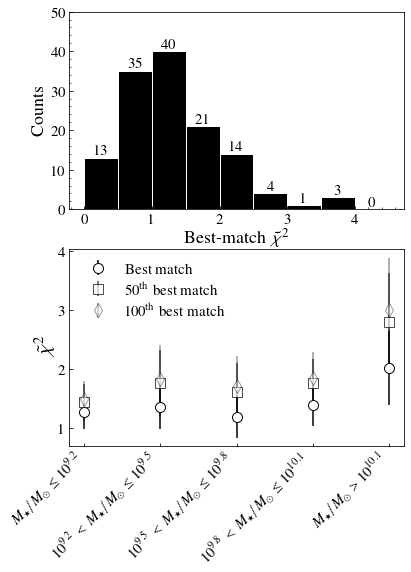

In [335]:
chisall = dfFS['x2All0'].values
chisall[(info['lmass'][mask]<9.5) & (chis>4)] = np.nan

fig, (ax1, ax2) = plt.subplots(2,1, figsize = (6,8))
counts, edges, bars =ax1.hist(chisall,bins = np.arange(0,5,0.5),align='mid', 
                              alpha = 1, label = 'VANDELS',
             edgecolor = 'w',color = 'k', )
ax1.set_xlabel(r'Best-match $\tilde{\chi}^2$', fontsize = 18, labelpad = 1)
ax1.set_ylabel(r'Counts', fontsize = 18)
# axs[0].legend(frameon = False, fontsize = 15))           
ax1.bar_label(bars)
ax1.set_ylim(0,50)

mask1 = info['lmass'][mask]<9.2
mask3 = (9.2 <=info['lmass'][mask]) & (info['lmass'][mask]<9.5)
# mask4 = (9.4 <=info['lmass'][mask) & (info['lmass'][mask<9.6)
mask5 = (9.5 <=info['lmass'][mask]) & (info['lmass'][mask]<9.8)
mask6 = (9.8 <=info['lmass'][mask]) & (info['lmass'][mask]<10.1)
mask7 = (10.1 <=info['lmass'][mask]) 
# mask8 = (10.2 <=info['lmass'][mask)#& (info['lmass'][mask<10.4)
mask9 = (10.4 <=info['lmass'][mask])

ychi = [np.nanmean(chisall[mask1.values]),
         np.nanmean(chisall[mask3.values]),
             np.nanmean(chisall[mask5.values]),np.nanmean(chisall[mask6.values]),
         np.nanmean(chisall[mask7.values])]
ystd = [np.nanstd(chisall[mask1.values]),
         np.nanstd(chisall[mask3.values]),
    np.nanstd(chisall[mask5.values]),np.nanstd(chisall[mask6.values]),
         np.nanstd(chisall[mask7.values])]

ax2.errorbar(np.arange(len(ychi)),ychi, yerr = np.asarray(ystd)/2, marker = 'o', 
             markeredgecolor ='k',color = 'w',ecolor = 'k',
           markersize = 10, ls = 'None', label = r'Best match')

chisall = dfFS['x2All49'].values
chisall[(info['lmass'][mask]<9.5) & (chis>4)] = np.nan

ychi = [np.nanmean(chisall[mask1.values]),
         np.nanmean(chisall[mask3.values]),
             np.nanmean(chisall[mask5.values]),np.nanmean(chisall[mask6.values]),
         np.nanmean(chisall[mask7.values])]
ystd = [np.nanstd(chisall[mask1.values]),
         np.nanstd(chisall[mask3.values]),
    np.nanstd(chisall[mask5.values]),np.nanstd(chisall[mask6.values]),
         np.nanstd(chisall[mask7.values])]

ax2.errorbar(np.arange(len(ychi)),ychi, yerr = np.asarray(ystd)/2, marker = 's', 
             markeredgecolor ='k',color = 'w', alpha = 0.7,ecolor = 'k',
           markersize = 10, ls = 'None', label = r'50$^{\rm th}$ best match')

chisall = dfFS['x2All99'].values
chisall[(info['lmass'][mask]<9.5) & (chis>4)] = np.nan

ychi = [np.mean(chisall[mask1.values]),
         np.mean(chisall[mask3.values]),
             np.mean(chisall[mask5.values]),np.mean(chisall[mask6.values]),
         np.mean(chisall[mask7.values])]
ystd = [np.std(chisall[mask1.values]),
         np.std(chisall[mask3.values]),
    np.std(chisall[mask5.values]),np.std(chisall[mask6.values]),
         np.std(chisall[mask7.values])]

ax2.errorbar(np.arange(len(ychi)),ychi, yerr = np.asarray(ystd)/2, marker = 'd',
             markeredgecolor ='k',color = 'w', alpha = 0.4,ecolor = 'k',
           markersize = 10, ls = 'None', label = r'100$^{\rm th}$ best match')

ax2.minorticks_off()
ax2.set_xticks([0,1,2,3,4])
ax2.set_ylabel(r'$\tilde{\chi}^2$', fontsize = 20)
ax2.legend(frameon = False, fontsize = 15)
ax2.set_xticklabels([r'$M_\star/M_\odot \leq 10^{9.2}$',
                     r'$10^{9.2}$ $<$ $M_\star/M_\odot \leq 10^{9.5}$',
                     r'$10^{9.5}$ $<$ $M_\star/M_\odot\leq 10^{9.8}$',
                     r'$10^{9.8}$ $<$ $M_\star/M_\odot  \leq 10^{10.1}$',
                     r'$M_\star/M_\odot > 10^{10.1}$'],ha="right" ,rotation = 45)
plt.savefig('Plots/Chisquare_woff.pdf', bbox_inches = 'tight')
# plt.figure()
# plt.scatter(info['lmass'][mask],chisall )

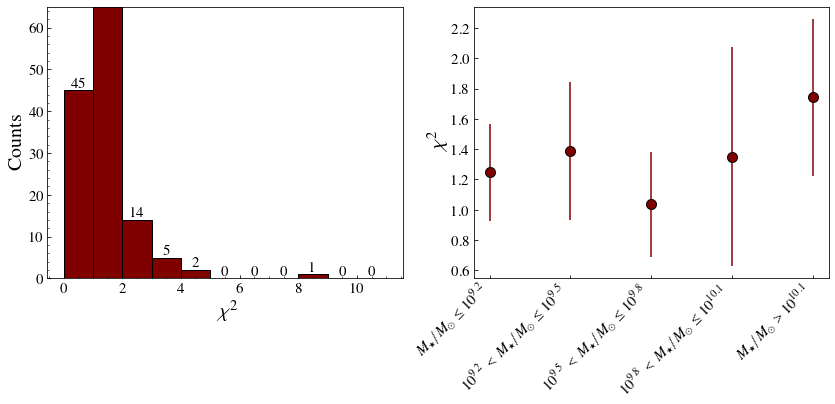

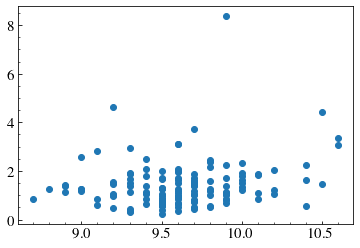

In [289]:
chi2all_off = np.asarray(chi2all_off)
fig, (ax1, ax2) = plt.subplots(1,2, figsize = (14,5))
counts, edges, bars =ax1.hist(chi2all_off,bins = [0,1,2,3,4,5,6,7,8,9,10,11],align='mid', 
                              alpha = 1, label = 'VANDELS',
             edgecolor = 'k',color = '#800000', )
ax1.set_xlabel(r'$\chi^2$', fontsize = 20)
ax1.set_ylabel(r'Counts', fontsize = 20)
# axs[0].legend(frameon = False, fontsize = 15))           
ax1.bar_label(bars)
ax1.set_ylim(0,65)

mask1 = info['lmass'][mask]<9.2
mask3 = (9.2 <=info['lmass'][mask]) & (info['lmass'][mask]<9.5)
# mask4 = (9.4 <=info['lmass'][mask) & (info['lmass'][mask<9.6)
mask5 = (9.5 <=info['lmass'][mask]) & (info['lmass'][mask]<9.8)
mask6 = (9.8 <=info['lmass'][mask]) & (info['lmass'][mask]<10.1)
mask7 = (10.1 <=info['lmass'][mask])
# mask9 = (10.4 <=info['lmass'][mask])

ychi = [np.median(chi2all_off[mask1.values]),
         np.median(chi2all_off[mask3.values]),
             np.median(chi2all_off[mask5.values]),np.median(chi2all_off[mask6.values]),
         np.median(chi2all_off[mask7.values])]
ystd = [np.std(chi2all_off[mask1.values]),
         np.std(chi2all_off[mask3.values]),
    np.std(chi2all_off[mask5.values]),np.std(chi2all_off[mask6.values]),
         np.std(chi2all_off[mask7.values])]

ax2.errorbar(np.arange(len(ychi)),ychi, yerr = np.asarray(ystd)/2, marker = 'o', markeredgecolor ='k',color = '#800000',
           markersize = 10, ls = 'None')

ax2.minorticks_off()
ax2.set_xticks([0,1,2,3,4])
ax2.set_ylabel(r'$\chi^2$', fontsize = 20)

ax2.set_xticklabels([r'$M_\star/M_\odot \leq 10^{9.2}$',
                     r'$10^{9.2}$ $<$ $M_\star/M_\odot \leq 10^{9.5}$',
                     r'$10^{9.5}$ $<$ $M_\star/M_\odot\leq 10^{9.8}$',
                     r'$10^{9.8}$ $<$ $M_\star/M_\odot  \leq 10^{10.1}$',
                     r'$M_\star/M_\odot > 10^{10.1}$'],ha="right" ,rotation = 45)
# plt.savefig('Plots/Chisquare_woff.pdf', bbox_inches = 'tight')
plt.figure()
plt.scatter(info['lmass'][mask],chi2all_off )

## Comparison both fitting approaches

### Fit comp

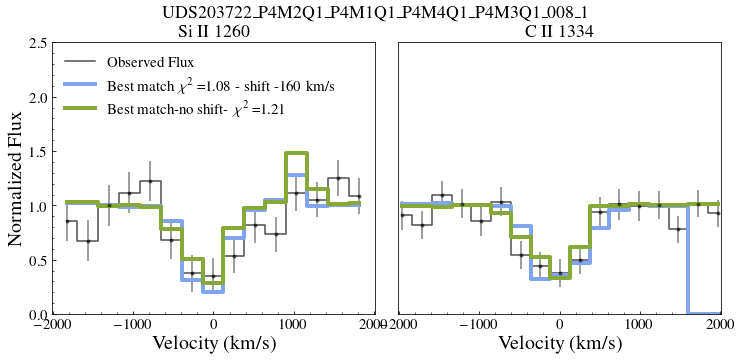

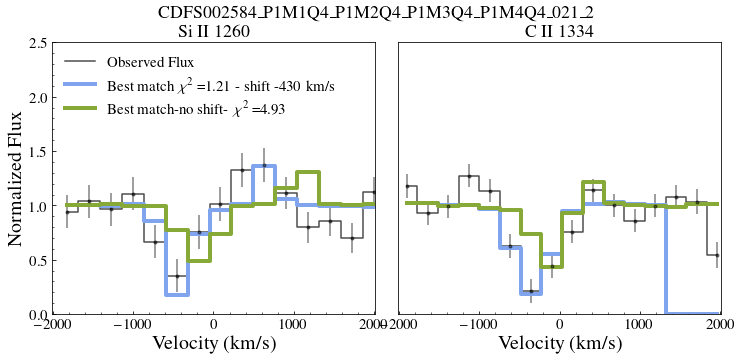

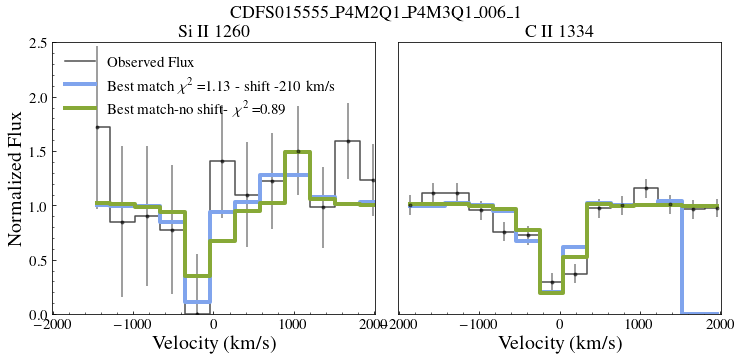

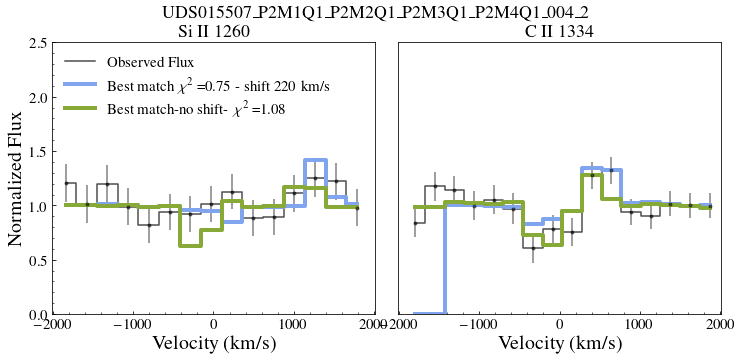

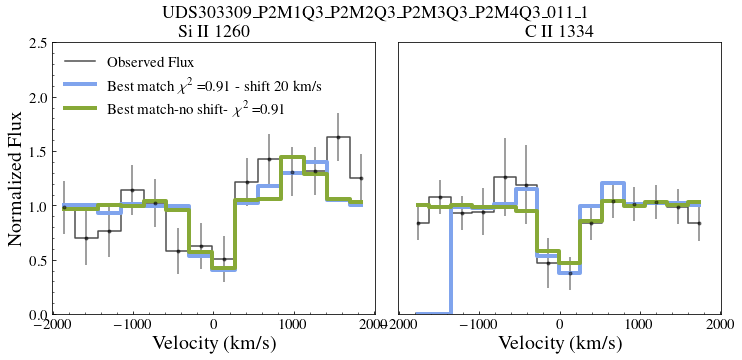

...

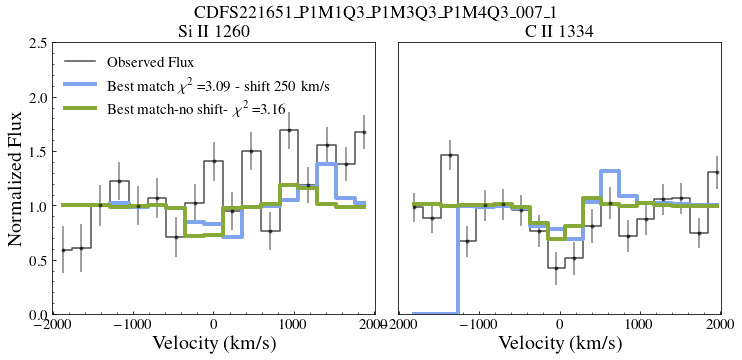

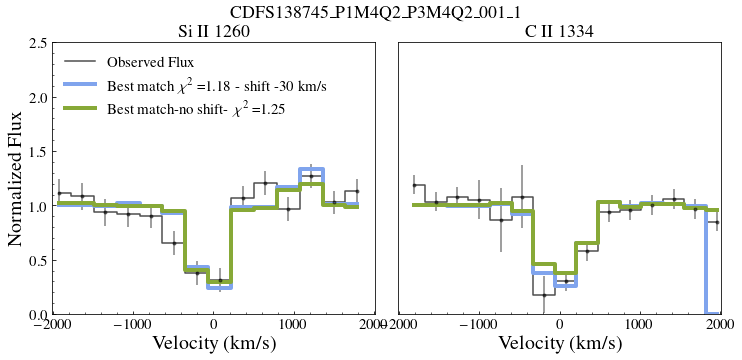

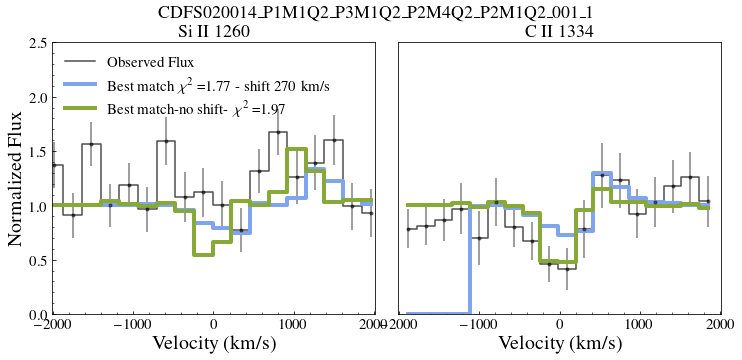

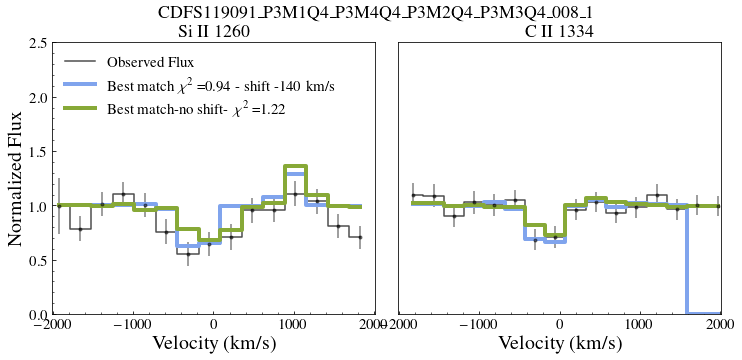

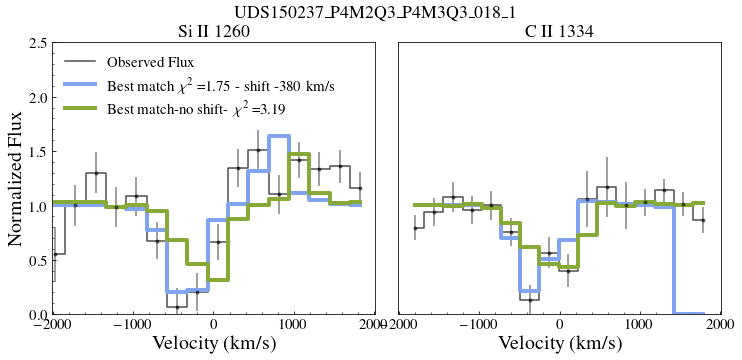

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)


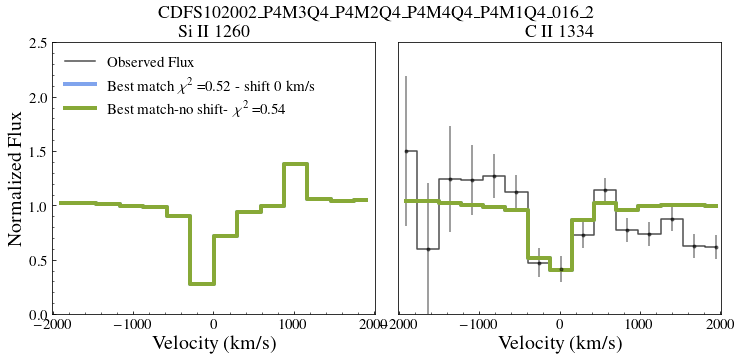

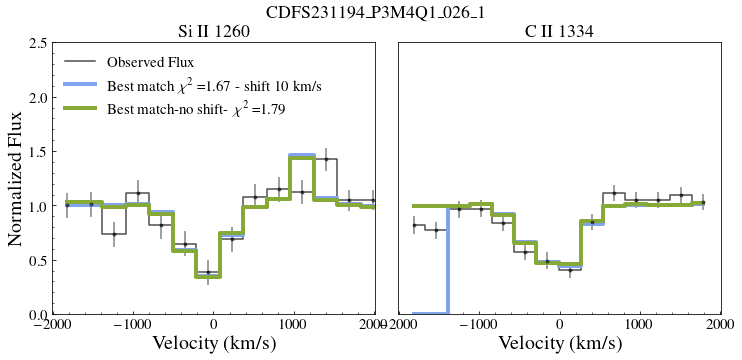

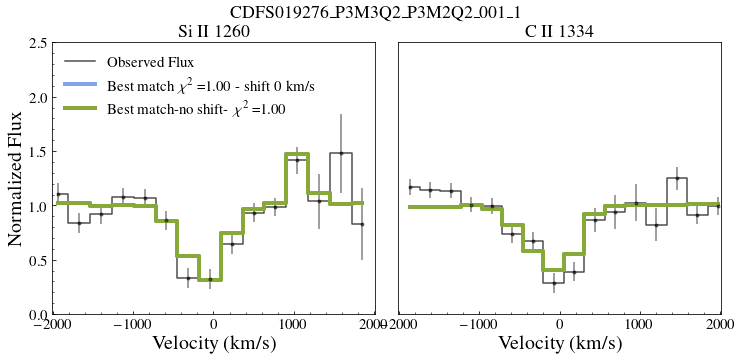

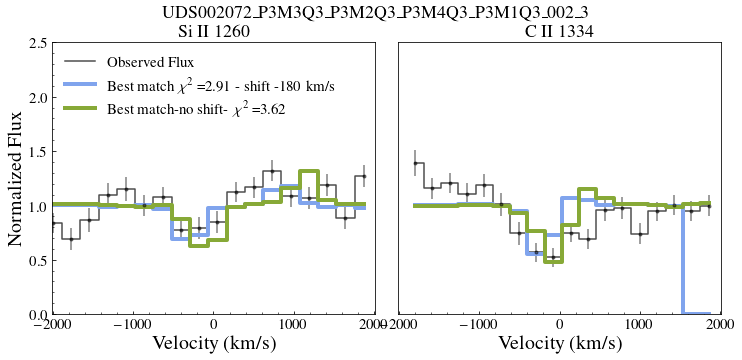

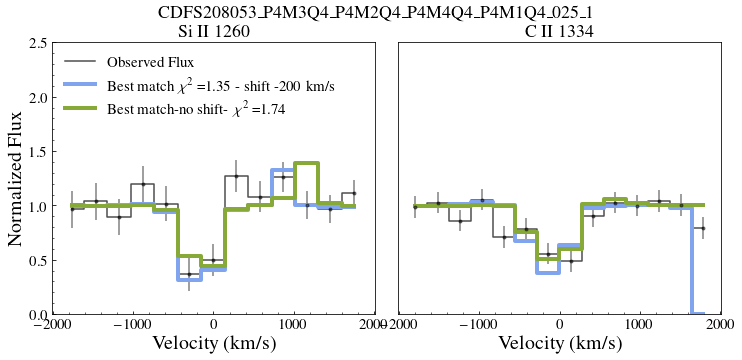

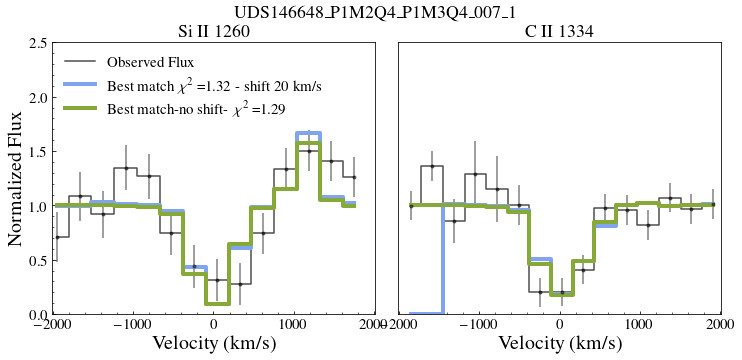

/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/core/_asarray.py:102: UserWarning: Warning: converting a masked element to nan.
  return array(a, dtype, copy=False, order=order)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)
/home/simon/anaconda3/lib/python3.9/site-packages/numpy/lib/nanfunctions.py:1111: RuntimeWarning: Mean of empty slice
  return np.nanmean(a, axis, out=out, keepdims=keepdims)


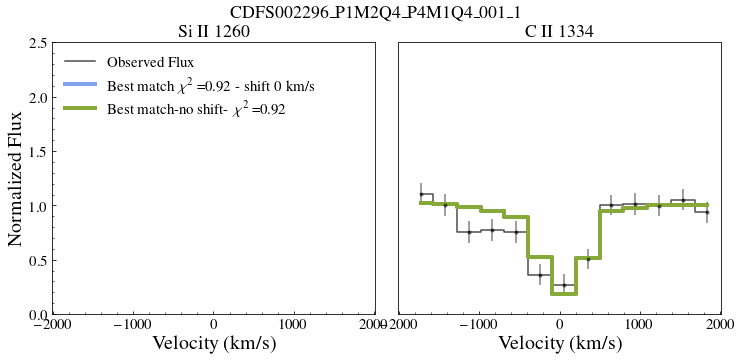

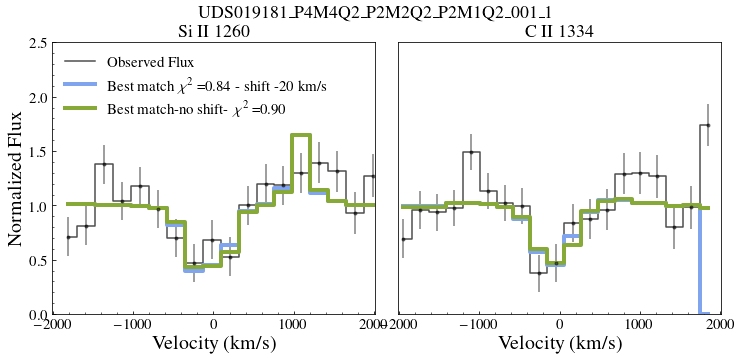

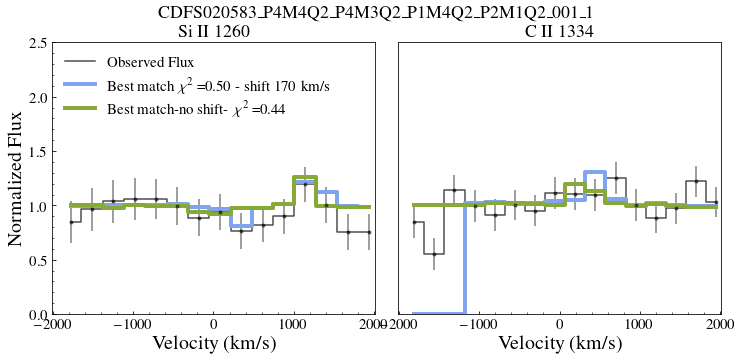

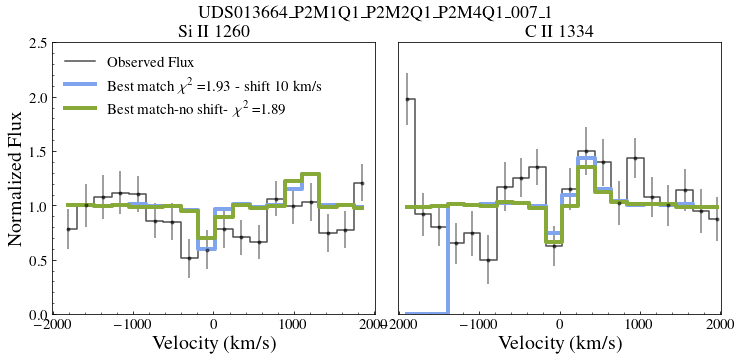

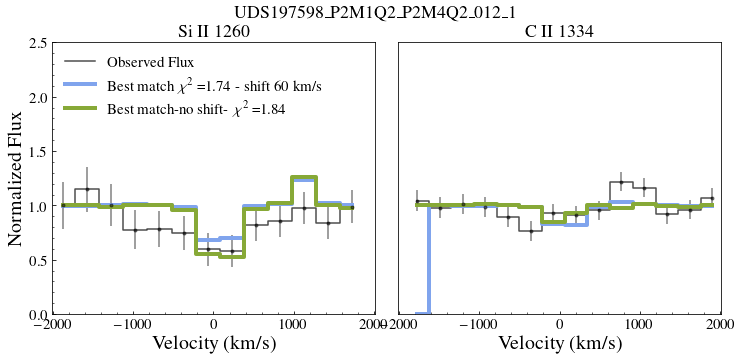

...

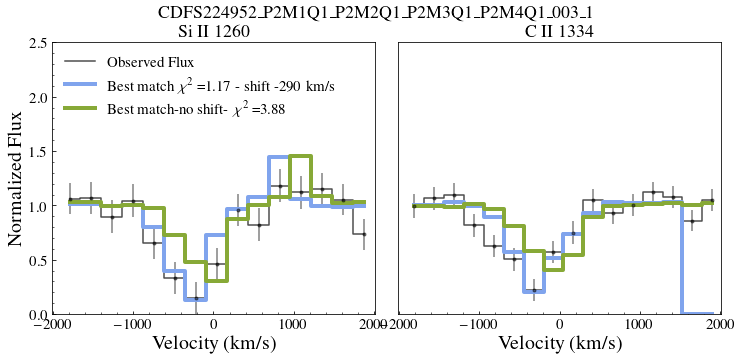

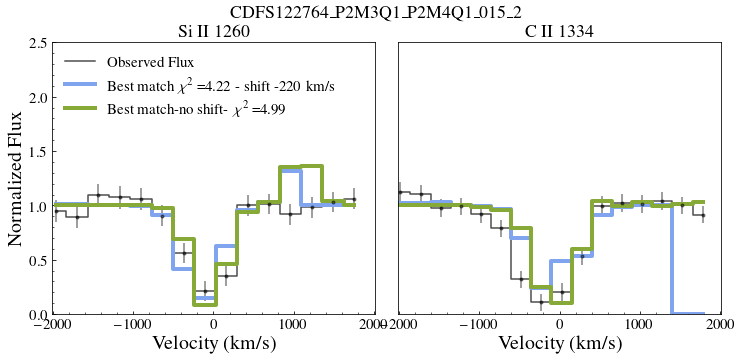

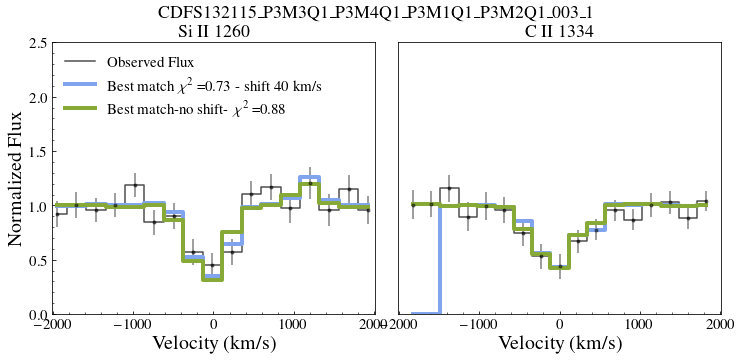

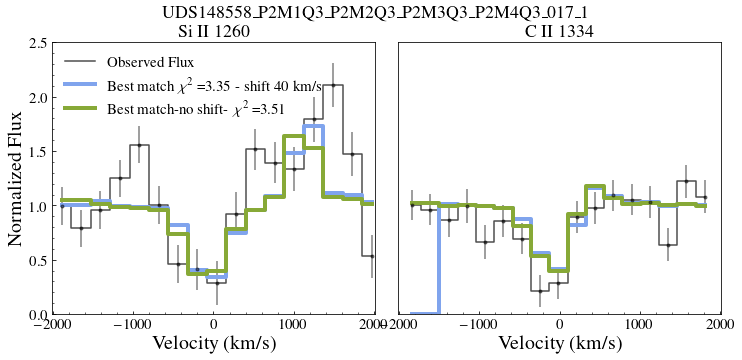

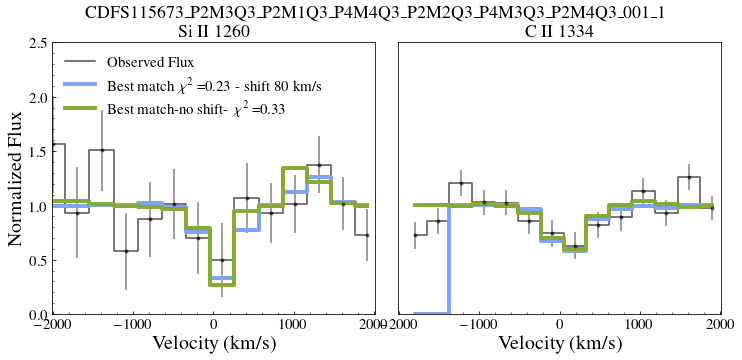

KeyError: 131

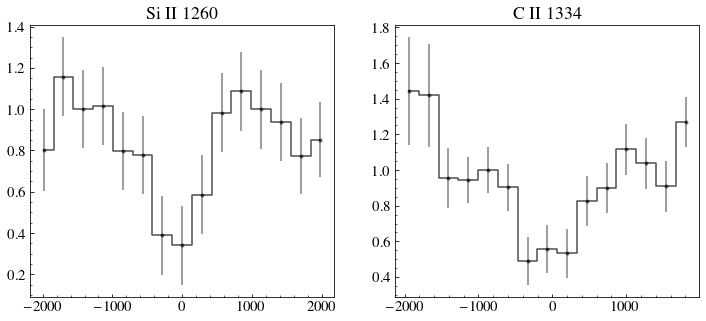

In [665]:
dfyes   = pd.read_csv('Vandels_10best_offset.csv')
dfno   = pd.read_csv('Vandels_10best_nooffset.csv')

v_cm = np.genfromtxt(path_to_folder+'./dat_files/vcm_90_164.dat',unpack=True)
chi2allC_off = []
chi2allS_off = []
chi2all_off = []
onesig = 0
twosig = 0
threesig = 0
otherssig = 0
true_i= 0
for i in range(len(info)):    
    
    if(info['snr_per_pix'][i]<5):
        continue
#     print({info["spectrum"][i]})
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
    wave = dat1['wl']/(1+redshift)
    err  =  dat1['flam_err']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux = dat1['flam']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=0
    vcIId  = (wave/wcII1334-1)*c
    vsiIId = (wave/wsiII1260-1)*c

    cutCIIall = (vcIId>-2000) & (vcIId<2000) 
    cutSiIIall = (vsiIId>-2000) & (vsiIId<2000)  
    
    fcII     = flux[cutCIIall]
    fsiII    = flux[cutSiIIall]
    ecII     = err[cutCIIall]
    esiII    = err[cutSiIIall]
    vcII     = vcIId[cutCIIall]
    vsiII    = vsiIId[cutSiIIall]  
    
    rmedCII = ((vcII<-500) | (vcII > 500))
    fmedCII = np.nanmedian(fcII[rmedCII])
    fcII /= fmedCII
    
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500))) 
    fmedSiII = np.nanmedian(fsiII[rmedSiII])
    fsiII /= fmedSiII
    
    fig, axs = plt.subplots(1,2,figsize=(12,5))
    axs[1].errorbar(vcII, fcII, yerr = ecII, fmt='.k' , alpha=0.5)
    axs[1].plot(vcII, fcII,  c='k', alpha = 0.7,drawstyle='steps-mid' , label = 'Observed Flux')
    axs[1].set_title('C II 1334')
#     axs[1].axvline(0, c= 'royalblue')
   
    
    axs[0].errorbar(vsiII, fsiII, yerr = esiII, fmt='.k' , alpha=0.5)
    axs[0].plot(vsiII, fsiII,  c='k',  alpha = 0.7,drawstyle='steps-mid', label = 'Observed Flux' )
    axs[0].set_title('Si II 1260')
#     axs[0].axvline(0, c= 'royalblue')


    #######################################################                                                                                           
                                                                                                            
    # with Off set
    bestDir_off         = dfyes['DirAll0'][true_i]
    bestOut_off         = dfyes['OutputAll0'][true_i]
    bestChi2FS_off      = dfyes['x2All0'][true_i]
    bestOff_off         = int(dfyes['outAll0'][true_i])
#     print(bestDir_off,bestOut_off,bestOff_off )
    lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut_off )
    lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut_off )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir_off,:], v_cm[:,bestOut_off-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = rkms_vandels/4 / 2.355/((vcII_s[50]-vcII_s[49]))
    modelcii       = gaussian_filter(fluxcII[bestDir_off,1:], sigma = sigma_pixelcii)
    
        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir_off,:],v_cm[:,bestOut_off-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  =  rkms_vandels/4/ 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    modelsi      = gaussian_filter(fluxsiII[bestDir_off,1:]/np.median(fluxsiII[bestDir_off,1:]), sigma = sigma_pixelsi)
    
    modelsi = shift5(modelsi, bestOff_off)
    modelcii = shift5(modelcii, bestOff_off)
    
    modelNewcii    = np.interp(vcII,vcII_s, modelcii)
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    modelcii=fluxcII[bestDir_off,1:]/fmedCII
    
    modelNewsi     = np.interp(vsiII,vsiII_s, modelsi)
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    modelsi = fluxsiII[bestDir,1:]/np.median(fluxsiII[bestDir_off,1:])/fmedSiII
    
    
    axs[1].plot(vcII, modelNewcii, c =cFS, lw = 4, label = 'Best match', drawstyle = 'steps-mid')
    axs[0].plot(vsiII, modelNewsi, c =cFS, lw = 4, drawstyle = 'steps-mid',
                label = 'Best match $\chi^2$ =%.2f -  shift %.0f km/s'%(bestChi2FS_off,
                                                                 vsiII_s[50+int(bestOff_off)]-vsiII_s[50]))# label = 'fesc %.3f'%fesc900[bestOut-90, bestDir])

    # without Off set
    bestDir         = dfno['DirAll0'][true_i]
    bestOut        = dfno['OutputAll0'][true_i]
    bestChi2FS      = dfno['x2All0'][true_i]

    lcII, fluxcII   = read_spectrum_c(path_to_data,  bestOut )
    lsiII, fluxsiII = read_spectrum_si(path_to_data, bestOut )

            ## CII Plot
    lcII_systemic  = lcII + np.dot(directions[bestDir,:], v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lcII) 
    lcII_systemic  = lcII_systemic[1:]
    vcII_s         = (lcII_systemic/wcII1334 -1)*c
    sigma_pixelcii = rkms_vandels/4 / 2.355/((vcII_s[50]-vcII_s[49]))
    modelcii       = gaussian_filter(fluxcII[bestDir,1:], sigma = sigma_pixelcii)
    
        ## Si II plot
    lsiII_systemic = lsiII + np.dot(directions[bestDir,:],v_cm[:,bestOut-90])/c_cgs*1e5*np.mean(lsiII) 
    lsiII_systemic = lsiII_systemic[1:]
    vsiII_s        = (lsiII_systemic/wsiII1260 -1)*c
    sigma_pixelsi  =  rkms_vandels/4/ 2.355/ ((vsiII_s[50]-vsiII_s[49]))
    modelsi      = gaussian_filter(fluxsiII[bestDir,1:]/np.median(fluxsiII[bestDir,1:]), sigma = sigma_pixelsi)
    

    modelNewcii    = np.interp(vcII,vcII_s, modelcii)
    rmedCII = ((vcII<-500) | (vcII > 700)) 
    fmedCII = np.nanmedian(modelNewcii[rmedCII])
    modelNewcii /= fmedCII
    modelcii=fluxcII[bestDir,1:]/fmedCII
    
    modelNewsi     = np.interp(vsiII,vsiII_s, modelsi)
    rmedSiII = ((vsiII<-600) | ((vsiII > 300) & (vsiII < 500)))
    fmedSiII = np.nanmedian(modelNewsi[rmedSiII])
    modelNewsi /= fmedSiII  
    modelsi = fluxsiII[bestDir,1:]/np.median(fluxsiII[bestDir,1:])/fmedSiII
    axs[1].plot(vcII, modelNewcii, c =cnoFS, lw = 4, label = 'Best match', drawstyle = 'steps-mid')
    axs[0].plot(vsiII, modelNewsi, c =cnoFS, lw = 4, drawstyle = 'steps-mid',
                label = 'Best match-no shift- $\chi^2$ =%.2f '%(bestChi2FS))
    ############   
    axs[0].set_xlabel('Velocity (km/s)', fontsize = 20,)
    axs[1].set_xlabel('Velocity (km/s)', fontsize = 20)
    axs[0].set_ylabel('Normalized Flux', fontsize = 20)
    axs[1].set_yticks([])
    axs[0].set_xlim(-2010,2010)
    axs[1].set_xlim(-2010,2010)
    plt.suptitle( '%s'%info["spectrum"][i].replace("_", "\_" ), fontsize = 18)
    
    axs[0].set_ylim(0,2.5)
    axs[1].set_ylim(0,2.5)

    axs[0].legend(frameon = False, loc = 'upper left')
    plt.subplots_adjust(wspace=0.07, hspace=None)
    plt.savefig('Plots/'+info["spectrum"][i]+'_bestmatch_comp.pdf', bbox_inches = 'tight')
    plt.show()
    true_i +=1
#     if(true_i>2):
#         break


### Chisquare

<a list of 2 BarContainer objects>


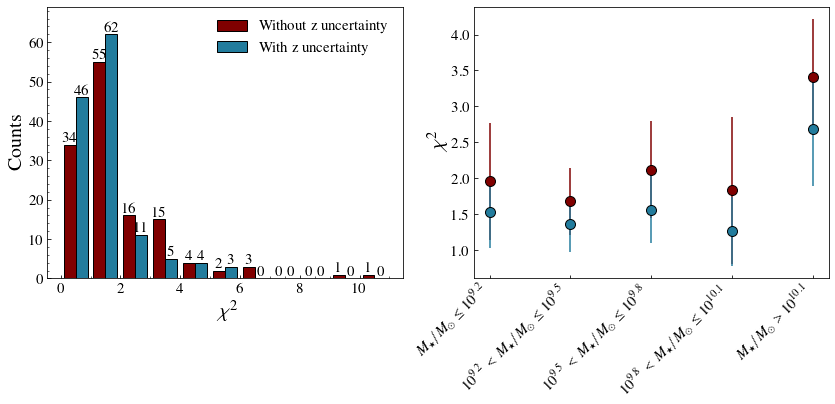

In [631]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize = (14,5))
counts, edges, bars =ax1.hist([dfno['x2All0'],dfyes['x2All0']],bins = [0,1,2,3,4,5,6,7,8,9,10,11],align='mid', 
                              alpha = 1, label = ['Without z uncertainty', 'With z uncertainty'],
             edgecolor = 'k',color = ['#800000','#227C9D'], )
print(bars)
ax1.set_xlabel(r'$\chi^2$', fontsize = 20)
ax1.set_ylabel(r'Counts', fontsize = 20)
ax1.legend(frameon = False, fontsize = 15)          
ax1.bar_label(bars[0])
ax1.bar_label(bars[1])

ax1.set_ylim(0,69)

mask1 = info['lmass'][info['snr_per_pix']>5]<9.2
mask3 = (9.2 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.5)
# mask4 = (9.4 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.6)
mask5 = (9.5 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<9.8)
mask6 = (9.8 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<10.1)
mask7 = (10.1 <=info['lmass'][info['snr_per_pix']>5]) & (info['lmass'][info['snr_per_pix']>5]<10.4)
# mask8 = (10.2 <=info['lmass'][info['snr_per_pix']>5])#& (info['lmass'][info['snr_per_pix']>5]<10.4)
mask9 = (10.4 <=info['lmass'][info['snr_per_pix']>5])

ychi1 = [np.mean(dfno['x2All0'][mask1.values]),
         np.mean(dfno['x2All0'][mask3.values]),
             np.mean(dfno['x2All0'][mask5.values]),np.mean(dfno['x2All0'][mask6.values]),
         np.mean(dfno['x2All0'][mask7.values])]
ystd1 = [np.std(dfno['x2All0'][mask1.values]),
         np.std(dfno['x2All0'][mask3.values]),
    np.std(dfno['x2All0'][mask5.values]),np.std(dfno['x2All0'][mask6.values]),
         np.std(dfno['x2All0'][mask7.values])]

ychi2 = [np.mean(dfyes['x2All0'][mask1.values]),
         np.mean(dfyes['x2All0'][mask3.values]),
             np.mean(dfyes['x2All0'][mask5.values]),np.mean(dfyes['x2All0'][mask6.values]),
         np.mean(dfyes['x2All0'][mask7.values])]
ystd2 = [np.std(dfyes['x2All0'][mask1.values]),
         np.std(dfyes['x2All0'][mask3.values]),
    np.std(dfyes['x2All0'][mask5.values]),np.std(dfyes['x2All0'][mask6.values]),
         np.std(dfyes['x2All0'][mask7.values])]

ax2.errorbar(np.arange(len(ychi1)),ychi1, yerr = np.asarray(ystd1)/2, marker = 'o', markeredgecolor ='k',color = '#800000',
           markersize = 10, ls = 'None')
ax2.errorbar(np.arange(len(ychi2)),ychi2, yerr = np.asarray(ystd2)/2, marker = 'o', markeredgecolor ='k',
             color = '#227C9D',
           markersize = 10, ls = 'None')

ax2.minorticks_off()
ax2.set_xticks([0,1,2,3,4])
ax2.set_ylabel(r'$\chi^2$', fontsize = 20)

ax2.set_xticklabels([r'$M_\star/M_\odot \leq 10^{9.2}$',
                     r'$10^{9.2}$ $<$ $M_\star/M_\odot \leq 10^{9.5}$',
                     r'$10^{9.5}$ $<$ $M_\star/M_\odot\leq 10^{9.8}$',
                     r'$10^{9.8}$ $<$ $M_\star/M_\odot  \leq 10^{10.1}$',
                     r'$M_\star/M_\odot > 10^{10.1}$'],ha="right" ,rotation = 45)
plt.savefig('Plots/Chisquare_comp.pdf', bbox_inches = 'tight')


### Plot histogram best ouputs

#### Single best outputs

[0.01302083 0.         0.         0.1015625  0.00520833 0.00260417
 0.         0.00260417 0.00260417 0.         0.         0.00520833
 0.00520833 0.         0.00260417 0.         0.00520833 0.00260417
 0.0078125  0.125      0.03385417 0.01041667 0.00260417 0.00520833]


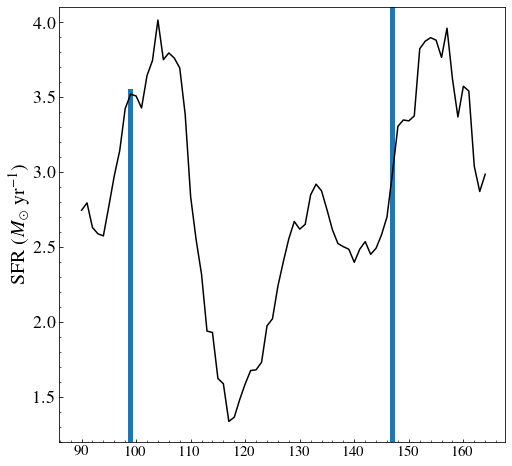

In [372]:
# OUTPUT and DIR
df100   = pd.read_csv('Vandels_100best_offset.csv')
allOut_sing = df100['OutputAll0'].values
allOut_100 = []
for i in range(100):
    allOut_100.append(df100[f'OutputAll{i}'].values)
allOut_100=np.asarray(allOut_100).flatten()
    
cb_colors = ["#739721", "#4C6085", "#886E44", "#E99F0C", "#FE6D73"]
fig, ax1 = plt.subplots(1,1, figsize= (8,8))
gs = GridSpec(8, 8)
ax_main = plt.subplot(gs[:, :])

counts_sing,xbins=np.histogram(allOut_sing, 
                                  bins=range(90,165,3), density = True)
counts_100,xbins=np.histogram(allOut_100, 
                                  bins=range(90,165,3), density = True)
ax_main.bar((xbins[:-1]),(counts_sing)*35)
print(counts_sing)
# hist2 = ax_main.hist([allOut_sing,allOut_100], bins = range(90,165,3), density = True, alpha = 1, 
#                       label =['Best matches - z uncertainty','Best matches - no z uncertainty'],
#                       color =['#800000','#227C9D'],
#                      edgecolor = 'k')
# # hist2 = ax_xDist.hist(allOut_no, bins = range(90,165,2), density = True, alpha = 1, label = '10 best - no z uncertainty', 
#                       color ='#227C9D',
#                      edgecolor = 'k')
allval = np.insert(hist2[0],len(hist2[0]),0)
# axs.scatter(range(90,165,1), fesc900M, label = 'Mean Fesc at 900A per output', c= 'k')
# ax_main.bar(range(90,165,2), allval/max(allval), alpha = 0.4,label = 'Hist of TS of best fits - no FS',
#           color = cFS)
ax_main.plot(np.arange(90,165, 1), SFR100, c ='k', label = 'SFR')
ax_xDist.set_xlabel('Time since Big Bang (Gyrs)', fontsize = 20)
ax_main.set_ylabel(r'SFR ($M_\odot$ yr$^{-1}$)', fontsize = 20)
ax_xDist.set_xticks([100,120,140, 160])
ax_xDist.set_xticklabels(['1.54', '1.74', '1.94', '2.14'], size = 18)
ax_xDist.set_ylabel('PDF', fontsize = 20)
ax_xDist.set_yticks([0,0.3])
ax_xDist.set_yticklabels(['',''])
# ax_main.set_yticks([1.5,2,2.5,3,3.5,4], fontsize = 18)
ax_main.tick_params(axis='y', which='major', labelsize=18)
ax_main.set_ylim(1.2,4.1)
# ax_main.legend(fontsize = 13)

ax_xDist.axis(False)
ax_xDist.legend(frameon = False, loc = 'upper left')
# plt.setp(ax_xDist.get_xticklabels(), visible=False)
plt.subplots_adjust(wspace=0, hspace=0)
# ax_main.set_ylim(0.4, 4.2)

dd = ax_main.get_yticks()


# ax_main.legend(frameon = False, fontsize = 20, ncol = 3, loc= (0,0.1))




# plt.savefig('Plots/SFR_histogram__1best.pdf', bbox_inches = 'tight')

#### 100 and single best match

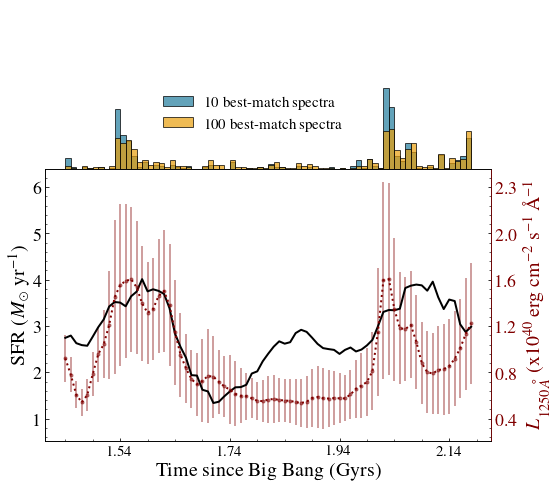

In [542]:
# OUTPUT and DIR
df100   = pd.read_csv('Vandels_100best_offset.csv')
allOut_sing = df100['OutputAll0'].values
allOut_10 =  [df100['OutputAll0'].values]
allOut_100 = []

for i in range(10):
    allOut_10.append(df100[f'OutputAll{i}'].values)
allOut_10=np.asarray(allOut_10).flatten()

for i in range(100):
    allOut_100.append(df100[f'OutputAll{i}'].values)
allOut_100=np.asarray(allOut_100).flatten()


cb_colors = ["#739721", "#4C6085", "#886E44", "#E99F0C", "#FE6D73"]
fig, ax1 = plt.subplots(1,1, figsize= (8,8))
gs = GridSpec(8, 8)
ax_main = plt.subplot(gs[3:8, :8])
ax_xDist = plt.subplot(gs[0:3, :8],sharex=ax_main)

# hist2 = ax_xDist.hist([allOut_10,allOut_100], bins = range(90,165,3), density = True, alpha = 1, 
#                       label =['Single best-match spectra',
#                               '100 best-match spectra'],
#                       color =['#227C9D','#E99F0C'],
#                      edgecolor = 'k')
hist2 = ax_xDist.hist([allOut_10], bins = range(90,165,1), density = True, alpha = 0.7, 
                      label ='10 best-match spectra',
                      color ='#227C9D',
                     edgecolor = 'k')
hist2 = ax_xDist.hist([allOut_100], bins = range(90,165,1), density = True, alpha = 0.7, 
                      label ='100 best-match spectra',
                      color ='#E99F0C',
                     edgecolor = 'k')
# hist2 = ax_xDist.hist(allOut_no, bins = range(90,165,2), density = True, alpha = 1, label = '10 best - no z uncertainty', 
#                       color ='#227C9D',
#                      edgecolor = 'k')
allval = np.insert(hist2[0],len(hist2[0]),0)
# axs.scatter(range(90,165,1), fesc900M, label = 'Mean Fesc at 900A per output', c= 'k')
# ax_main.bar(range(90,165,2), allval/max(allval), alpha = 0.4,label = 'Hist of TS of best fits - no FS',
#           color = cFS)
ax_main.plot(np.arange(90,165, 1), SFR100, c ='k', label = 'SFR', lw = 2)
ax_main.set_xlabel('Time since Big Bang (Gyrs)', fontsize = 20)
ax_main.set_ylabel(r'SFR ($M_\odot$ yr$^{-1}$)', fontsize = 20)
ax_xDist.set_xticks([100,120,140, 160])
ax_xDist.set_xticklabels(['1.54', '1.74', '1.94', '2.14'], size = 18)
ax_xDist.set_ylabel('PDF', fontsize = 20)
ax_xDist.set_yticks([0,0.3])
ax_xDist.set_yticklabels(['',''])
# ax_main.set_yticks([1.5,2,2.5,3,3.5,4], fontsize = 18)
ax_main.tick_params(axis='y', which='major', labelsize=18)

# ax_main.legend(fontsize = 13)

ax_xDist.axis(False)
ax_xDist.legend(frameon = False, loc = (0.25,0.2))
# plt.setp(ax_xDist.get_xticklabels(), visible=False)
plt.subplots_adjust(wspace=0, hspace=0)
# ax_main.set_ylim(0.4, 4.2)


# ax_main.legend(frameon = False, fontsize = 20, ncol = 3, loc= (0,0.1))
dd = ax_main.get_yticks()

# print(np.percentile(xq, 84, axis = 1))
xq = abs(Lumi_sim)
xqm = gaussian_filter(np.median(xq, axis = 1), sigma = 1)
xqs16 = gaussian_filter(np.percentile(xq, 16, axis = 1), sigma = 1)
xqs16 = xqm-xqs16
xqs16 = ((xqs16)/(np.max(xqm) - np.min(xqm)))*(np.max(SFR100) - np.min(SFR100)) # + np.min(SFR100)
# xqs84 = np.percentile(xq, 84, axis = 1)
xqs84 = gaussian_filter(np.percentile(xq, 84, axis = 1), sigma = 1)-xqm
xqs84 = ((xqs84)/(np.max(xqm) - np.min(xqm)))*(np.max(SFR100) - np.min(SFR100)) # + np.min(SFR100)
xqm2 = xqm.copy()


xqm = ((xqm - np.min(xqm))/(np.max(xqm) - np.min(xqm)))*(np.max(SFR100) - np.min(SFR100)) + np.min(SFR100)
ax_main.plot(np.arange(90,165, 1), gaussian_filter(xqm, sigma = 0), linestyle = ':', linewidth =2, 
             color = '#800000', label = r'$L(1250\AA)$')
ax_main.errorbar(np.arange(90,165, 1), gaussian_filter(xqm, sigma = 0), yerr = (xqs84+xqs16)/2, 
                 fmt='.', c= '#800000', alpha = 0.5 )
# ax_main.fill_between(np.arange(90,165, 1), xqm+xqs84, 
#                      xqm-xqs16,
#                      alpha=0.1,
#              color = '#800000')
twin1 = ax_main.twinx()
def tick_function(X):
    V = (X - np.min(SFR100))/(np.max(SFR100) - np.min(SFR100)) *(np.max(xqm2) - np.min(xqm2))  + np.min(xqm2) 
    return ["%.1f" % (z/1e40) for z in V]

twin1.set_ylim(ax_main.get_ylim())
twin1.set_yticks([1,2,3,4,5,6])

twin1.set_yticklabels(tick_function([1,2,3,4,5,6]), size = 18, color = '#800000')

# twin1.set_ylim(0.4, 2.1)
# twin1.set_yticks([0.5, 4.5])
# twin1.set_yticklabels(['Small','Large'], fontsize = 20)
twin1.set_ylabel(r'$L_{1250\AA}$ (x10$^{40}$ erg cm$^{-2}$ s$^{-1}$ \AA$^{-1}$', fontsize = 20)
twin1.yaxis.label.set_color('#800000')
twin1.spines['right'].set_color('#800000')

# plt.plot(np.median(Lumi_sim, axis = 1))


plt.savefig('Plots/SFR_histogram_100best.pdf', bbox_inches = 'tight')

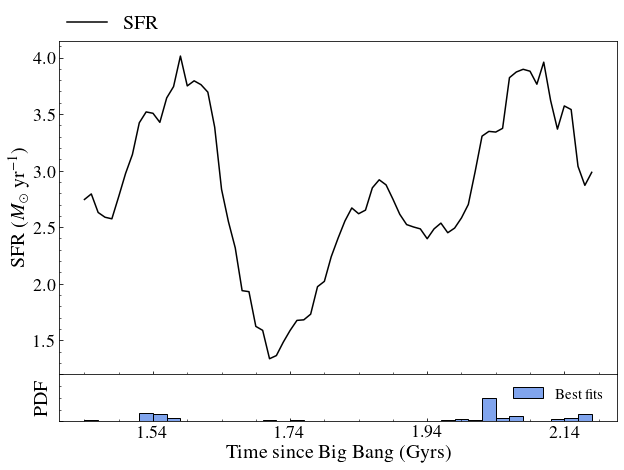

In [328]:
# OUTPUT and DIR
allOutnoFS = outall.flatten()
cb_colors = ["#739721", "#4C6085", "#886E44", "#E99F0C", "#FE6D73"]
fig, ax1 = plt.subplots(1,1, figsize= (10,7))
gs = GridSpec(8, 8)
ax_main = plt.subplot(gs[0:7, :8])
ax_xDist = plt.subplot(gs[7, :8],sharex=ax_main)

hist2 = ax_xDist.hist(allOutnoFS, bins = range(90,165,2), density = True, alpha = 1, label = 'Best fits', color =cFS,
                     edgecolor = 'k')
allval = np.insert(hist2[0],len(hist2[0]),0)
# axs.scatter(range(90,165,1), fesc900M, label = 'Mean Fesc at 900A per output', c= 'k')
# ax_main.bar(range(90,165,2), allval/max(allval), alpha = 0.4,label = 'Hist of TS of best fits - no FS',
#           color = cFS)
ax_main.plot(np.arange(90,165, 1), SFR100, c ='k', label = 'SFR')
ax_xDist.set_xlabel('Time since Big Bang (Gyrs)', fontsize = 20)
ax_main.set_ylabel(r'SFR ($M_\odot$ yr$^{-1}$)', fontsize = 20)
ax_xDist.set_xticks([100,120,140, 160])
ax_xDist.set_xticklabels(['1.54', '1.74', '1.94', '2.14'], size = 18)
ax_xDist.set_ylabel('PDF', fontsize = 20)
ax_xDist.set_yticks([0,0.3])
ax_xDist.set_yticklabels(['',''])
# ax_main.set_yticks([1.5,2,2.5,3,3.5,4], fontsize = 18)
ax_main.tick_params(axis='y', which='major', labelsize=18)

# ax_main.legend(fontsize = 13)

# ax_xDist.axis(False)
ax_xDist.legend(frameon = False, loc = 'upper right')
# plt.setp(ax_xDist.get_xticklabels(), visible=False)
plt.subplots_adjust(wspace=0, hspace=0)
# ax_main.set_ylim(0.4, 4.2)

dd = ax_main.get_yticks()


ax_main.legend(frameon = False, fontsize = 20, ncol = 3, loc= (0,1))




# plt.savefig('Plots/SFR_histogram_depall.pdf', bbox_inches = 'tight')

### Escape fractions

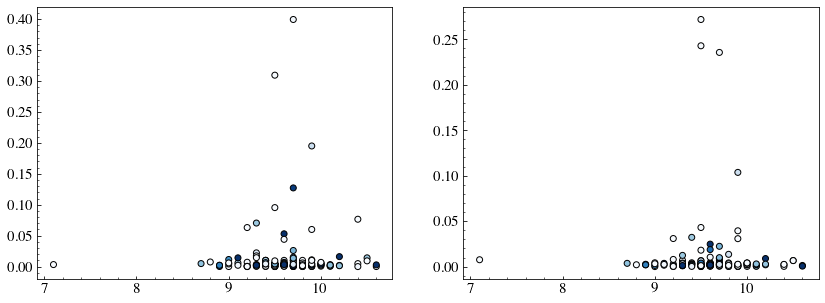

In [349]:
fig, (ax0, ax1) = plt.subplots(1,2,figsize =(14,5) )
ax0.scatter(info[info['snr_per_pix']>5]['lmass'], fesc900[outall[:,0].astype(int)-90,dirall[:,0].astype(int)], 
            c = Chi2all[:,0], vmin = 1, vmax = 3, cmap = 'Blues', edgecolor = 'k')

fesc_med = []
for i in range(len(outall[:,0])):
    fesc_med.append(np.median(fesc900[outall[i, :10].astype(int)-90, dirall[i, :10].astype(int)]))
    
fesc_mean = []
for i in range(len(outall[:,0])):
    fesc_mean.append(np.mean(fesc900[outall[i, :10].astype(int)-90, dirall[i, :10].astype(int)]))
#     print(np.median(Mstar[outall[i, 10*i:10*(i+1)].astype(int)-90]))
ax1.scatter(info[info['snr_per_pix']>5]['lmass'], fesc_med, 
            c = Chi2all[:,0], vmin = 1, vmax = 3, cmap = 'Blues', edgecolor = 'k')

0.011096314393129773 0.0025485 0.03836347329936639
0.015475691983282445 0.0035973 0.049052608470589475
0.013908072918731177 0.00375814979737 0.034773679642192676


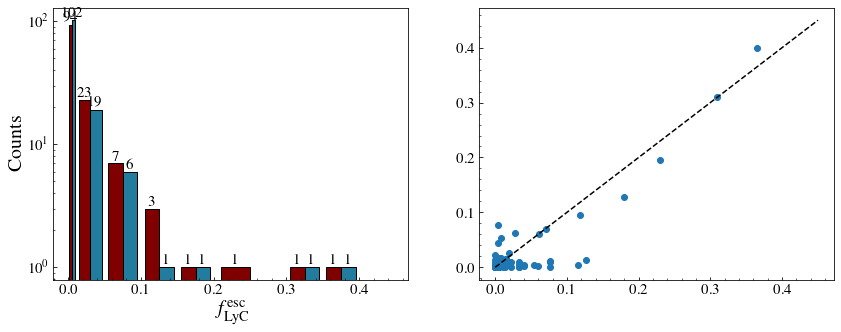

In [693]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize = (14,5))
counts, edges, bars =ax1.hist([fesc900[dfno['OutputAll0'].astype(int).values-90,dfno['DirAll0'].astype(int)],
                               fesc900[dfyes['OutputAll0'].astype(int).values-90,dfyes['DirAll0'].astype(int)]],
                               bins = [0.00,0.01,0.05,0.1,0.15,0.2,0.3,0.35,0.4,0.45],align='mid', 
                              alpha = 1, label = 'VANDELS', 
                              edgecolor = 'k', color =['#800000','#227C9D'], log=True )
ax1.set_xlabel(r'$f_{\rm LyC}^{\rm esc}$', fontsize = 20)
ax1.set_ylabel(r'Counts', fontsize = 20)
ax1.bar_label(bars[0])
ax1.bar_label(bars[1])

ax2.scatter(fesc900[dfno['OutputAll0'].astype(int).values-90,dfno['DirAll0'].astype(int)],
                               fesc900[dfyes['OutputAll0'].astype(int).values-90,dfyes['DirAll0'].astype(int)])
ax2.plot(np.linspace(0,0.45),np.linspace(0,0.45),'--k')
# ax1.set_ylim(0,65)
# ax1.set_yscale('log')
# ax1.set_xscale('log')
# ax
print(np.mean(fesc_med),np.median(fesc_med), np.std(fesc_med))
fesc_one = fesc900[outall[:,0].astype(int)-90,dirall[:,0].astype(int)]
print(np.mean(fesc_one),np.median(fesc_one), np.std(fesc_one))
# plt.hist( fesc900[outall[:,0].astype(int)-90,dirall[:,0].astype(int)])

print(np.mean(fesc_mean),np.median(fesc_mean), np.std(fesc_mean))


In [716]:
dfyes   = pd.read_csv('Vandels_10best_offset.csv')
dfno   = pd.read_csv('Vandels_10best_nooffset.csv')
tuple_outyes = np.zeros((nGal, 10))
tuple_outno = np.zeros((nGal, 10))
tuple_diryes = np.zeros((nGal, 10))
tuple_dirno = np.zeros((nGal, 10))

for i in range(nmocks):
    tuple_outyes[:,i] = dfyes[f'OutputAll{i}'].values
    tuple_outno[:,i] = dfno[f'OutputAll{i}'].values
    tuple_diryes[:,i] = dfyes[f'DirAll{i}'].values
    tuple_dirno[:,i] = dfno[f'DirAll{i}'].values

fesc_mean_y, fesc_med_y, fesc_std_y = np.zeros(nGal), np.zeros(nGal), np.zeros(nGal)
fesc_mean_n, fesc_med_n, fesc_std_n = np.zeros(nGal), np.zeros(nGal), np.zeros(nGal)
ntotake = 3
for i in range(nGal):
    fesc_mean_y[i]=np.mean(fesc900[tuple_outyes[i, :ntotake].astype(int)-90, tuple_diryes[i, :ntotake].astype(int)])
    fesc_med_y[i]=np.median(fesc900[tuple_outyes[i, :ntotake].astype(int)-90, tuple_diryes[i, :ntotake].astype(int)])
    fesc_std_y[i]=np.std(fesc900[tuple_outyes[i, :ntotake].astype(int)-90, tuple_diryes[i, :ntotake].astype(int)])
    
    fesc_mean_n[i]=np.mean(fesc900[tuple_outno[i, :ntotake].astype(int)-90, tuple_dirno[i, :ntotake].astype(int)])
    fesc_med_n[i]=np.median(fesc900[tuple_outno[i, :ntotake].astype(int)-90, tuple_dirno[i, :ntotake].astype(int)])
    fesc_std_n[i]=np.std(fesc900[tuple_outno[i, :ntotake].astype(int)-90, tuple_dirno[i, :ntotake].astype(int)])

0.014238415359901044 0.04104833500352283
0.01820205846647252 0.03807416428189048


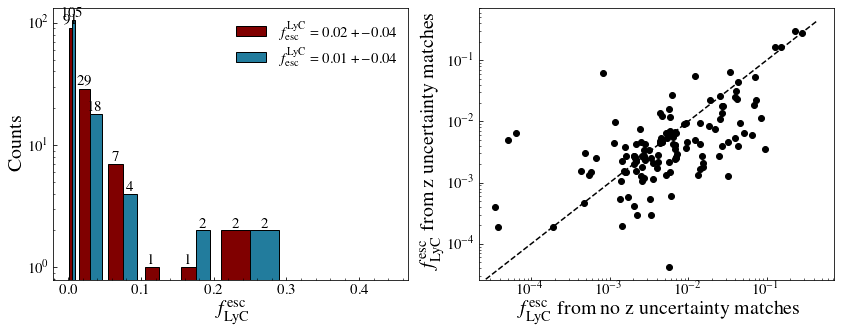

In [834]:
fig, (ax1, ax2) = plt.subplots(1,2, figsize = (14,5))
counts, edges, bars =ax1.hist([fesc_mean_n,
                               fesc_mean_y],
                               bins = [0.00,0.01,0.05,0.1,0.15,0.2,0.3,0.35,0.4,0.45],align='mid', 
                              alpha = 1, label = [r'$f_{\rm esc}^{\rm LyC} = %.2f +- %.2f$'%(np.mean(fesc_mean_n), np.std(fesc_mean_n)),
                                                  r'$f_{\rm esc}^{\rm LyC} = %.2f +- %.2f$'%(np.mean(fesc_mean_y), np.std(fesc_mean_y)),
                                                 ], 
                              edgecolor = 'k', color =['#800000','#227C9D'], log=True )
ax1.set_xlabel(r'$f_{\rm LyC}^{\rm esc}$', fontsize = 20)
ax1.set_ylabel(r'Counts', fontsize = 20)
ax1.bar_label(bars[0])
ax1.bar_label(bars[1])
ax1.legend(frameon=False)

ax2.errorbar(fesc_mean_n,fesc_mean_y, ls = 'None', marker = 'o', color = 'k')
ax2.plot(np.linspace(0,0.45),np.linspace(0,0.45),'--k')
# ax2.set_yscale = 
# ax1.set_ylim(0,65)
ax2.set_yscale('log')
ax2.set_xscale('log')
ax2.set_xlabel(r'$f_{\rm LyC}^{\rm esc}$ from no z uncertainty matches', fontsize = 20)
ax2.set_ylabel(r'$f_{\rm LyC}^{\rm esc}$ from z uncertainty matches', fontsize = 20)
print(np.mean(fesc_mean_y), np.std(fesc_mean_y))
print(np.mean(fesc_mean_n), np.std(fesc_mean_n))
plt.savefig('Plots/Escape_fractions.pdf', bbox_inches = 'tight')



#### Stacks from escape fraction bins

In [786]:
dfyes   = pd.read_csv('Vandels_10best_offset.csv')
dfno   = pd.read_csv('Vandels_10best_nooffset.csv')

v_cm = np.genfromtxt(path_to_folder+'./dat_files/vcm_90_164.dat',unpack=True)
true_i= 0
stack_01 = []
# stack_05 =[]
stack_10 =[]
stack_high =[]
for i in range(len(info)):    
    
    if(info['snr_per_pix'][i]<5 or true_i >=131):
        continue
#     print({info["spectrum"][i]})
    dat1 = pd.read_csv(f'vandels_sample/vandels_spectra/{info["spectrum"][i]}.dat',delim_whitespace=True,
                       comment="#", 
                       names = ['wl', 'flam', 'flam_err'])
    redshift = info["z"][i]
    wave = dat1['wl']/(1+redshift)
    err  =  dat1['flam_err']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux = dat1['flam']/np.median(dat1['flam'][(wave>1310) & (wave<1320)])
    flux[flux<0]=1e-3
    
    interwave = np.linspace(1200, 1700, 1000)
    interpflux = np.interp(interwave, wave, flux)
    interpflux[interpflux==0] = np.nan
    # without Off set
    bestDir         = dfyes['DirAll0'][true_i]
    bestOut        = dfyes['OutputAll0'][true_i]
    bestChi2FS      = dfyes['x2All0'][true_i]
    if(fesc900[int(bestOut)-90, int(bestDir)]<0.01):
        stack_01.append(interpflux)
#     elif(fesc900[int(bestOut)-90, int(bestDir)]<0.05):
#         stack_05.append(interpflux)
    elif(fesc900[int(bestOut)-90, int(bestDir)]<0.10):
        stack_10.append(interpflux)
    else:
        stack_high.append(interpflux)
    true_i +=1
#     if(true_i>2):
#         break


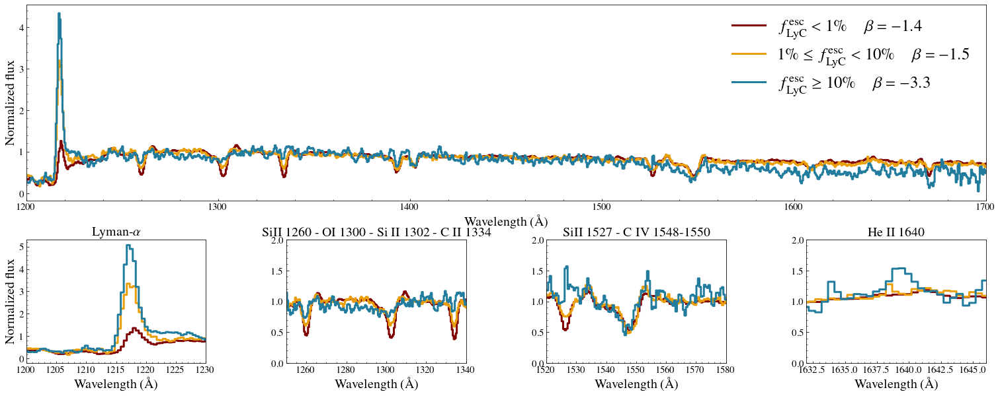

In [833]:
#"#227C9D", "#17C3B2", "#FFC05C", "#E99F0C", "#FE6D73", "#800000"
mdstack1 = np.asarray(np.nanmedian(np.asarray(stack_01), axis=0))
mdstack10 =  np.asarray(np.nanmedian(np.asarray(stack_10), axis=0))
mdstackhigh =  np.asarray(np.nanmedian(np.asarray(stack_high), axis=0))


fig = plt.figure(figsize=(26,10))
gs = GridSpec(20, 26)
ax_main = plt.subplot(gs[:11, :])

ax_main.plot(interwave, np.nanmedian(np.asarray(stack_01), axis=0), c= '#800000',lw = 3,
            label = r'$f_{\rm LyC}^{\rm esc} < 1\% \quad \beta = -1.4$', drawstyle = 'steps-mid')
# plt.plot(interwave, np.nanmedian(np.asarray(stack_05), axis=0))
ax_main.plot(interwave, np.nanmedian(np.asarray(stack_10), axis=0), c ='#E99F0C',lw = 3,
                        label = r'$1\% \leq f_{\rm LyC}^{\rm esc} < 10\% \quad \beta = -1.5$', drawstyle = 'steps-mid')

ax_main.plot(interwave, np.nanmedian(np.asarray(stack_high), axis=0), c = "#227C9D",lw = 3,
                        label = r'$f_{\rm LyC}^{\rm esc} \geq 10\% \quad \beta = -3.3$', drawstyle = 'steps-mid')
ax_main.legend(frameon = False, fontsize = 25)
ax_main.set_xlabel(r'Wavelength ($\rm \AA$)', fontsize = 20)
ax_main.set_ylabel(r'Normalized flux', fontsize = 20)
ax_main.set_xlim(1200, 1700)


ax_main2 = plt.subplot(gs[13:28, :5])
ax_main2.plot(interwave, mdstack1/np.median(mdstack1[(interwave>1250) & (interwave<1260)]), c= '#800000',lw = 3,
             drawstyle = 'steps-mid')
# plt.plot(interwave, np.nanmedian(np.asarray(stack_05), axis=0))
ax_main2.plot(interwave, mdstack10/np.median(mdstack10[(interwave>1250) & (interwave<1260)]), c ='#E99F0C',lw = 3,
                         drawstyle = 'steps-mid')

ax_main2.plot(interwave, mdstackhigh/np.median(mdstackhigh[(interwave>1250) & (interwave<1260)]), c = "#227C9D",lw = 3,
                         drawstyle = 'steps-mid')
ax_main2.set_xlim(1200, 1230)
ax_main2.set_xlabel(r'Wavelength ($\rm \AA$)', fontsize = 20)
ax_main2.set_ylabel(r'Normalized flux', fontsize = 20)
ax_main2.set_title(r'Lyman-$\alpha$', fontsize = 20)



ax_main2 = plt.subplot(gs[13:28, 7:12])
ax_main2.plot(interwave, mdstack1/np.median(mdstack1[(interwave>1310) & (interwave<1320)]), c= '#800000',lw = 3,
             drawstyle = 'steps-mid')
# plt.plot(interwave, np.nanmedian(np.asarray(stack_05), axis=0))
ax_main2.plot(interwave, mdstack10/np.median(mdstack10[(interwave>1310) & (interwave<1320)]), c ='#E99F0C',lw = 3,
                         drawstyle = 'steps-mid')

ax_main2.plot(interwave, mdstackhigh/np.median(mdstackhigh[(interwave>1310) & (interwave<1320)]), c = "#227C9D",lw = 3,
                         drawstyle = 'steps-mid')
ax_main2.set_xlim(1250, 1340)
ax_main2.set_ylim(0,2)
ax_main2.set_xlabel(r'Wavelength ($\rm \AA$)', fontsize = 20)
ax_main2.set_title(r'SiII 1260 - OI 1300 - Si II 1302 - C II 1334', fontsize = 20)


ax_main2 = plt.subplot(gs[13:28, 14:19])
ax_main2.plot(interwave, mdstack1/np.median(mdstack1[(interwave>1560) & (interwave<1600)]), c= '#800000',lw = 3,
             drawstyle = 'steps-mid')
# plt.plot(interwave, np.nanmedian(np.asarray(stack_05), axis=0))
ax_main2.plot(interwave, mdstack10/np.median(mdstack10[(interwave>1560) & (interwave<1600)]), c ='#E99F0C',lw = 3,
                         drawstyle = 'steps-mid')

ax_main2.plot(interwave, mdstackhigh/np.median(mdstackhigh[(interwave>1560) & (interwave<1600)]), c = "#227C9D",lw = 3,
                         drawstyle = 'steps-mid')
ax_main2.set_xlim(1520, 1580)
ax_main2.set_ylim(0,2)
ax_main2.set_xlabel(r'Wavelength ($\rm \AA$)', fontsize = 20)
ax_main2.set_title(r'SiII 1527 - C IV 1548-1550', fontsize = 20)

ax_main2 = plt.subplot(gs[13:28, 21:26])
ax_main2.plot(interwave, mdstack1/np.median(mdstack1[(interwave>1610) & (interwave<1635)]), c= '#800000',lw = 3,
             drawstyle = 'steps-mid')
# plt.plot(interwave, np.nanmedian(np.asarray(stack_05), axis=0))
ax_main2.plot(interwave, mdstack10/np.median(mdstack10[(interwave>1610) & (interwave<1635)]), c ='#E99F0C',lw = 3,
                         drawstyle = 'steps-mid')

ax_main2.plot(interwave, mdstackhigh/np.median(mdstackhigh[(interwave>1610) & (interwave<1635)]), c = "#227C9D",lw = 3,
                         drawstyle = 'steps-mid')
ax_main2.set_xlim(1632, 1646)
ax_main2.set_ylim(0,2)
ax_main2.set_xlabel(r'Wavelength ($\rm \AA$)', fontsize = 20)
ax_main2.set_title(r'He II 1640', fontsize = 20)
plt.savefig('Plots/Stacks.pdf', bbox_inches = 'tight')


In [777]:
from scipy.optimize import curve_fit
from lmfit import Parameters,minimize, fit_report


def model_lmfit(params,x,y):
    beta  =params['beta']    
    model = x*beta+params['K']
   # model /= np.median(model[(x>1269) & (x<1271)])
    return 0.5*(((y-model)**2))#*inv_sigma2

# Defining the various parameters
params = Parameters()
params.add("beta", value = -1, min =-5.0, max = 5.)
params.add("K", value = 1e3)

# Calling the minimize function. Args contains the x and y data. lssquare, powell, bashinhopping
fitted_params = minimize(model_lmfit, params, args= (np.log(interwave[mask]),
                                                     np.log(np.nanmedian(np.asarray(stack_01), axis=0)[mask])))
fitted_params.params.pretty_print()

fitted_params = minimize(model_lmfit, params, args= (np.log(interwave[mask]),
                                                     np.log(np.nanmedian(np.asarray(stack_10), axis=0)[mask])))
fitted_params.params.pretty_print()

fitted_params = minimize(model_lmfit, params, args= (np.log(interwave[mask]),
                                                     np.log(np.nanmedian(np.asarray(stack_high), axis=0)[mask])))
fitted_params.params.pretty_print()

# target_func = func_powerlaw
# mask = (interwave>1310) & (interwave<1330) | (interwave>1350) & (interwave<1380) | \
# (interwave>1420) & (interwave<1510) | (interwave>1560) & (interwave<1600)
# popt1, pcov = curve_fit(target_func,,
#                       p0 = (-2, 1e5),maxfev=20000)

# # popt2, pcov = curve_fit(target_func, interwave[mask], np.log(np.nanmedian(np.asarray(stack_05), axis=0)[mask]),
# #                       p0 = (-2, 1e5),maxfev=20000)

# popt3, pcov = curve_fit(target_func, interwave[mask], np.log(np.nanmedian(np.asarray(stack_10), axis=0)[mask]),
#                       p0 = (-2, 1e5),maxfev=20000)

# popt4, pcov = curve_fit(target_func, interwave[mask], np.log(np.nanmedian(np.asarray(stack_high), axis=0)[mask]),
#                       p0 = (-2, 1e5),maxfev=20000)

# print(popt1,popt2,popt3,popt4)

Name     Value      Min      Max   Stderr     Vary     Expr Brute_Step
K        10.11     -inf      inf   0.1388     True     None     None
beta    -1.407       -5        5  0.01907     True     None     None
Name     Value      Min      Max   Stderr     Vary     Expr Brute_Step
K        10.63     -inf      inf   0.1855     True     None     None
beta    -1.483       -5        5  0.02545     True     None     None
Name     Value      Min      Max   Stderr     Vary     Expr Brute_Step
K        23.44     -inf      inf   0.5833     True     None     None
beta    -3.254       -5        5  0.07989     True     None     None


### Offsets


(array([ 3.,  4., 12., 20., 14., 38., 23.,  9.,  6.,  2.]),
 array([-49. , -40.2, -31.4, -22.6, -13.8,  -5. ,   3.8,  12.6,  21.4,
         30.2,  39. ]),
 <BarContainer object of 10 artists>)

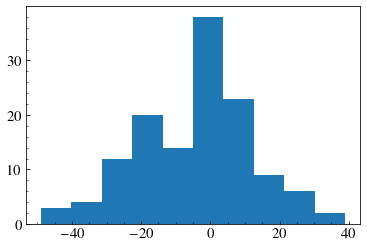

In [337]:
plt.hist(offall[:,0])